Program to carry out unsupervised clustering on a matrix of 23 variability indices.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd
import os, sklearn, kneed
from sklearn.cluster import KMeans, DBSCAN, Birch
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator
from collections import Counter

In [2]:
#set cwd
parent_dir = '/Users/oscarscholin/Desktop/Pomona/Summer22/Quetin/processed data/variability indices/'
tsne_folder = 't-sne plots'
tsne_dir = os.path.join(parent_dir, tsne_folder)

### Load King Kong

In [3]:
os.chdir(parent_dir)

In [4]:
#read in dataset
king_kong = pd.read_csv('king_kong_mega.csv')
#remove first index
king_kong = king_kong.iloc[:,1:]
king_kong

,matchid,filter,mad,chi2red,weighted stdev,clipped stdev,iqr,roms,norm excess var,peak to peak var,...,I,Ifi,Iclipped,J,K,L,Jtime,Ltime,Jclipped,Lclipped
0,352.0,ACS_F606W,0.118000,2.291321,0.174979,0.128560,0.330575,1.292976,0.000047,0.008823,...,-2.391036,0.409091,0.0,14.086345,0.817772,14.437453,14.575933,14.939244,21.334591,21.866364
1,352.0,ACS_F814W,0.327699,40.643958,0.303004,0.258211,0.582800,6.762626,0.000203,0.020910,...,-2.391036,0.409091,0.0,14.086345,0.817772,14.437453,14.575933,14.939244,21.334591,21.866364
2,857.0,WFC3_F606W,0.036149,45.247635,0.082396,0.031384,0.069126,4.700127,0.000012,0.007959,...,18.065059,0.833333,0.0,3.120523,0.712588,2.786929,3.224098,2.879431,49.911355,44.575664
3,857.0,WFC3_F814W,0.033401,18.824359,0.048016,0.026966,0.054724,3.505349,0.000005,0.004180,...,18.065059,0.833333,0.0,3.120523,0.712588,2.786929,3.224098,2.879431,49.911355,44.575664
4,875.0,ACS_F435W,0.038400,7.116879,0.051365,0.032218,0.071100,2.339009,0.000004,0.003341,...,18.374893,0.722222,0.0,44.435443,0.681763,37.968456,68.945457,58.911364,57.484732,49.118595
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179866,108168989.0,ACS_F606W,0.084900,1024.685702,0.097018,0.072621,0.140200,29.304967,0.000026,0.007375,...,132.078348,0.500000,0.0,74.549859,0.760744,71.079693,139.120399,132.644587,103.768582,98.938335
179867,108168989.0,ACS_F658N,0.025400,22.502191,0.058026,0.028015,0.055800,3.995249,0.000007,0.002952,...,142.935457,0.700000,0.0,74.549859,0.760744,71.079693,139.120399,132.644587,103.768582,98.938335
179868,108168989.0,ACS_F814W,0.074049,1388.090054,0.114345,0.098322,0.180150,36.643929,0.000040,0.008087,...,-119.786533,0.500000,0.0,74.549859,0.760744,71.079693,139.120399,132.644587,103.768582,98.938335
179869,108169792.0,WFC3_F606W,0.058799,106.281545,0.064248,0.043672,0.083899,9.316022,0.000008,0.004061,...,0.000000,0.500000,0.0,84.554122,0.795048,84.253522,88.072822,87.759713,84.554122,84.253522


In [5]:
#load in scaled kk
king_kong_scaled = pd.read_csv('king_kong_scaled.csv')
#remove old index column
king_kong_scaled = king_kong_scaled.iloc[:,1:]
king_kong_scaled

,mad,chi2red,weighted stdev,clipped stdev,iqr,roms,norm excess var,peak to peak var,lag1 auto,cssd,...,I,Ifi,Iclipped,J,K,L,Jtime,Ltime,Jclipped,Lclipped
0,0.002789,0.054155,0.004136,0.003038,0.007813,0.030559,1.104846e-06,0.000209,-0.000411,0.0,...,-0.056511,0.009669,0.0,0.332927,0.019328,0.341225,0.344498,0.353085,0.504237,0.516805
1,0.004768,0.591363,0.004409,0.003757,0.008480,0.098395,2.955801e-06,0.000304,0.010145,0.0,...,-0.034789,0.005952,0.0,0.204954,0.011898,0.210063,0.212077,0.217364,0.310415,0.318152
2,0.000434,0.543851,0.000990,0.000377,0.000831,0.056493,1.499805e-07,0.000096,-0.001833,0.0,...,0.217132,0.010016,0.0,0.037507,0.008565,0.033497,0.038752,0.034609,0.599906,0.535774
3,0.000462,0.260480,0.000664,0.000373,0.000757,0.048505,6.556408e-08,0.000058,0.001354,0.0,...,0.249973,0.011531,0.0,0.043180,0.009860,0.038564,0.044613,0.039844,0.690643,0.616811
4,0.000288,0.053396,0.000385,0.000242,0.000533,0.017549,2.961326e-08,0.000025,0.000130,0.0,...,0.137861,0.005419,0.0,0.333385,0.005115,0.284865,0.517276,0.441993,0.431289,0.368521
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179866,0.000058,0.703607,0.000067,0.000050,0.000096,0.020122,1.766259e-08,0.000005,0.000037,0.0,...,0.090692,0.000343,0.0,0.051190,0.000522,0.048807,0.095528,0.091081,0.071253,0.067937
179867,0.000085,0.075398,0.000194,0.000094,0.000187,0.013387,2.224911e-08,0.000010,-0.001712,0.0,...,0.478932,0.002345,0.0,0.249793,0.002549,0.238166,0.466149,0.444451,0.347696,0.331512
179868,0.000052,0.978936,0.000081,0.000069,0.000127,0.025843,2.794872e-08,0.000006,-0.000341,0.0,...,-0.084478,0.000353,0.0,0.052576,0.000537,0.050128,0.098113,0.093546,0.073182,0.069775
179869,0.000233,0.420796,0.000254,0.000173,0.000332,0.036885,3.278378e-08,0.000016,0.001135,0.0,...,0.000000,0.001980,0.0,0.334772,0.003148,0.333582,0.348703,0.347464,0.334772,0.333582


### Now limited king kong

In [44]:
limited_kk = pd.read_csv('limited_kk.csv')
limited_kk = limited_kk.iloc[:, 1:]
limited_kk

,mad,chi2red,weighted stdev,iqr,roms,norm excess var,peak to peak var,Ex,eta ratio,SB,I,Ifi,J,K,Jtime
0,0.118000,2.291321,0.174979,0.330575,1.292976,0.000047,0.008823,0.401459,0.511833,0.562090,-2.391036,0.409091,14.086345,0.817772,14.575933
1,0.327699,40.643958,0.303004,0.582800,6.762626,0.000203,0.020910,0.945021,1.805890,35.191557,-2.391036,0.409091,14.086345,0.817772,14.575933
2,0.036149,45.247635,0.082396,0.069126,4.700127,0.000012,0.007959,0.150255,0.455589,3.230000,18.065059,0.833333,3.120523,0.712588,3.224098
3,0.033401,18.824359,0.048016,0.054724,3.505349,0.000005,0.004180,0.335032,0.566180,3.700978,18.065059,0.833333,3.120523,0.712588,3.224098
4,0.038400,7.116879,0.051365,0.071100,2.339009,0.000004,0.003341,1.966091,0.529982,2.986356,18.374893,0.722222,44.435443,0.681763,68.945457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179866,0.084900,1024.685702,0.097018,0.140200,29.304967,0.000026,0.007375,0.067790,0.535319,992.221666,132.078348,0.500000,74.549859,0.760744,139.120399
179867,0.025400,22.502191,0.058026,0.055800,3.995249,0.000007,0.002952,0.000000,0.346224,0.000000,142.935457,0.700000,74.549859,0.760744,139.120399
179868,0.074049,1388.090054,0.114345,0.180150,36.643929,0.000040,0.008087,0.543545,0.343760,0.000000,-119.786533,0.500000,74.549859,0.760744,139.120399
179869,0.058799,106.281545,0.064248,0.083899,9.316022,0.000008,0.004061,4.468034,1.150678,91.833066,0.000000,0.500000,84.554122,0.795048,88.072822


In [46]:
limited_kk_scaled = pd.read_csv('limited_kk_scaled.csv')
limited_kk_scaled = limited_kk_scaled.iloc[:, 1:]
limited_kk_scaled

,mad,chi2red,weighted stdev,iqr,roms,norm excess var,peak to peak var,Ex,eta ratio,SB,I,Ifi,J,K,Jtime
0,0.005722,0.111113,0.008485,0.016031,0.062700,2.266882e-06,0.000428,0.019468,0.024820,0.027257,-0.115948,0.019838,0.683086,0.039656,0.706828
1,0.005655,0.701359,0.005229,0.010057,0.116697,3.505590e-06,0.000361,0.016307,0.031163,0.607271,-0.041260,0.007059,0.243076,0.014112,0.251525
2,0.000734,0.918311,0.001672,0.001403,0.095390,2.532473e-07,0.000162,0.003049,0.009246,0.065554,0.366634,0.016913,0.063332,0.014462,0.065434
3,0.001238,0.697456,0.001779,0.002028,0.129876,1.755532e-07,0.000155,0.012413,0.020977,0.137124,0.669324,0.030876,0.115618,0.026402,0.119455
4,0.000455,0.084250,0.000608,0.000842,0.027689,4.672491e-08,0.000040,0.023275,0.006274,0.035353,0.217522,0.008550,0.526027,0.008071,0.816177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179866,0.000059,0.710885,0.000067,0.000097,0.020331,1.784528e-08,0.000005,0.000047,0.000371,0.688362,0.091631,0.000347,0.051720,0.000528,0.096516
179867,0.000119,0.105070,0.000271,0.000261,0.018655,3.100503e-08,0.000014,0.000000,0.001617,0.000000,0.667411,0.003269,0.348097,0.003552,0.649598
179868,0.000053,0.989627,0.000082,0.000128,0.026125,2.825393e-08,0.000006,0.000388,0.000245,0.000000,-0.085401,0.000356,0.053150,0.000542,0.099185
179869,0.000315,0.570186,0.000345,0.000450,0.049979,4.442253e-08,0.000022,0.023970,0.006173,0.492672,0.000000,0.002682,0.453621,0.004265,0.472498


### Chi2 and MAD only

In [30]:
#wanted columns: chi2 and mad only
chi2_mad = ['chi2red', 'mad']

#initialize empty df
chi2_mad_df = pd.DataFrame()

#populate df
for column in chi2_mad:
    chi2_mad_df[column] = king_kong_scaled[column]
    
#display results
chi2_mad_df

,chi2red,mad
0,0.054155,0.002789
1,0.591363,0.004768
2,0.543851,0.000434
3,0.260480,0.000462
4,0.053396,0.000288
...,...,...
179866,0.703607,0.000058
179867,0.075398,0.000085
179868,0.978936,0.000052
179869,0.420796,0.000233


In [31]:
chi2_mad_df.to_csv('chi2_mad.csv')

### Load HCV df

In [7]:
os.chdir('/Users/oscarscholin/Desktop/Pomona/Summer22/Quetin/raw data/hcv')

df = pd.read_csv(r'HCV_7_1.csv')
df

,matchid,groupid,subgroup,ra,dec,pipeline_class,expert_class,filter,num_filters,var_quality_flag,...,lightcurve_d,lightcurve_m,lightcurve_cm,lightcurve_e,lightcurve_i,lightcurve_r,ci_d,ci_v,d_d,d_v
0,352,1040910,26,269.790894,-29.248819,1,0,ACS_F606W,2,AAAAC,...,55855.000881,25.631300,25.636757,0.1070,hst_12586_03_acs_wfc_f606w,False,55855.000881,1.093611,55855.000881,6.084347
1,352,1040910,26,269.790894,-29.248819,1,0,ACS_F606W,2,AAAAC,...,56001.959890,26.200701,26.195594,0.1815,hst_12586_10_acs_wfc_f606w,False,56001.959890,0.635000,56001.959890,2.961927
2,352,1040910,26,269.790894,-29.248819,1,0,ACS_F606W,2,AAAAC,...,56052.841962,26.034100,26.046429,0.1469,hst_12586_22_acs_wfc_f606w,False,56052.841962,0.824907,56052.841962,5.407275
3,352,1040910,26,269.790894,-29.248819,1,0,ACS_F606W,2,AAAAC,...,56109.701472,25.735399,25.760180,0.1854,hst_12586_35_acs_wfc_f606w,False,56109.701472,0.933519,56109.701472,4.572665
4,352,1040910,26,269.790894,-29.248819,1,0,ACS_F606W,2,AAAAC,...,56121.406559,25.626101,25.640382,0.0986,hst_12586_39_acs_wfc_f606w,False,56121.406559,1.029815,56121.406559,3.149204
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2576369,108169792,1063416,12,269.609375,-29.169004,2,0,WFC3_F814W,2,AAABC,...,56716.158792,20.118099,20.122682,0.0061,hst_13463_08_wfc3_uvis_f814w,False,56716.158792,1.415333,56716.158792,2.586158
2576370,108169792,1063416,12,269.609375,-29.169004,2,0,WFC3_F814W,2,AAABC,...,56732.954985,20.060400,20.060412,0.0058,hst_13463_12_wfc3_uvis_f814w,False,56732.954985,1.374222,56732.954985,6.504886
2576371,108169792,1063416,12,269.609375,-29.169004,2,0,WFC3_F814W,2,AAABC,...,56764.960344,20.134701,20.137863,0.0063,hst_13463_20_wfc3_uvis_f814w,False,56764.960344,1.420444,56764.960344,4.001287
2576372,108169792,1063416,12,269.609375,-29.169004,2,0,WFC3_F814W,2,AAABC,...,56784.897984,20.104401,20.095573,0.0057,hst_13463_24_wfc3_uvis_f814w,False,56784.897984,1.412222,56784.897984,3.657708


## Define various cluster methods

### Ploting helper function

In [28]:
#take in clustered df alone with name of clustering algorithm
def plot_clusters(df_clustered, ide, name):
    #define plotting params
    fig = plt.figure(figsize = (10,7))
    ax = fig.add_subplot(1,1,1) 
    
    #get labels
    labels = list(df_clustered.columns)
    
    ax.set_xlabel(labels[0], fontsize = 14)
    ax.set_ylabel(labels[1], fontsize = 14)
    ax.set_title(name + ' for ' + ide, fontsize = 16)
    
    unique_clusters = list(set(df_clustered['cluster'].tolist()))

    #now iterate and plot
    for cluster in unique_clusters:
        indicesToKeep = df_clustered['cluster'] == cluster
        ax.scatter(df_clustered.loc[indicesToKeep, labels[0]]
                   , df_clustered.loc[indicesToKeep, labels[1]],
                  alpha=0.2)
    ax.legend(unique_clusters)
    plt.savefig(ide + '_'+ name+'.jpeg')
    plt.show()
    
    #optional -- go through and plot for each cluster-----
    '''
    for cluster in unique_clusters:
        #define plotting params
        fig = plt.figure(figsize = (10,7))
        ax = fig.add_subplot(1,1,1) 
        ax.set_xlabel('t-SNE-1', fontsize = 14)
        ax.set_ylabel('t-SNE-2', fontsize = 14)
        ax.set_title('clustered King Kong', fontsize = 16)

        indicesToKeep = df_clustered['cluster'] == cluster
        ax.scatter(df_clustered.loc[indicesToKeep, 't-SNE-1']
                   , df_clustered.loc[indicesToKeep, 't-SNE-2'],
                  label = cluster, alpha=0.2)
        ax.legend()
        plt.savefig('kk_kmeans' + '_'+str(cluster)+'.jpeg')
        plt.show()
    '''  

### Plot lightcurve for matchid/filter combo

In [9]:
def plot_filter_lightcurve(matchid, filter_type): 
    #create dataframe for given matchid
    filter_matchid_df = df.loc[(df['matchid']==matchid) & (df['filter']==filter_type)].reset_index()
  
    #stores list of list of tuples for each filter type, including magnitude and time
    time_mag_magerr_list =[]

    #now iterate through this dataframe and save the time, mag tuple to the time_mag_list
    for i in range(len(filter_matchid_df)):
        time_mag_magerr_list.append((filter_matchid_df['lightcurve_d'].values[i], 
                              filter_matchid_df['lightcurve_m'].values[i],
                              filter_matchid_df['lightcurve_e'].values[i]))

    #now plot!
        for time_mag_magerr in time_mag_magerr_list:
            plt.scatter(time_mag_magerr[0],time_mag_magerr[1])
            plt.errorbar(time_mag_magerr[0],time_mag_magerr[1], yerr=time_mag_magerr[2],
                        fmt = 'o', color = 'b')
        plt.xlabel('Time (Julian Days)', fontsize=16)
        plt.ylabel('Magnitude', fontsize=16)
        plt.title('Lightcurve for ' + str(matchid) + ', ' + filter_type, fontsize=20)
        
    plt.gca().invert_yaxis() #invert y axis since magnitude is inverted; i.e. small magnitude is bright
    plt.savefig('lightcurve_'+str(matchid)+'_'+filter_type +'.jpeg')
    plt.show()

### Extract matchid and filter info from each cluster

In [10]:
#set mode to allow read and write permissions for mkdir
mode = 0o777

#takes in clustered df and name of clustering method; outputs separate csvs for each cluster with col1 as matchid col2 as filter
def get_cluster_members(df_clustered, name):
    #first update cwd---
    path = os.path.join(tsne_dir, name)
    path_results = os.path.join(path, 'results')
    os.chdir(path_results)
    
    #find unique clusters
    unique_clusters = list(set(df_clustered['cluster'].to_list()))
    
    #now go through and for each cluster create a df; find the row and get matchid and filter
    for cluster in unique_clusters:
        #get the df corresponding to the cluster
        #reset index to add index column
        cluster_df = df_clustered.loc[df_clustered['cluster']==cluster].reset_index()
        
        #initialize empty df to hold matchid and filter
        kk_mini_data = {
            'matchid': [], 'filter': [],
            'mad': [], 'chi2red': [], 'weighted stdev': [], 'clipped stdev': [], 'iqr': [], 'roms': [], 'norm excess var':[],
            'peak to peak var': [], 'lag1 auto': [], 'cssd': [], 'Ex': [], 'eta ratio': [], 'SB': [],
            'pair1': [], 'pair2': [], 'I': [], 'Ifi': [], 'Iclipped': [], 'J': [], 'K': [], 'L': [], 'Jtime': [],
            'Ltime': [], 'Jclipped': [], 'Lclipped': []
        }
        kk_mini_df = pd.DataFrame(kk_mini_data)
        
        for i in range(len(cluster_df)):
            #get original index from king kong
            index = cluster_df['index'][i]
            
            #get row from king kong and append to mini df
            data_row = king_kong.iloc[index]
            kk_mini_df = kk_mini_df.append(data_row, ignore_index=True)
            
        #reset cwd
        os.chdir(path_results)
        #save the matchid_filter_df before clearing it
        kk_mini_df.to_csv(str(cluster)+'_data.csv')

## Cluster Analysis

In [11]:
#master function to read in list of kk_mini_dfs and plot lightcurves
def implement_cluster_analysis(df_clustered, name):
    #first update cwd---
    path = os.path.join(tsne_dir, name)
    path_results = os.path.join(path, 'results')
    os.chdir(path_results)
    
    #get df_list
    #get_cluster_members(df_clustered, name)
    
    #now iterate through files
    for file in os.listdir(path_results):
        #reset cwd
        os.chdir(path_results)
        
        #we only want csvs
        if file.endswith('csv'):
            #cluster df corresponds to the df containing objects clustered together
            cluster_df = pd.read_csv(file)
            #reset index
            cluster_df = cluster_df.iloc[:, 1:]
            
            #set new directory to store the images
            file_split = file.split('_')
            cluster_num = file_split[0]
            print('cluster: ', cluster_num)
            img_dir = str(cluster_num)
            img_path = os.path.join(path_results, img_dir)
            
            #create new directory for each cluster
            if not(os.path.exists(img_path)):
                os.mkdir(img_path, mode)
            #change to this new directory
            os.chdir(img_path)

            #if fewer than or equal to 15 objects in cluster, plot all of them
            if len(cluster_df) <= 15:
                for i in range(len(cluster_df)):
                    #get matchid and filter
                    matchid = cluster_df['matchid'][i]
                    filter_type = cluster_df['filter'][i]

                    #plot images
                    plot_filter_lightcurve(matchid, filter_type)

            #for medium-sized clusters, plot 15 random images
            elif (len(cluster_df) > 15) and (len(cluster_df) <= 10000):
                #get tuple of unique matchid, filter combos
                #first get list of matchid, filter
                matchid_filter = list(zip(cluster_df['matchid'].tolist(), cluster_df['filter'].tolist()))
                unique_matchid_filters = list(set(matchid_filter))

                for i in range(0, 15):
                    index = int((len(unique_matchid_filters))*np.random.rand())
                    #find where this is in df
                    matchid, filter_type = unique_matchid_filters[index][0], unique_matchid_filters[index][1]

                    #plot images
                    plot_filter_lightcurve(matchid, filter_type)

            #for large datasets, plot 100 images
            else:
                #get tuple of unique matchid, filter combos
                #first get list of matchid, filter
                matchid_filter = list(zip(cluster_df['matchid'].tolist(), cluster_df['filter'].tolist()))
                unique_matchid_filters = list(set(matchid_filter))

                for i in range(0, 100):
                    index = int((len(unique_matchid_filters))*np.random.rand())
                    #find where this is in df
                    matchid, filter_type = unique_matchid_filters[index][0], unique_matchid_filters[index][1]

                    #plot images
                    plot_filter_lightcurve(matchid, filter_type)


### Similarity function

In [41]:
#this function computes the Euclidean distance between objects from the King Kong matrix in its original
#23 dimensional form and then the two dimensional tsne dataframe
#takes in two rows from the clipped king kong matrix; returns Euclidean distance
def get_similarity(obj1, obj2):
    return sum([(obj1[i] - obj2[i]) ** 2 for i in range(len(obj1))]) ** 0.5

### Kmeans

In [13]:
#takes in df to be clustered on as well as ide string to save the csv and images by
#ide stands for identifier string, e.g. 'tsne_1800'
def run_kmeans(df, ide):
    #first update cwd---
    folder = 'KMeans'
    path = os.path.join(tsne_dir, folder)
    os.chdir(path)
    
    #find number of clusters-----
    #calculate the within-cluster-sum-of-squares (WCSS) versus the number of clusters to determine number of clusters
    min_num = 2
    max_num = 50
    #define cluster range
    cluster_range = range(min_num, max_num+1)
    #list to hold kmeans objects
    kmeans_list = []
    #list to hold wcss
    wcss = []
    for i in cluster_range:
        kmeans = KMeans(n_clusters=i, random_state=0)
        kmeans.fit(df)
        kmeans_list.append(kmeans)
        wcss.append(kmeans.inertia_)

    plt.figure(figsize = (10, 7))
    plt.xlabel('number of clusters', fontsize=16)
    plt.ylabel('WCSS', fontsize=16)
    plt.title('WCSS plot for King Kong', fontsize=22)
    plt.plot(range(min_num, max_num+1), wcss)
    plt.savefig('wcss_kk.jpeg')
    plt.show()
    
    #use kneed package to find knee points-------
    #https://github.com/arvkevi/kneed
    kn = KneeLocator(
        cluster_range,
        wcss,
        curve='convex',
        direction='decreasing',
        interp_method='interp1d',
    )
    knee_value = kn.knee
    print('the elbow of the WCSS curve occurs at: '+ str(knee_value))
    
    #find the kmeans cluster that corresponds to this knee
    kmeans_index = list(cluster_range).index(knee_value)
    #try 7 instead of 5
    kmeans = kmeans_list[kmeans_index]

    #fit the KMeans model
    clusters = kmeans.fit_predict(df)
    
    #assign clusters to scaled data
    df_clustered = df.copy()
    df_clustered = df.assign(cluster=clusters)
    #save df
    df_clustered.to_csv(ide + '_kmeans.csv')
    
    #print df
    #print(df_clustered)
    
    #print unique clusters
    unique_clusters = list(set(clusters))
    print('clusters:', unique_clusters)
    
    #plot clusters!!-------
    name = 'kmeans'
    plot_clusters(df_clustered, ide, name)
    
    #return the clustered df
    return df_clustered

### DBSCAN

In [14]:
#DBSCAN requires two parameters: e and min_pts
#min_pts is simply 2*number of features (here, tsne1 and tsne2)
#e is harder to set; defines neighborhoods -- need to use nearest neighbors function
#see https://stackoverflow.com/questions/15050389/estimating-choosing-optimal-hyperparameters-for-dbscan for more info

#takes in df to cluster by and ide parameter to name saved files and plots
def run_DBSCAN(df, ide):
    #first update cwd---
    folder = 'DBSCAN'
    path = os.path.join(tsne_dir, folder)
    os.chdir(path)
    
    #define min_pts as 2*N, where N is the number of dimensions to the data
    min_pts = 2*(len(df.columns))
    
    #n_neighbors in sklearn.neighbors.NearestNeighbors to be equal to 2xN - 1, 
    nbrs = NearestNeighbors(n_neighbors=min_pts-1).fit(df)

    # Find the k-neighbors of a point
    neigh_dist, neigh_ind = nbrs.kneighbors(df)

    # sort the neighbor distances (lengths to points) in ascending order
    # axis = 0 represents sort along first axis i.e. sort along row
    sort_neigh_dist = np.sort(neigh_dist, axis=0)
    
    #now plot the kNN
    #look for the bend in the curve--this will give optimal value of epsilon
    #the elbow is thepoint farthest from a straight line

    k_dist = sort_neigh_dist[:, min_pts-2]
    plt.plot(k_dist)
    plt.ylabel("k-NN distance")
    plt.xlabel("Sorted observations")
    plt.savefig('kNN_kk.jpeg')
    plt.show()
    
    #use kneed package to find knee points-----
    #https://github.com/arvkevi/kneed
    kn = KneeLocator(
    range(0, len(df)),
    k_dist,
    curve='convex',
    direction='increasing',
    interp_method='interp1d',
    )
    knee_value = kn.knee
    print('the elbow of the kNN curve occurs at: ', knee_value, k_dist[knee_value])
    
    #set value of epsilon
    e = k_dist[knee_value]
    
    #cluster!!------
    clusters = DBSCAN(eps=e, min_samples = min_pts).fit(df)
    # get cluster labels
    clusters_list = clusters.labels_
    
    # check unique clusters
    # -1 value represents noisy points could not assigned to any cluster
    unique_clusters = list(set(clusters.labels_))
    print('clusters:', unique_clusters)
    
    #get each cluster size
    Counter(clusters_list)
    
    #assign clusters to scaled data
    df_clustered = df.copy()
    df_clustered['cluster'] = clusters_list
    #print(df)
    
    #print(df_clustered)
    
    #save dbscan results
    df_clustered.to_csv(ide+'_dbscan.csv')
    
    #plot clusters!!-------
    name = 'DBSCAN'
    plot_clusters(df_clustered, ide, name)
    
    return df_clustered

### Gaussian Mixture (GM)

In [17]:
#input df along with number of clusters (determined using the other clustering methods) along with an identifying string
def run_GM(df, ide, num_clusters):
    #first update cwd---
    folder = 'GM'
    path = os.path.join(tsne_dir, folder)
    os.chdir(path)
    
    #create model
    gmm_model = GaussianMixture(n_components=num_clusters)
    gmm_model.fit(df)

    #get labels
    cluster_labels = gmm_model.predict(df)
    print('clusters', list(set(cluster_labels)))
    
    #create new df
    df_clustered = df.copy()
    df_clustered['cluster'] = cluster_labels
    
    #plot clusters!!-------
    name = 'gm'
    ide_n = ide + '_' + str(num_clusters)
    plot_clusters(df_clustered, ide_n, name)
    
    return df_clustered

### BIRCH

In [18]:
#for reference: https://www.geeksforgeeks.org/ml-birch-clustering/
#need to pass through branching factor and treshold
'''
threshold :  threshold is the maximum number of data points a sub-cluster in the leaf node of the CF tree can hold.
branching_factor : This parameter specifies the maximum number of CF sub-clusters in each node (internal node).
n_clusters : The number of clusters to be returned after the entire BIRCH algorithm is complete i.e., number of clusters after the final clustering step. If set to None, the final clustering step is not performed and intermediate clusters are returned.

defaults: branching_factor = 50, threshold = 1.5
'''
def run_BIRCH(df, ide, branching_factor, threshold):
    #print(df)
    model = Birch(branching_factor = branching_factor, n_clusters = None, threshold = threshold)

    #convert to continuous array
    df = np.ascontiguousarray(df)
    
    #fit the data (Training)
    model.fit(df)

    #predict; appends cluster assignments
    cluster_labels = model.predict(df)
    
    #convert back to pandas df
    #print(df)
    df = pd.DataFrame(df, columns = ['t-SNE-1','t-SNE-2'])
    
    #create new df
    df_clustered = df.copy()
    df_clustered['cluster'] = cluster_labels
    
    #plot clusters!!-------
    name = 'birch'
    ide_n = name + '_' + str(branching_factor) + '_' + str(threshold)
    plot_clusters(df_clustered, ide_n, name)
    
    return df

## Load and plot raw t-SNE dfs

In [19]:
#set cwd
os.chdir(tsne_dir)

In [17]:
#load in dfs
tsne_30_df = pd.read_csv('tsne_30_2.csv')
tsne_30_df = tsne_30_df.iloc[:,1:]
tsne_50_df = pd.read_csv('tsne_50_2.csv')
tsne_50_df = tsne_50_df.iloc[:, 1:]
tsne_100_df = pd.read_csv('tsne_100_2.csv')
tsne_100_df = tsne_100_df.iloc[:, 1:]

tsne_150_df = pd.read_csv('tsne_150_2.csv')
tsne_150_df = tsne_150_df.iloc[:, 1:]
tsne_200_df = pd.read_csv('tsne_200_2.csv')
tsne_200_df = tsne_200_df.iloc[:, 1:]
tsne_300_df = pd.read_csv('tsne_300_2.csv')
tsne_300_df = tsne_300_df.iloc[:, 1:]

tsne_500_df = pd.read_csv('tsne_500_2.csv')
tsne_500_df = tsne_500_df.iloc[:, 1:]
tsne_1000_df = pd.read_csv('tsne_1000_2.csv')
tsne_1000_df = tsne_1000_df.iloc[:, 1:]

tsne_1798_df = pd.read_csv('tsne_1798_2.csv')
tsne_1798_df = tsne_1798_df.iloc[:, 1:]

tsne_1800_df = pd.read_csv('tsne_1800_2.csv')
tsne_1800_df = tsne_1800_df.iloc[:, 1:]

tsne_1800_v2_df = pd.read_csv('tsne_1800_v2_2.csv')
tsne_1800_v2_df = tsne_1800_v2_df.iloc[:, 1:]

In [18]:
tsne_1800_v2_df 

,t-SNE-1,t-SNE-2
0,1.418606e-06,6.631707e-07
1,-6.933391e-07,2.534040e-07
2,6.804291e-07,-2.259025e-07
3,5.038889e-08,-4.581995e-07
4,1.417066e-06,2.104414e-07
...,...,...
179866,-2.417500e-06,-1.697494e-06
179867,-1.684048e-07,-2.372589e-07
179868,-2.179867e-06,9.262583e-07
179869,2.821215e-07,-1.208402e-07


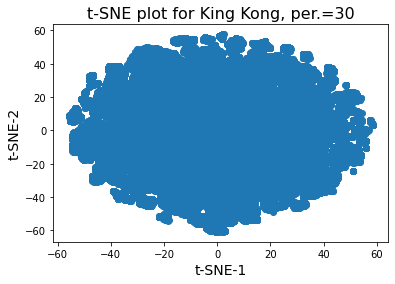

In [7]:
#perplexity 30
x_list = tsne_30_df['t-SNE-1'].tolist()
y_list = tsne_30_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=30', fontsize=16)
plt.savefig('tsne_30.jpeg')
plt.show()

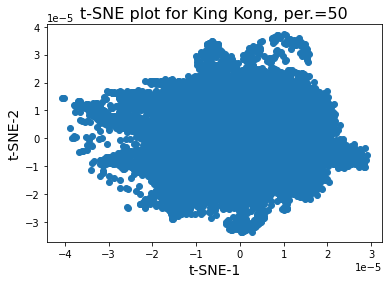

In [8]:
#perplexity 50
x_list = tsne_50_df['t-SNE-1'].tolist()
y_list = tsne_50_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=50', fontsize=16)
plt.savefig('tsne_50.jpeg')
plt.show()

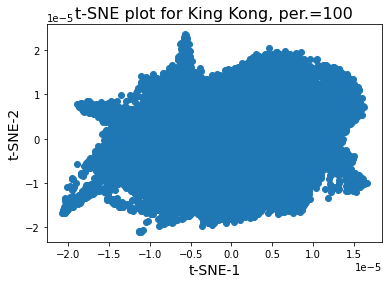

In [9]:
#perplexity 100
x_list = tsne_100_df['t-SNE-1'].tolist()
y_list = tsne_100_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=100', fontsize=16)
plt.savefig('tsne_100.jpeg')
plt.show()

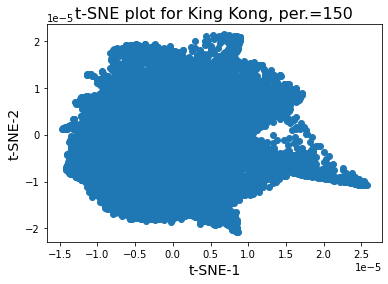

In [10]:
#perplexity 150
x_list = tsne_150_df['t-SNE-1'].tolist()
y_list = tsne_150_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=150', fontsize=16)
plt.savefig('tsne_150.jpeg')
plt.show()

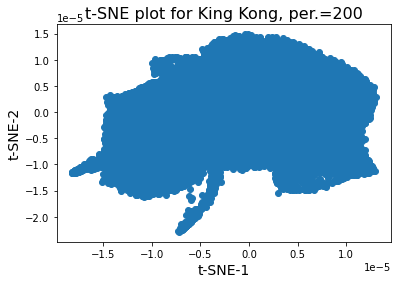

In [11]:
#perplexity 200
x_list = tsne_200_df['t-SNE-1'].tolist()
y_list = tsne_200_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=200', fontsize=16)
plt.savefig('tsne_200.jpeg')
plt.show()

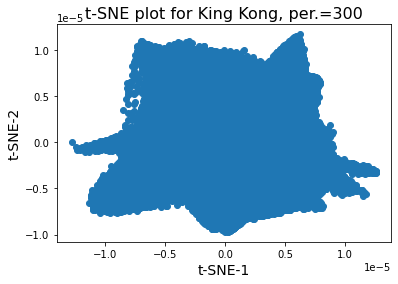

In [12]:
#perplexity 300
x_list = tsne_300_df['t-SNE-1'].tolist()
y_list = tsne_300_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=300', fontsize=16)
plt.savefig('tsne_300.jpeg')
plt.show()

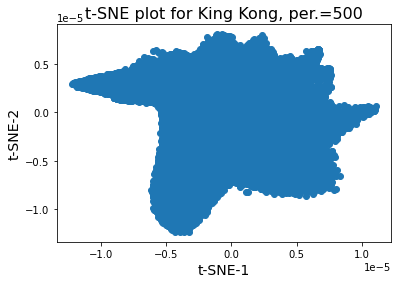

In [12]:
#perplexity 500
x_list = tsne_500_df['t-SNE-1'].tolist()
y_list = tsne_500_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=500', fontsize=16)
plt.savefig('tsne_500.jpeg')
plt.show()

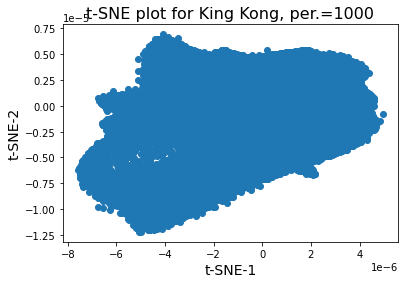

In [13]:
#perplexity 1000
x_list = tsne_1000_df['t-SNE-1'].tolist()
y_list = tsne_1000_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=1000', fontsize=16)
plt.savefig('tsne_1000.jpeg')
plt.show()

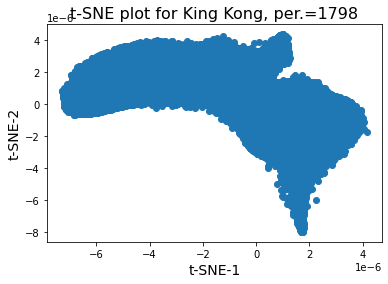

In [6]:
#perplexity 1798
x_list = tsne_1798_df['t-SNE-1'].tolist()
y_list = tsne_1798_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=1798', fontsize=16)
plt.savefig('tsne_1798.jpeg')
plt.show()

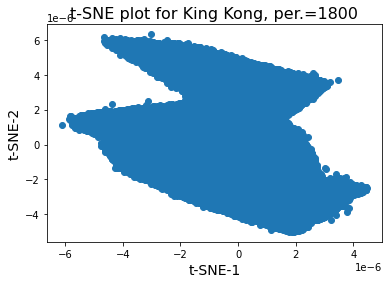

In [108]:
#perplexity 1800
x_list = tsne_1800_df['t-SNE-1'].tolist()
y_list = tsne_1800_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=1800', fontsize=16)
plt.savefig('tsne_1800.jpeg')
plt.show()

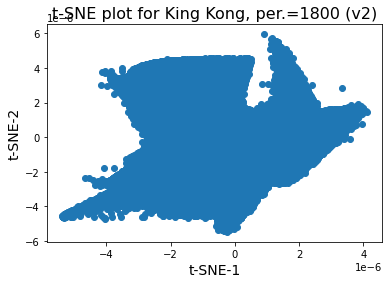

In [11]:
#perplexity 1800, v2
x_list = tsne_1800_v2_df['t-SNE-1'].tolist()
y_list = tsne_1800_v2_df['t-SNE-2'].tolist()

plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=1800 (v2)', fontsize=16)
plt.savefig('tsne_1800_v2.jpeg')
plt.show()

## 3D plots

In [14]:
#read in plots
tsne_560_3_df = pd.read_csv('tsne_560_3.csv')

## Use tsne 1800 (v2) data to cluster!!

In [20]:
#set cwd
os.chdir(tsne_dir)

In [65]:
tsne_1800_v2_df = pd.read_csv('tsne_1800_v2_2.csv')

In [66]:
tsne_1800_v2_df = tsne_1800_v2_df.iloc[:,1:]
tsne_1800_v2_df

,t-SNE-1,t-SNE-2
0,1.418606e-06,6.631707e-07
1,-6.933391e-07,2.534040e-07
2,6.804291e-07,-2.259025e-07
3,5.038889e-08,-4.581995e-07
4,1.417066e-06,2.104414e-07
...,...,...
179866,-2.417500e-06,-1.697494e-06
179867,-1.684048e-07,-2.372589e-07
179868,-2.179867e-06,9.262583e-07
179869,2.821215e-07,-1.208402e-07


In [20]:
#set ide
ide = 'tsne_1800_v2'

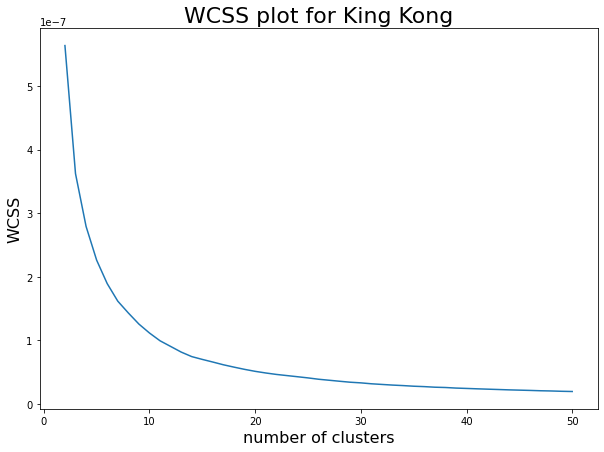

the elbow of the WCSS curve occurs at: 11
clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]


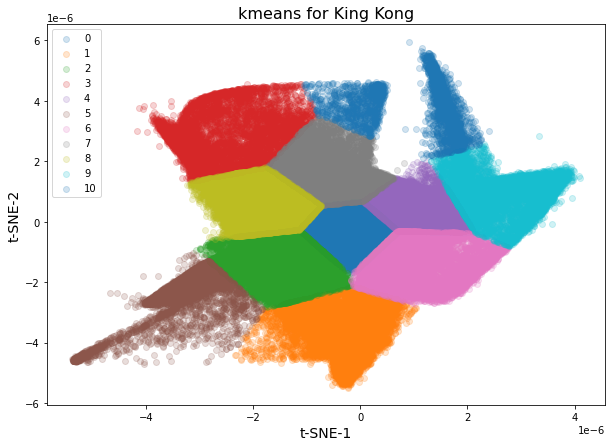

In [26]:
tsne_1800_kmeans = run_kmeans(tsne_1800_v2_df, ide)

In [22]:
tsne_1800_v2_df

,t-SNE-1,t-SNE-2
0,1.418606e-06,6.631707e-07
1,-6.933391e-07,2.534040e-07
2,6.804291e-07,-2.259025e-07
3,5.038889e-08,-4.581995e-07
4,1.417066e-06,2.104414e-07
...,...,...
179866,-2.417500e-06,-1.697494e-06
179867,-1.684048e-07,-2.372589e-07
179868,-2.179867e-06,9.262583e-07
179869,2.821215e-07,-1.208402e-07


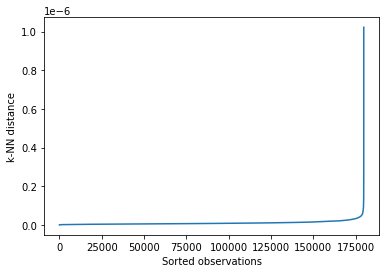

the elbow of the kNN curve occurs at:  179427 6.910331498017997e-08
clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, -1]
             t-SNE-1       t-SNE-2
0       1.418606e-06  6.631707e-07
1      -6.933391e-07  2.534040e-07
2       6.804291e-07 -2.259025e-07
3       5.038889e-08 -4.581995e-07
4       1.417066e-06  2.104414e-07
...              ...           ...
179866 -2.417500e-06 -1.697494e-06
179867 -1.684048e-07 -2.372589e-07
179868 -2.179867e-06  9.262583e-07
179869  2.821215e-07 -1.208402e-07
179870  1.952716e-06  1.019021e-06

[179871 rows x 2 columns]


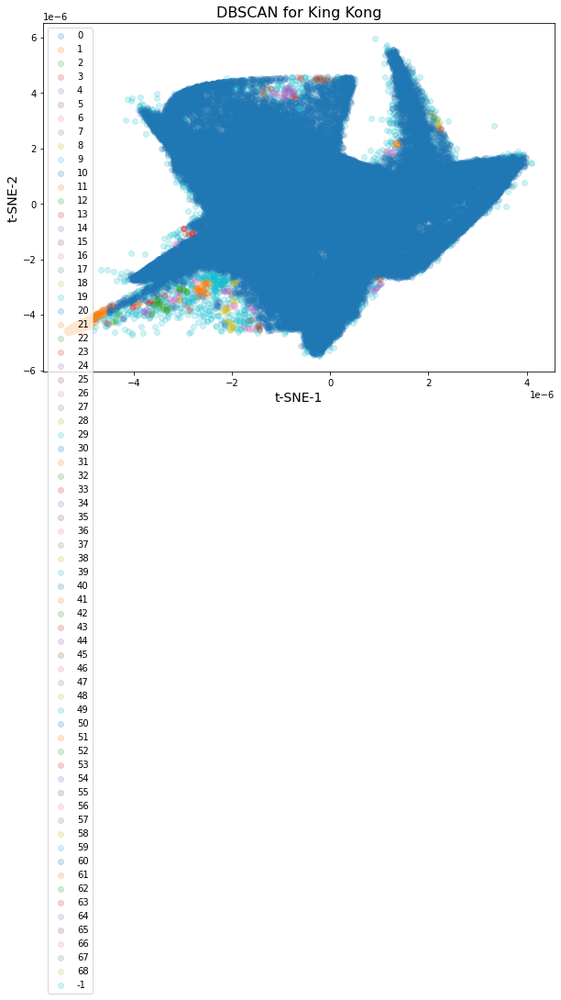

In [23]:
tsne_1800_dbscan = run_DBSCAN(tsne_1800_v2_df, ide)

In [ ]:
tsne_1800_v2_df

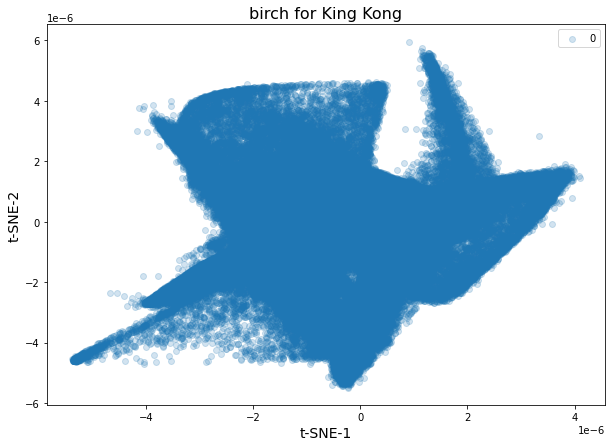

In [24]:
branching_factor = 50
threshold = 1.5
tsne_1800_birch = run_BIRCH(tsne_1800_v2_df, ide, branching_factor, threshold)

clusters [7]


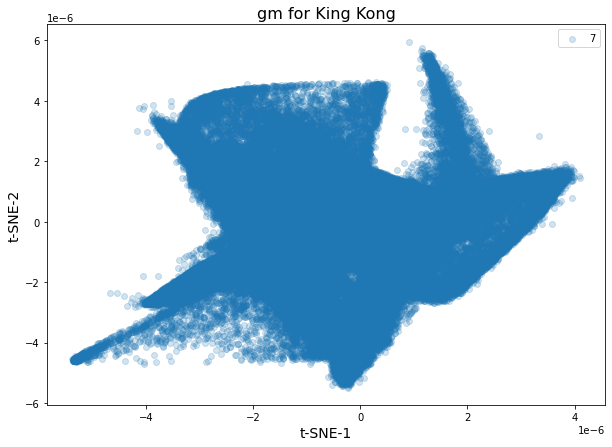

In [25]:
num_clusters = 11
tsne_1800_gm = run_GM(tsne_1800_v2_df, ide, num_clusters)

## Now let's implement cluster analysis

In [11]:
os.chdir(tsne_dir)

In [14]:
tsne_1800_kmeans = pd.read_csv(r'./KMeans/tsne_1800_v2_kmeans.csv')
tsne_1800_kmeans = tsne_1800_kmeans.iloc[:, 1:]
tsne_1800_kmeans

,t-SNE-1,t-SNE-2,cluster
0,1.418606e-06,6.631707e-07,4
1,-6.933391e-07,2.534040e-07,0
2,6.804291e-07,-2.259025e-07,4
3,5.038889e-08,-4.581995e-07,0
4,1.417066e-06,2.104414e-07,4
...,...,...,...
179866,-2.417500e-06,-1.697494e-06,2
179867,-1.684048e-07,-2.372589e-07,0
179868,-2.179867e-06,9.262583e-07,8
179869,2.821215e-07,-1.208402e-07,0


In [16]:
tsne_1800_dbscan = pd.read_csv(r'./DBSCAN/tsne_1800_v2_dbscan.csv')
tsne_1800_dbscan = tsne_1800_dbscan.iloc[:, 1:]
tsne_1800_dbscan

,t-SNE-1,t-SNE-2,cluster
0,1.418606e-06,6.631707e-07,0
1,-6.933391e-07,2.534040e-07,0
2,6.804291e-07,-2.259025e-07,0
3,5.038889e-08,-4.581995e-07,0
4,1.417066e-06,2.104414e-07,0
...,...,...,...
179866,-2.417500e-06,-1.697494e-06,0
179867,-1.684048e-07,-2.372589e-07,0
179868,-2.179867e-06,9.262583e-07,0
179869,2.821215e-07,-1.208402e-07,0


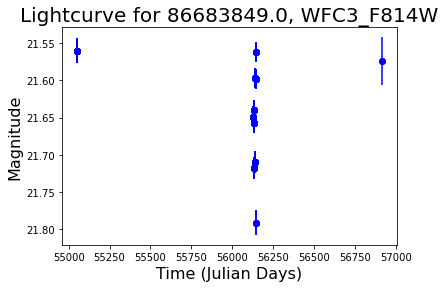

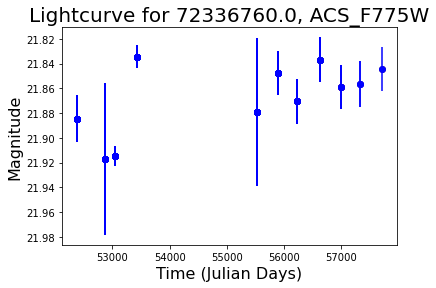

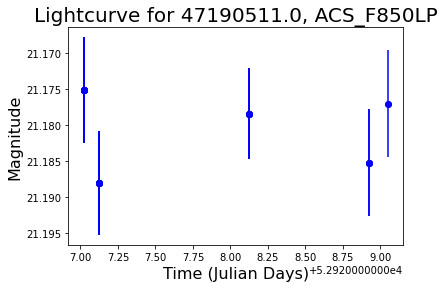

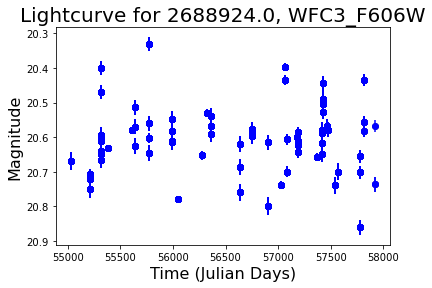

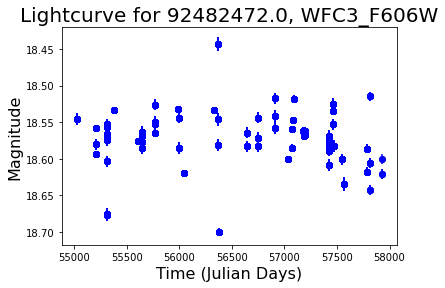

...

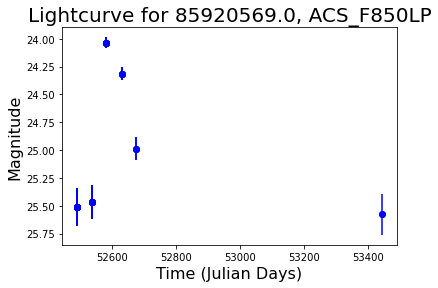

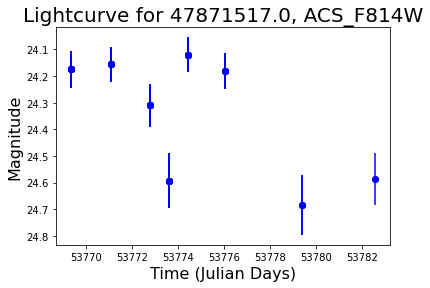

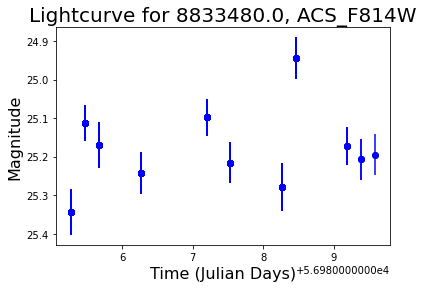

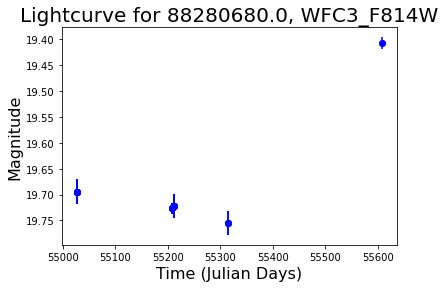

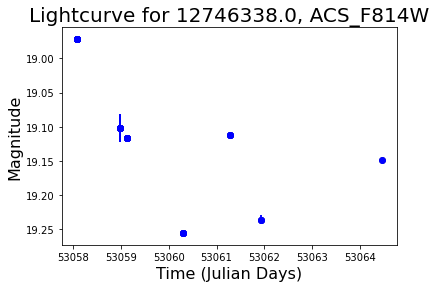

In [29]:
#first for k means
implement_cluster_analysis(tsne_1800_kmeans, 'KMeans')

cluster:  40


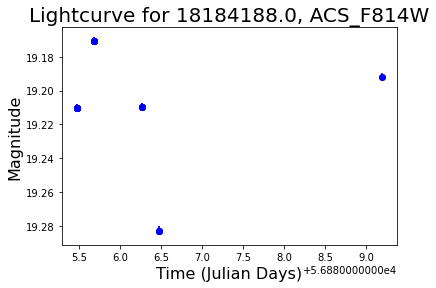

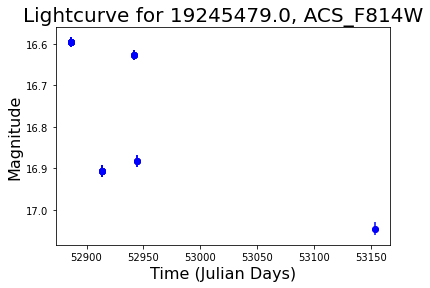

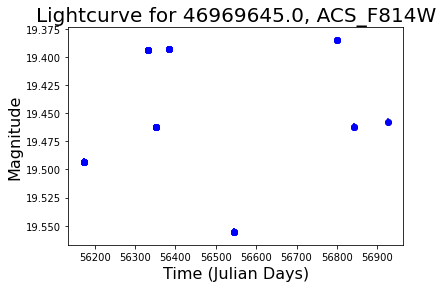

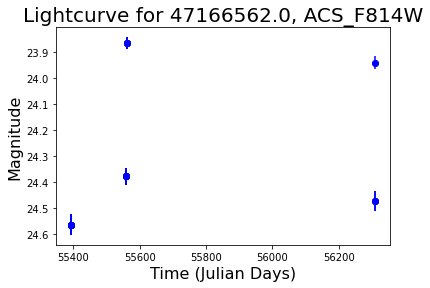

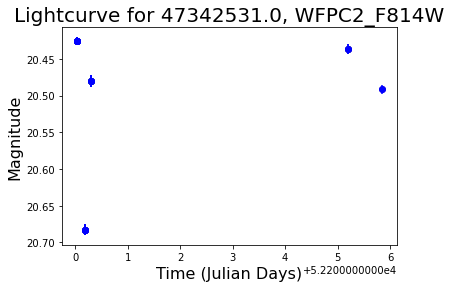

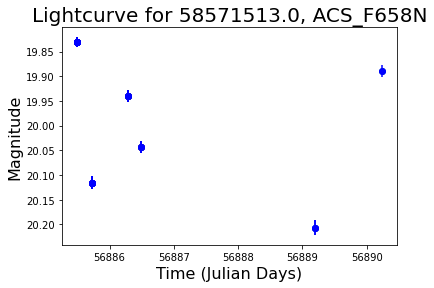

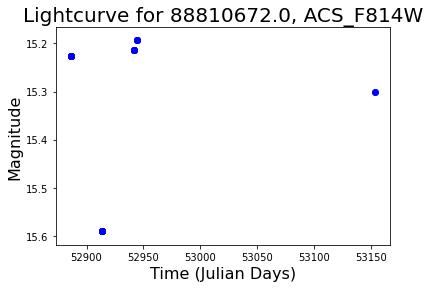

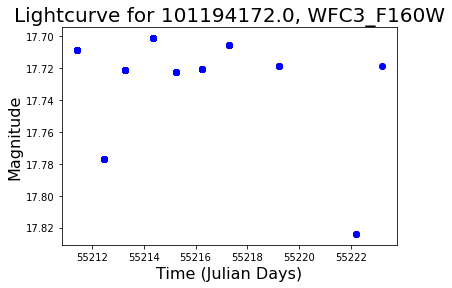

cluster:  41


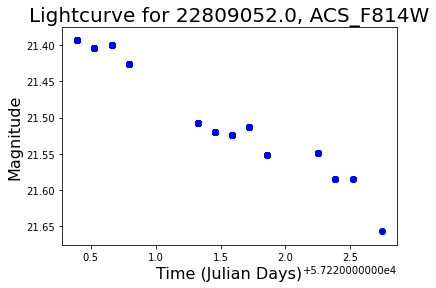

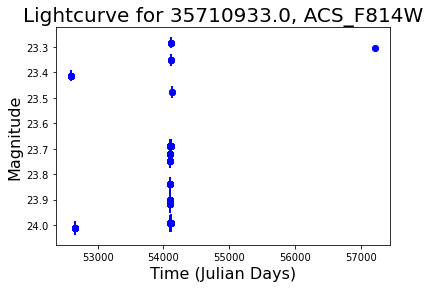

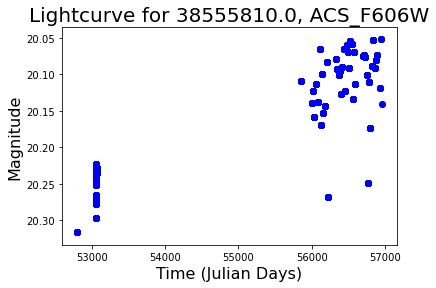

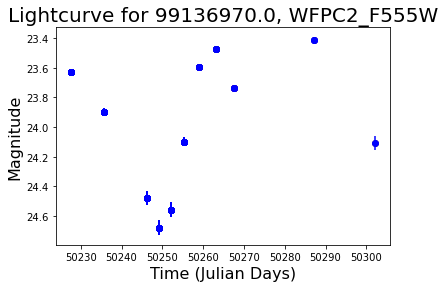

cluster:  37


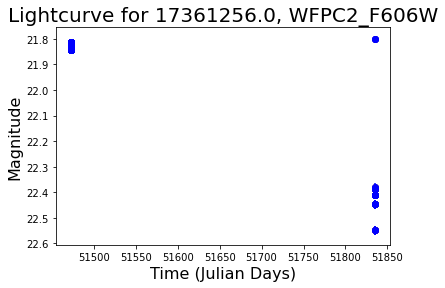

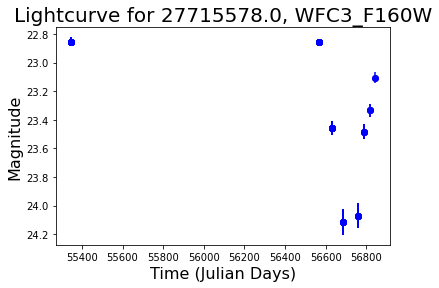

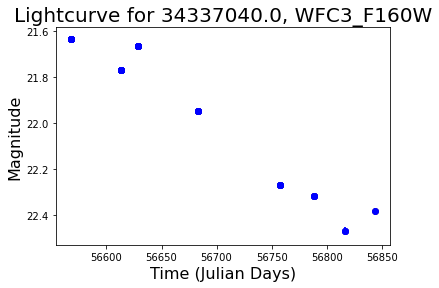

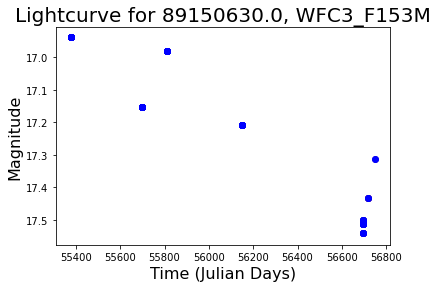

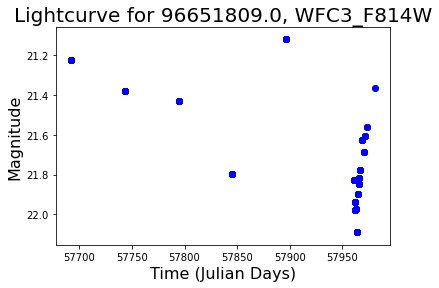

cluster:  36


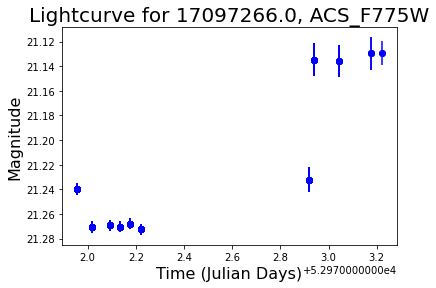

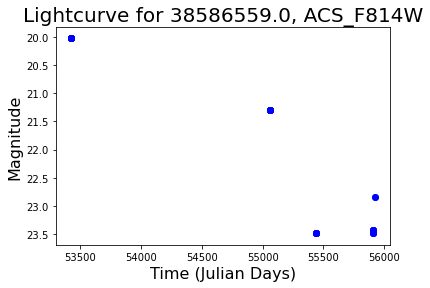

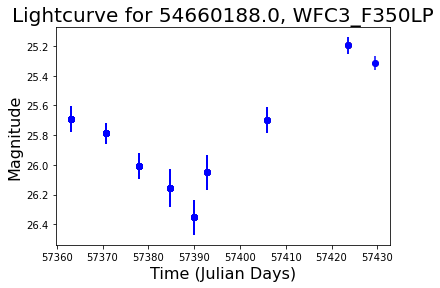

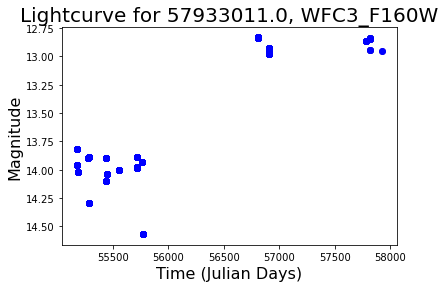

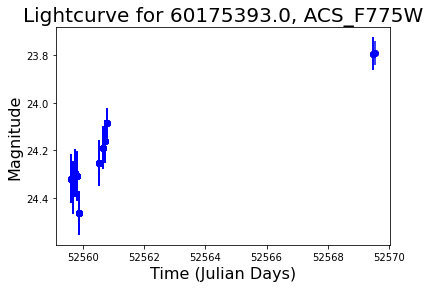

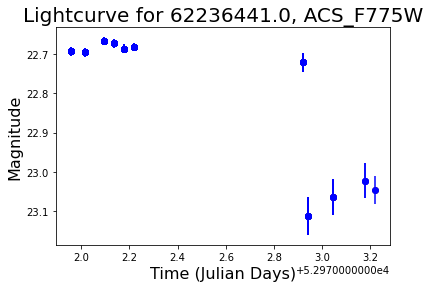

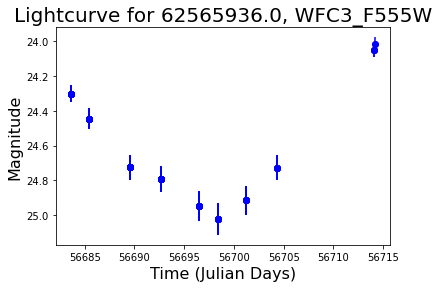

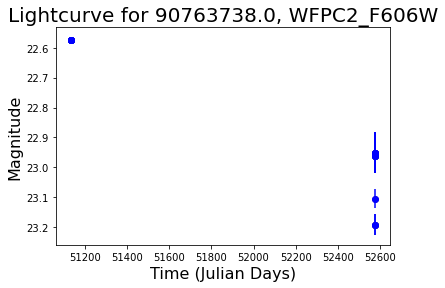

cluster:  6


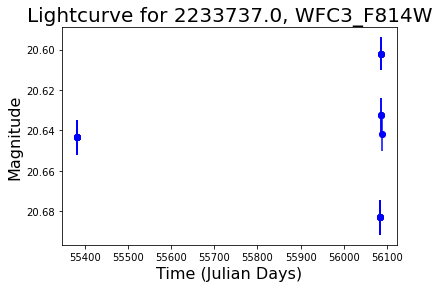

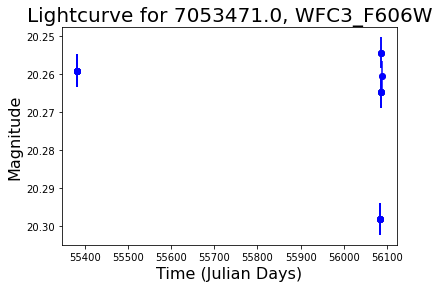

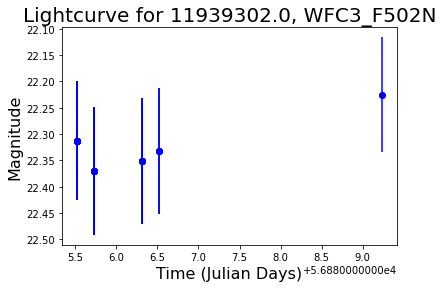

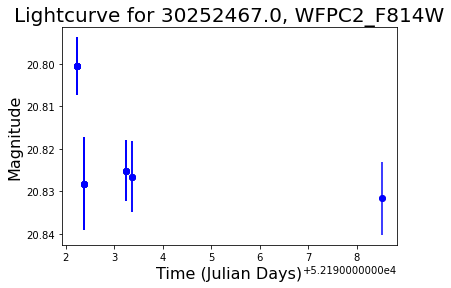

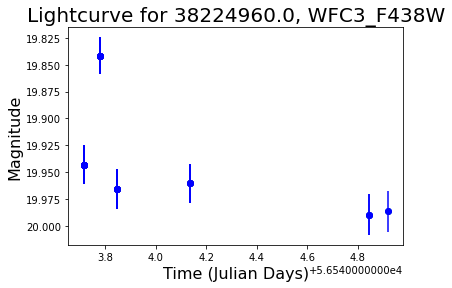

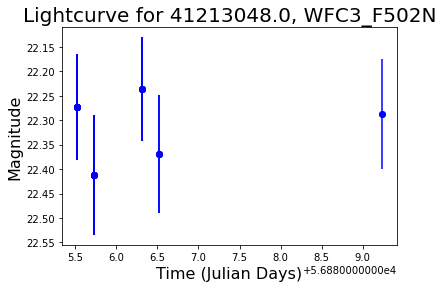

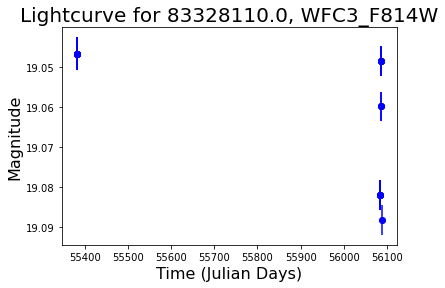

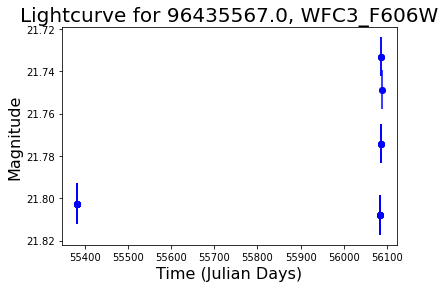

cluster:  7


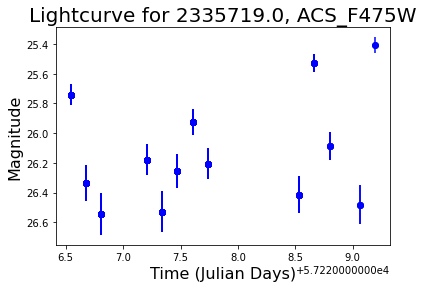

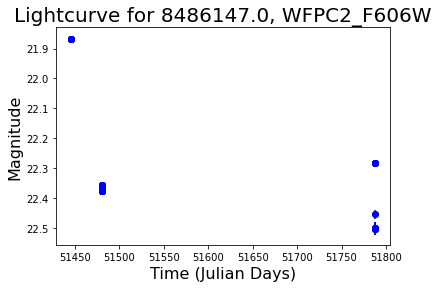

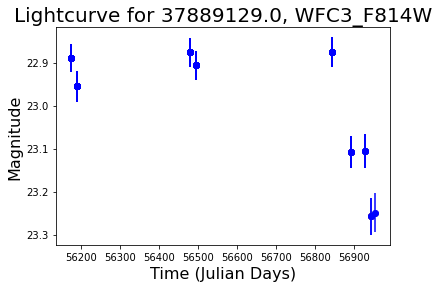

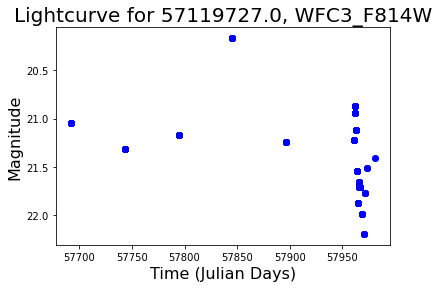

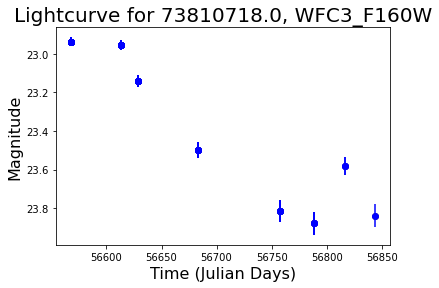

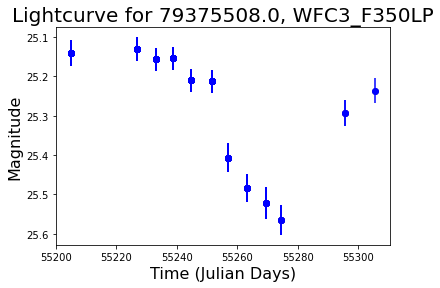

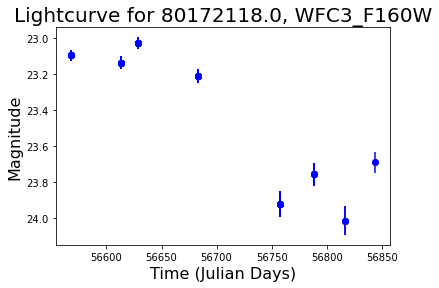

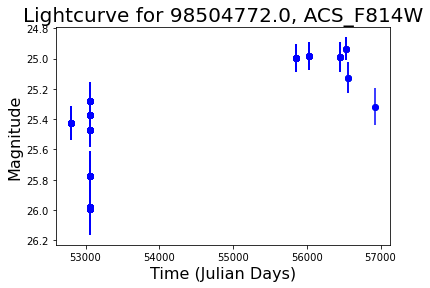

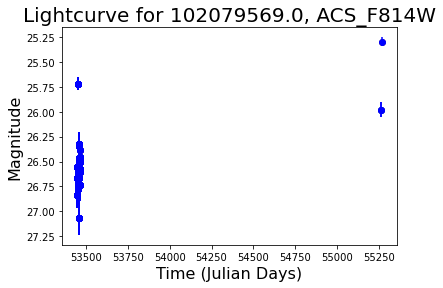

cluster:  57


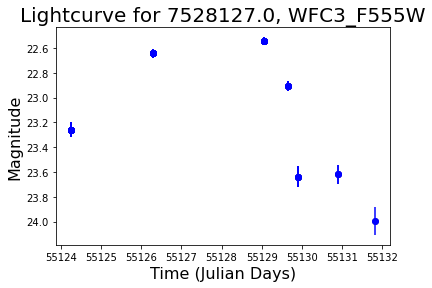

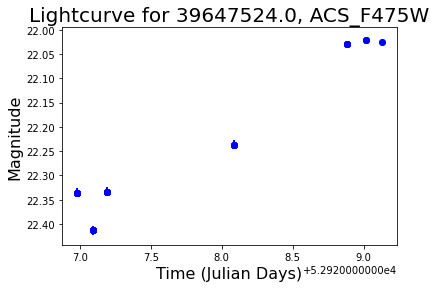

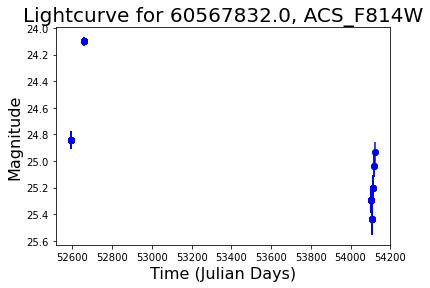

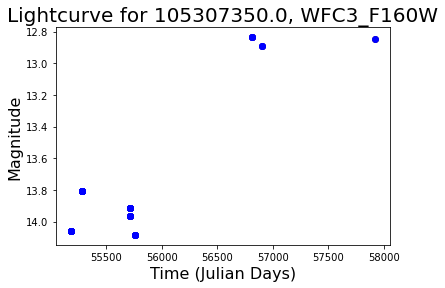

cluster:  56


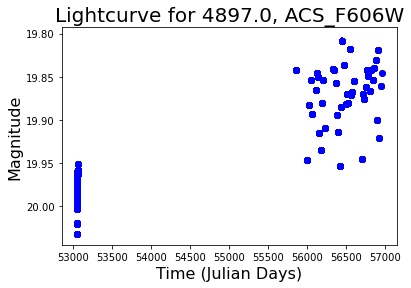

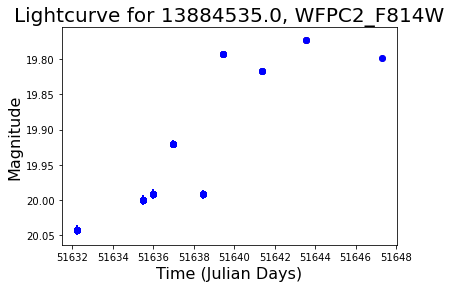

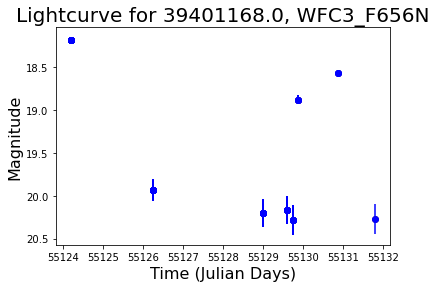

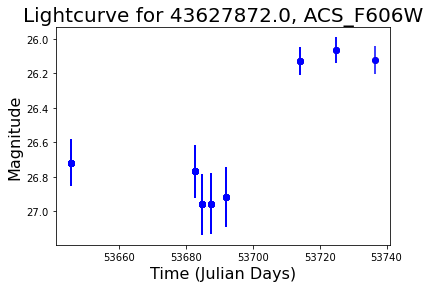

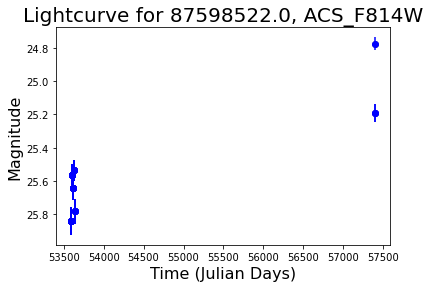

cluster:  20


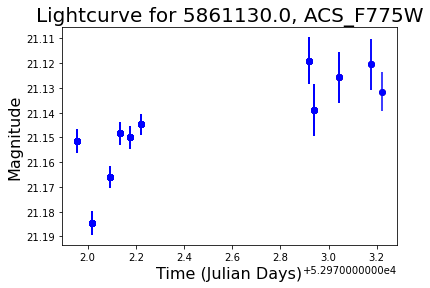

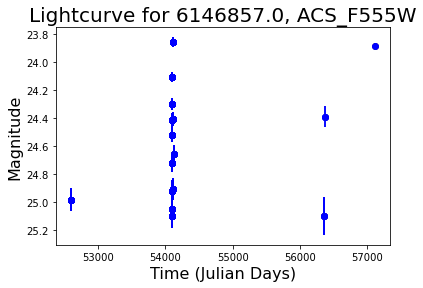

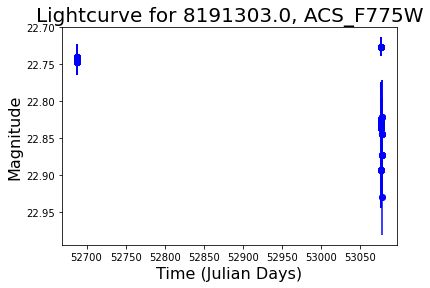

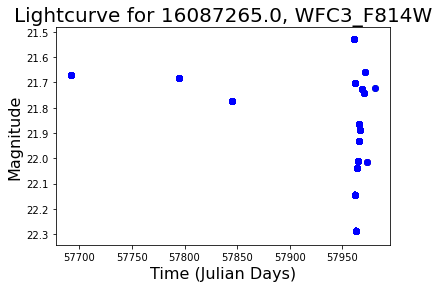

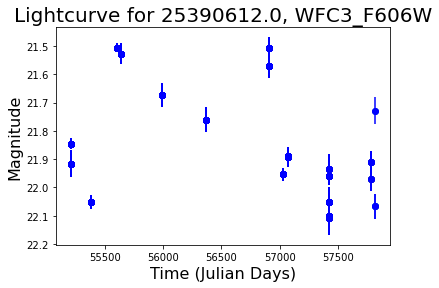

...

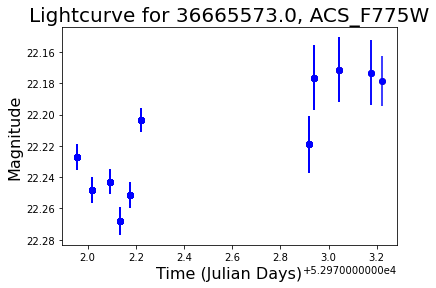

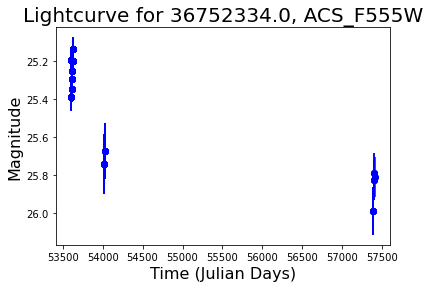

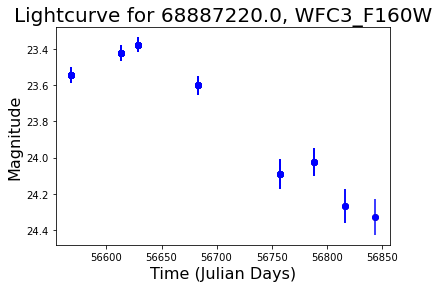

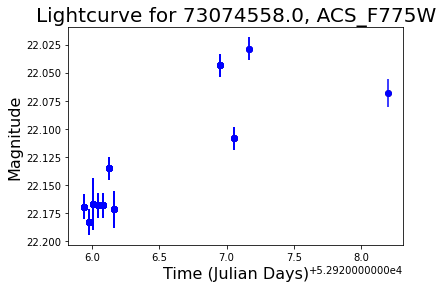

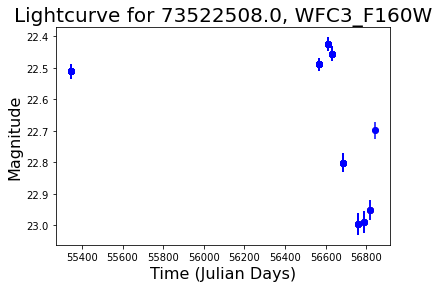

cluster:  21


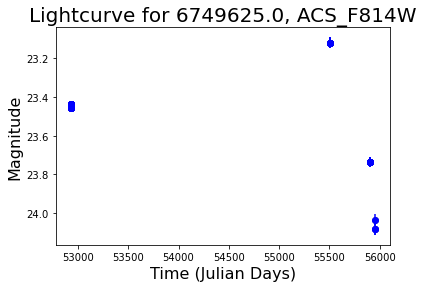

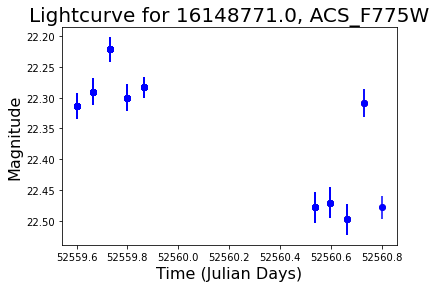

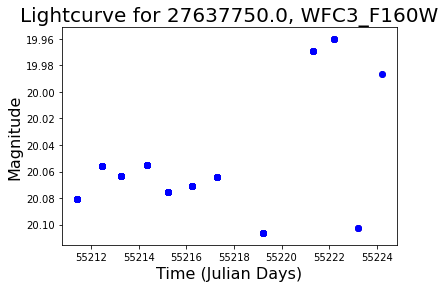

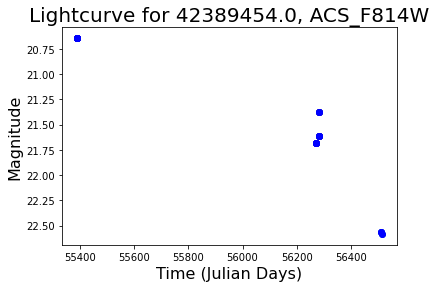

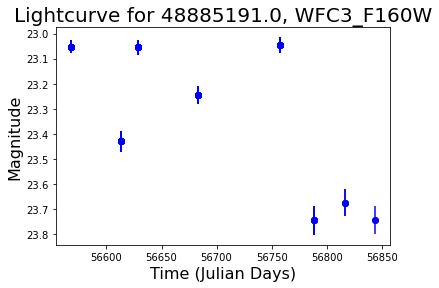

...

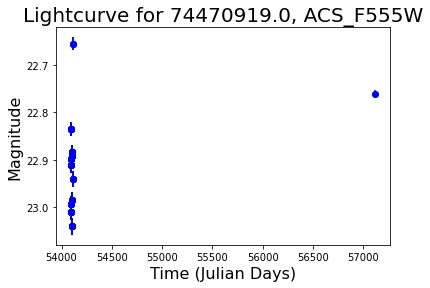

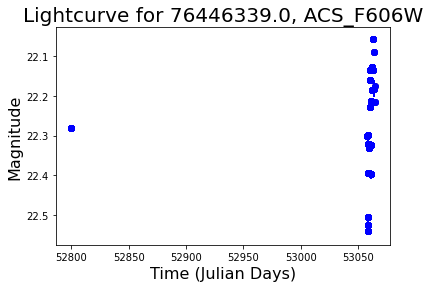

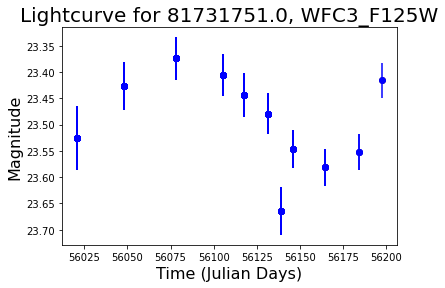

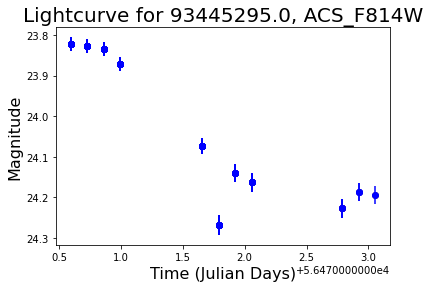

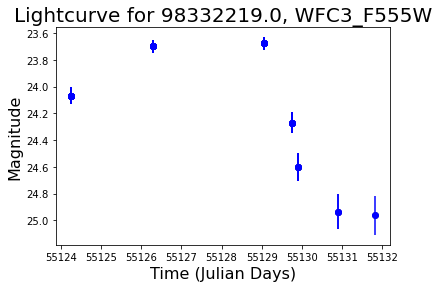

cluster:  68


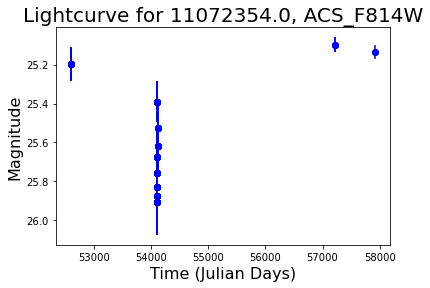

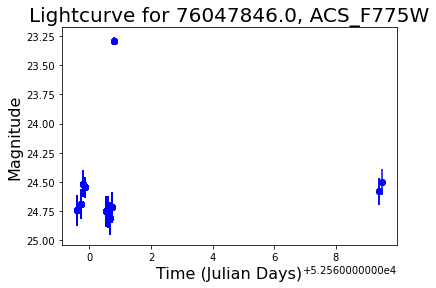

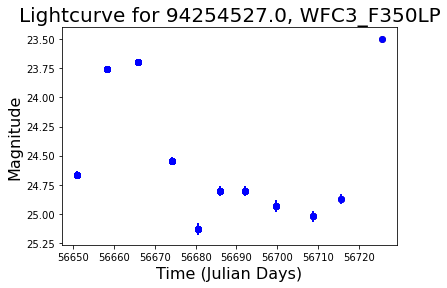

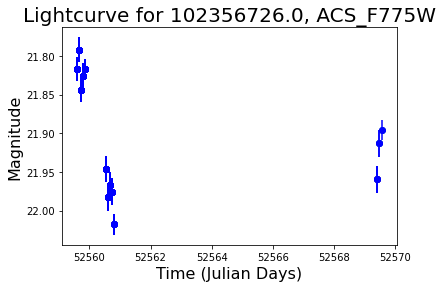

cluster:  14


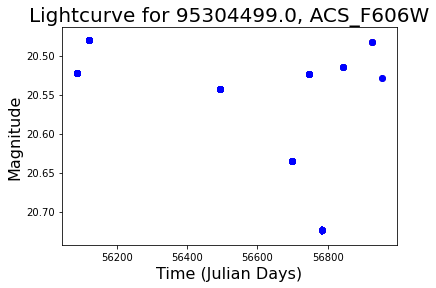

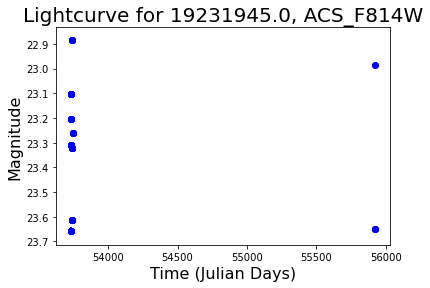

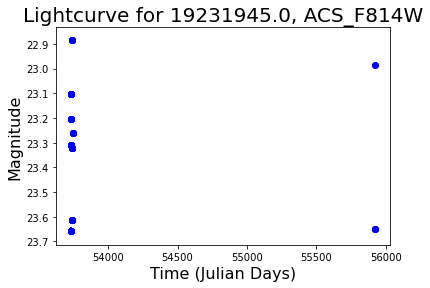

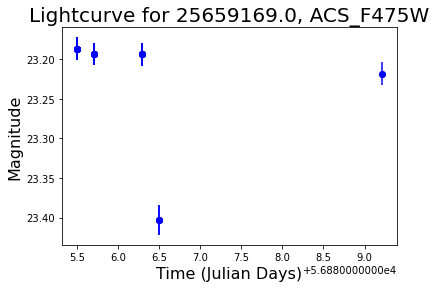

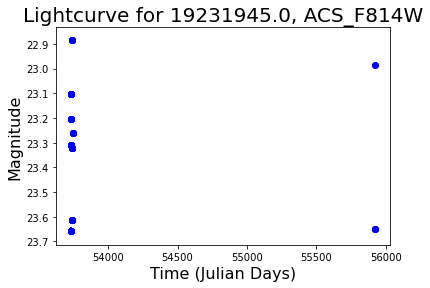

...

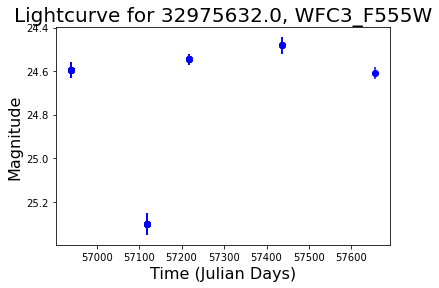

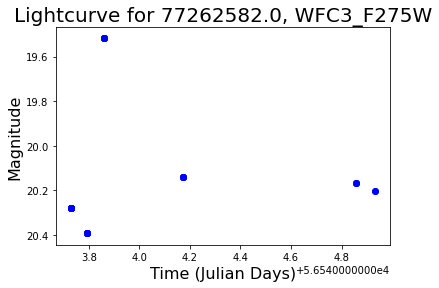

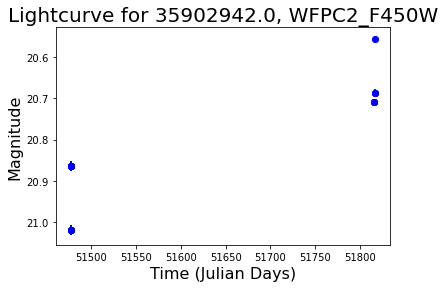

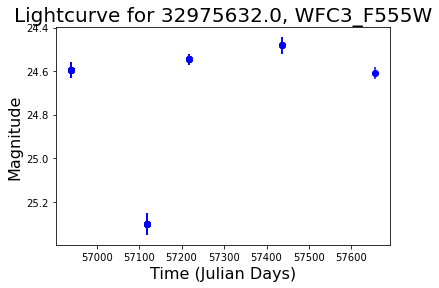

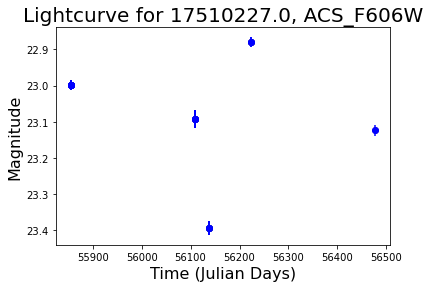

cluster:  15


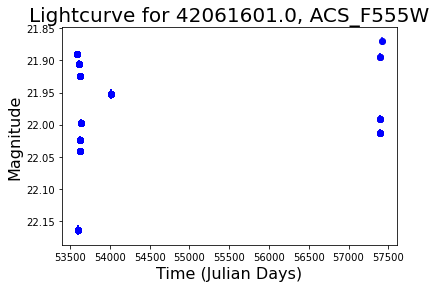

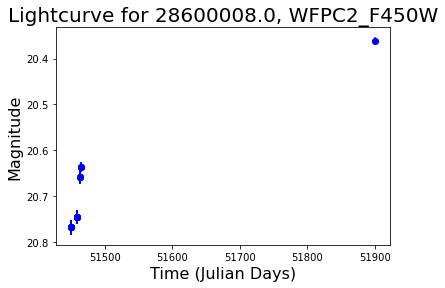

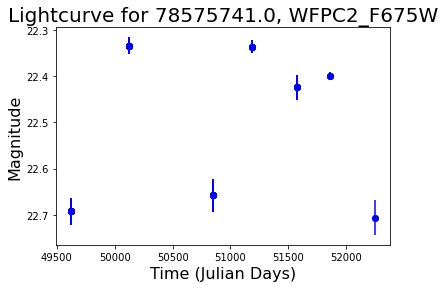

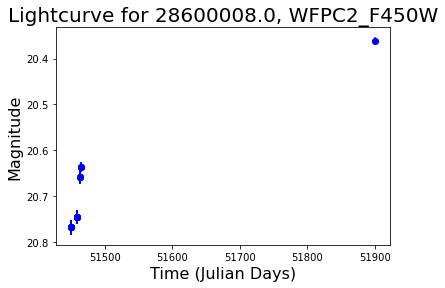

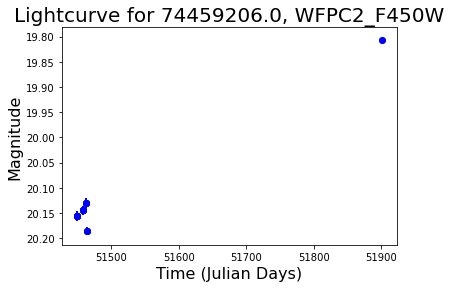

...

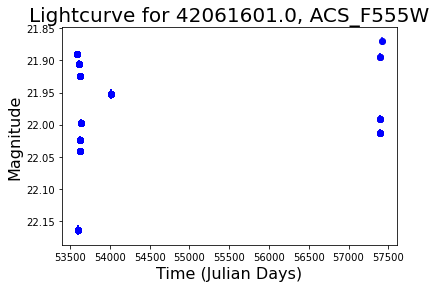

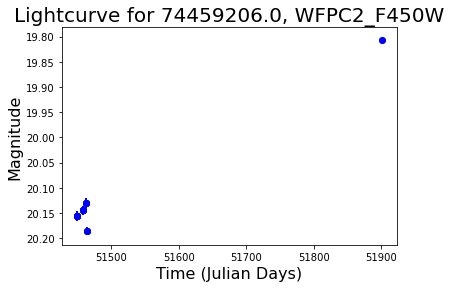

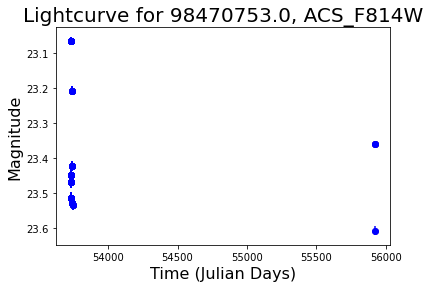

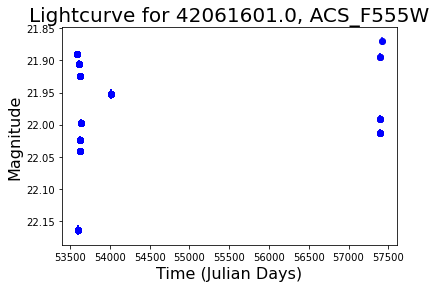

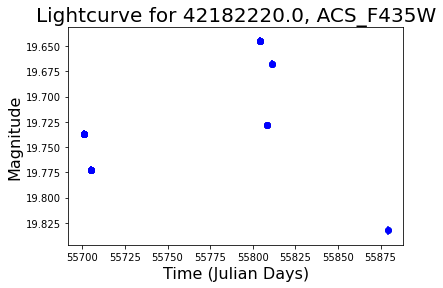

cluster:  63


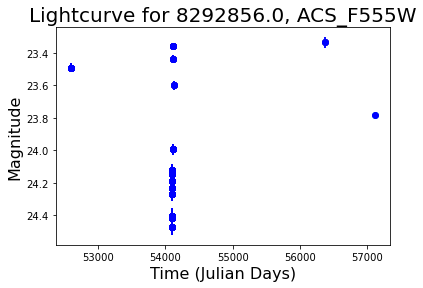

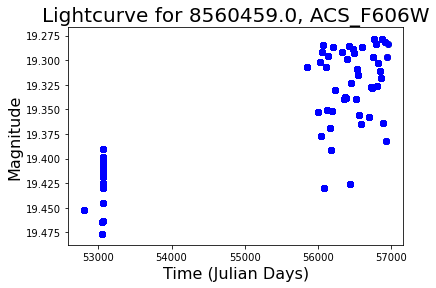

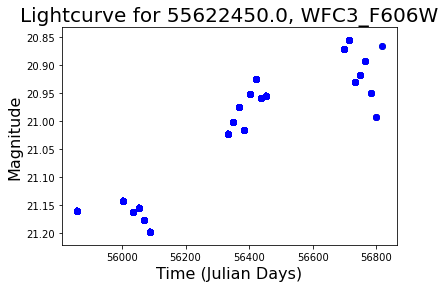

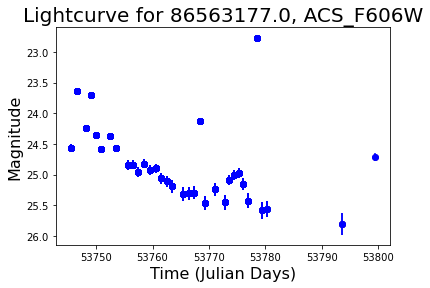

cluster:  62


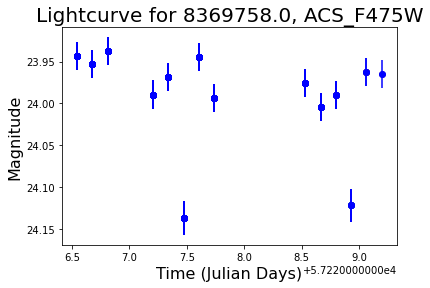

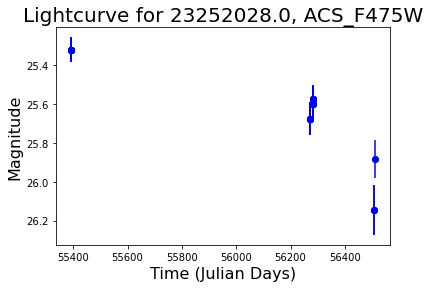

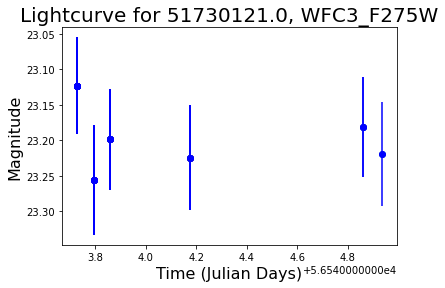

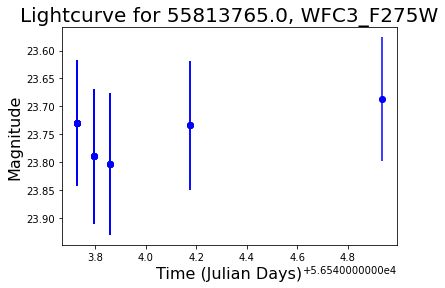

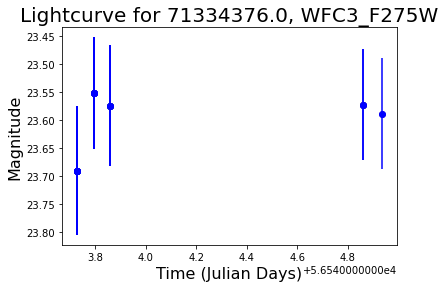

cluster:  19


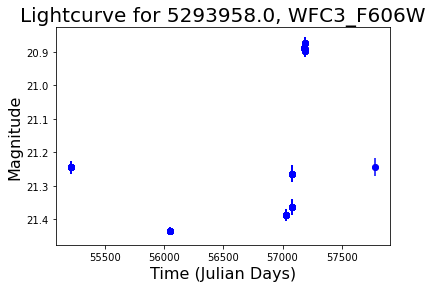

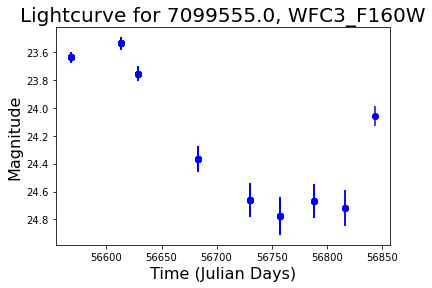

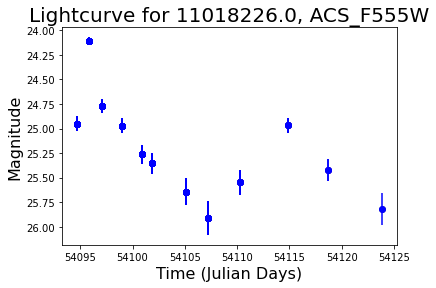

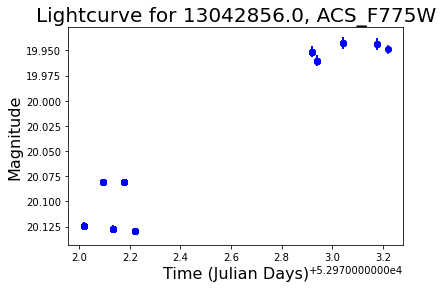

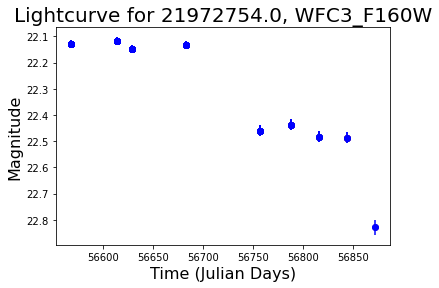

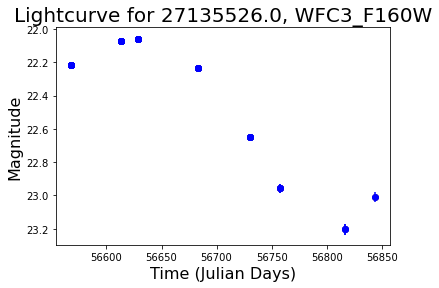

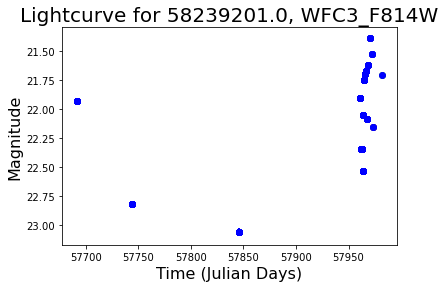

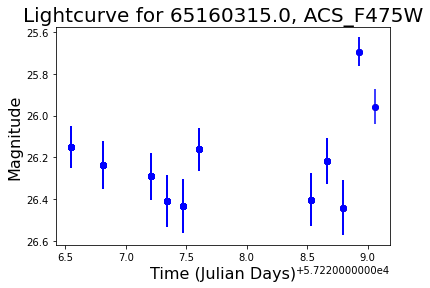

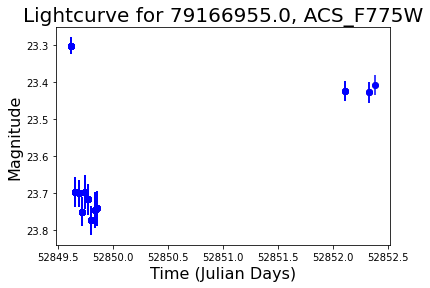

cluster:  18


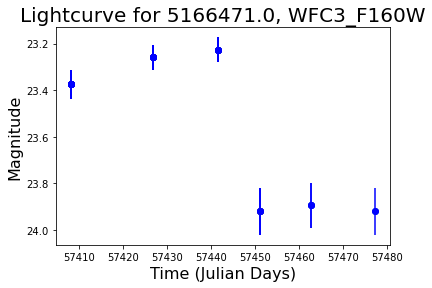

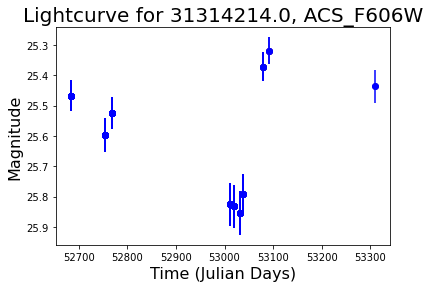

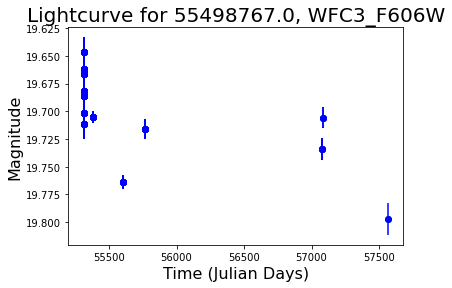

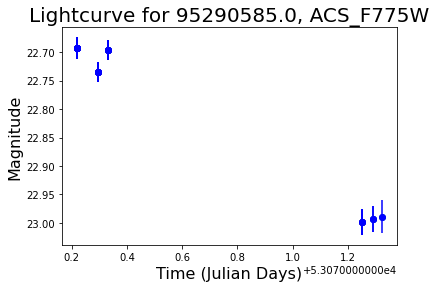

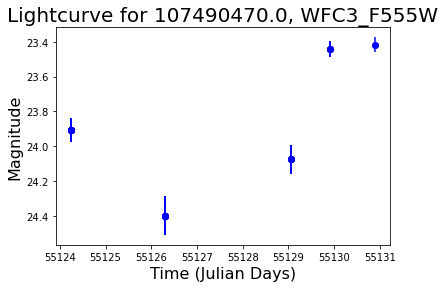

cluster:  50


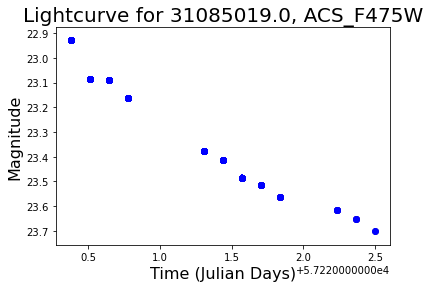

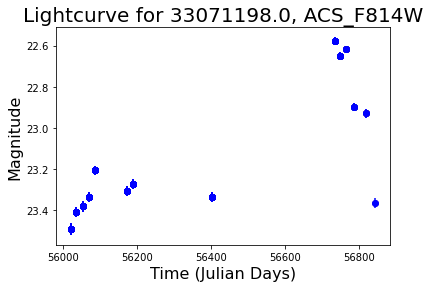

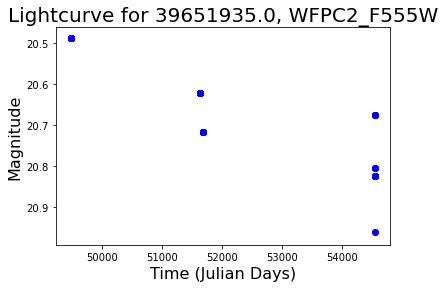

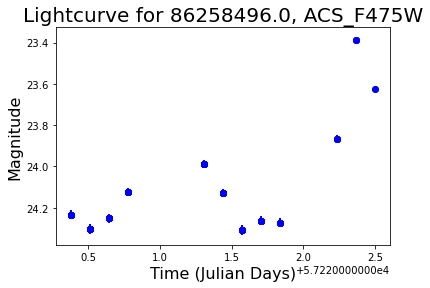

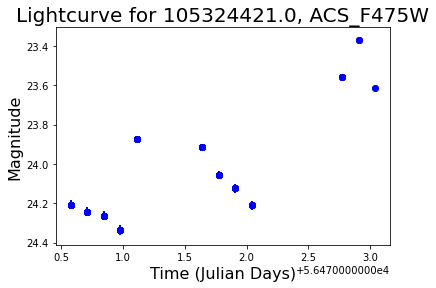

cluster:  51


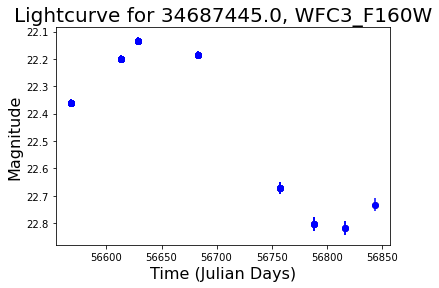

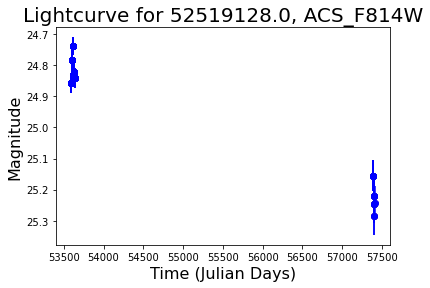

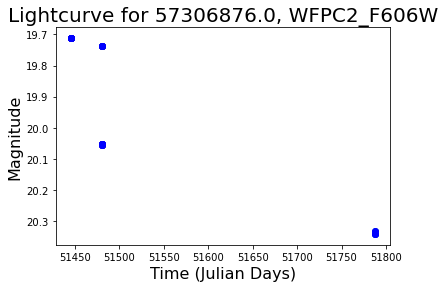

cluster:  1


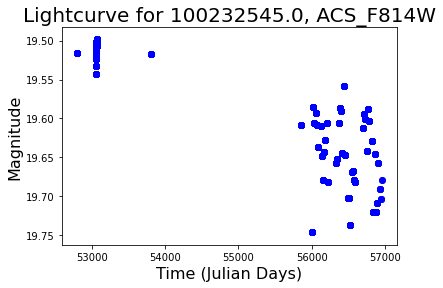

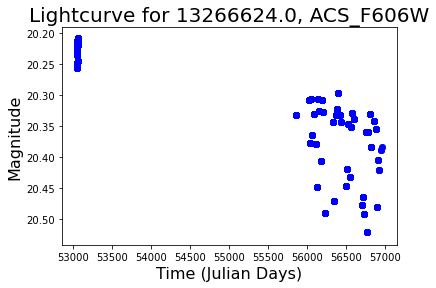

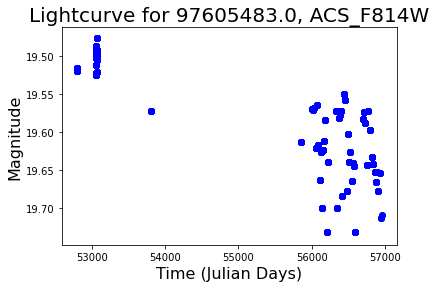

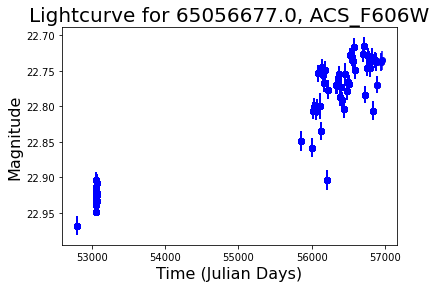

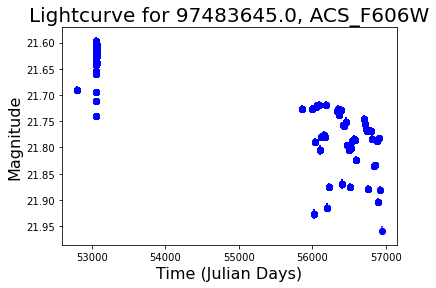

...

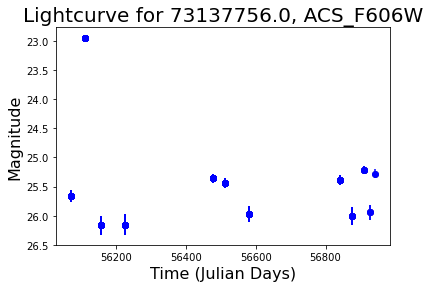

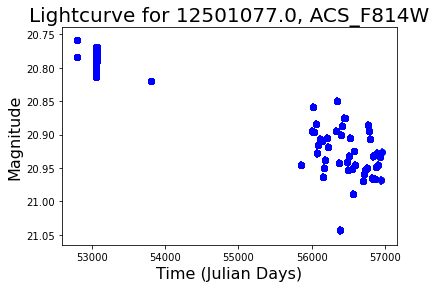

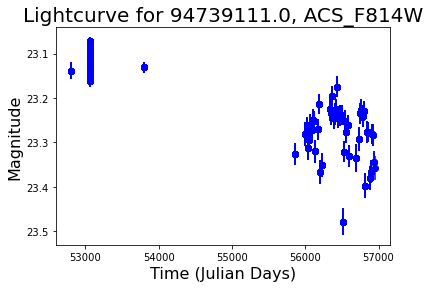

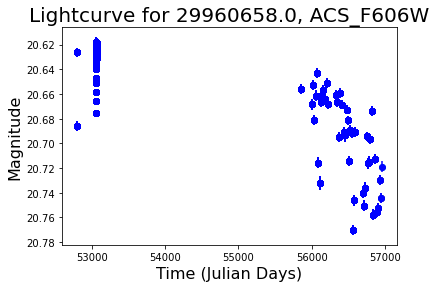

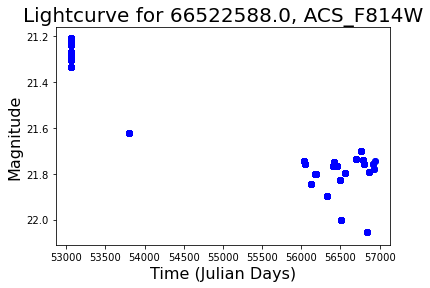

cluster:  0


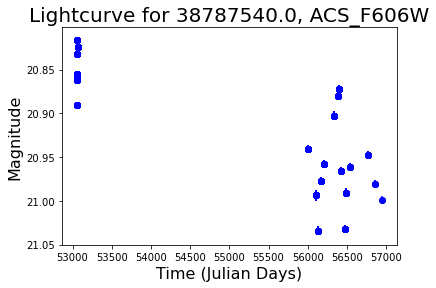

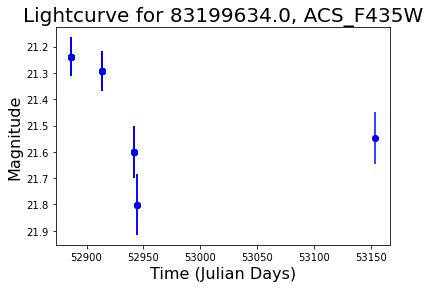

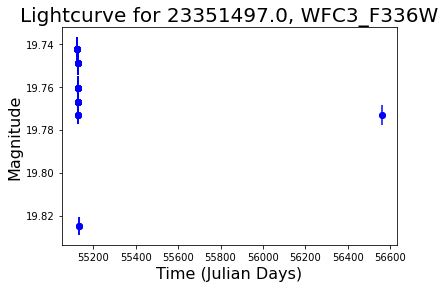

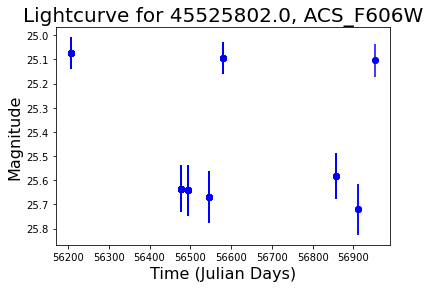

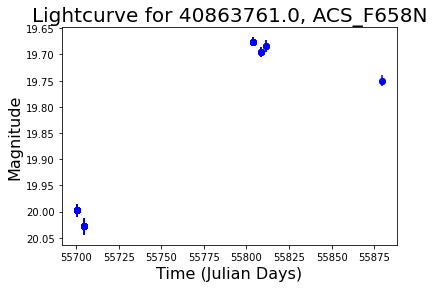

...

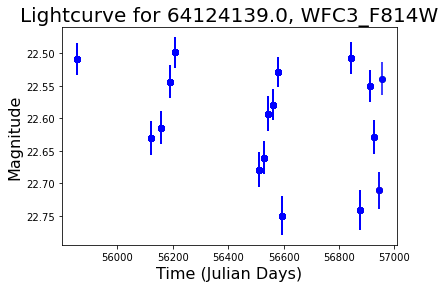

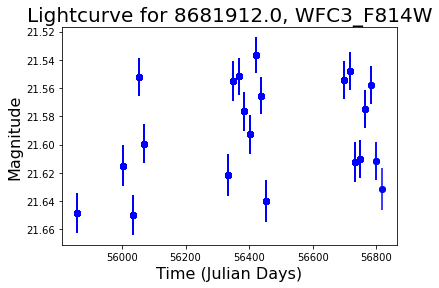

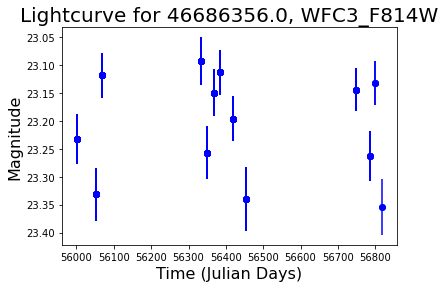

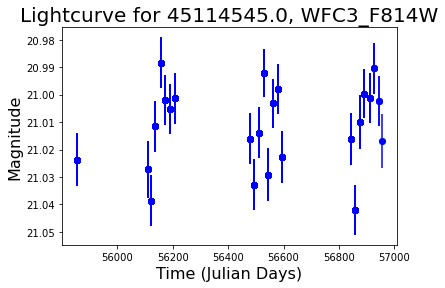

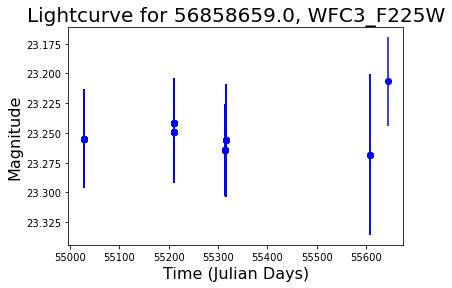

cluster:  27


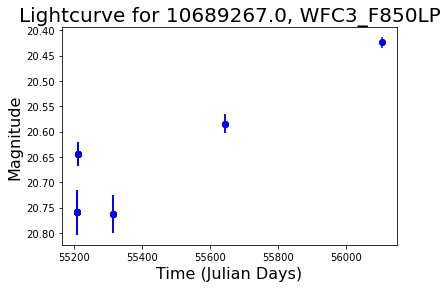

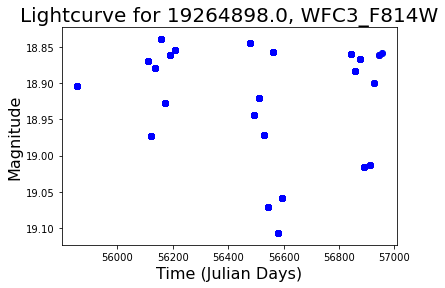

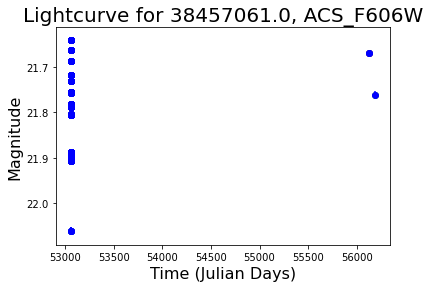

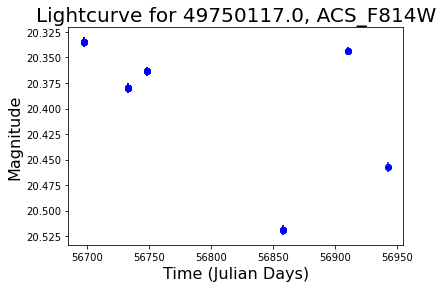

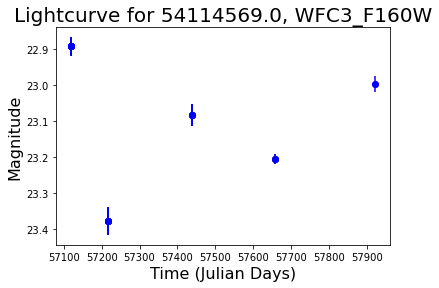

...

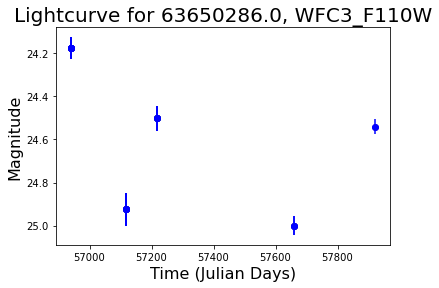

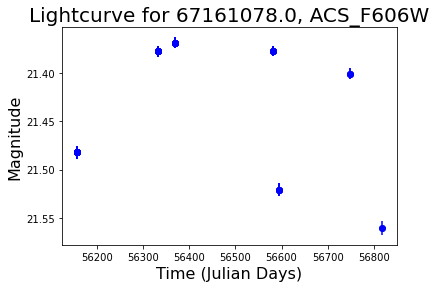

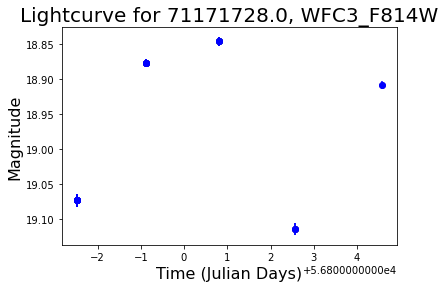

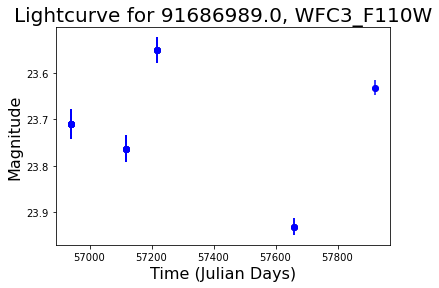

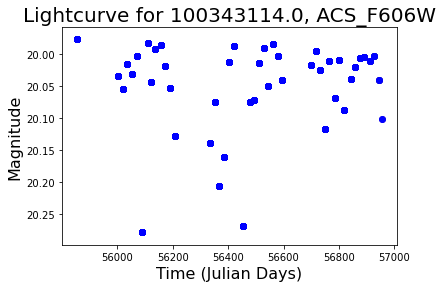

cluster:  26


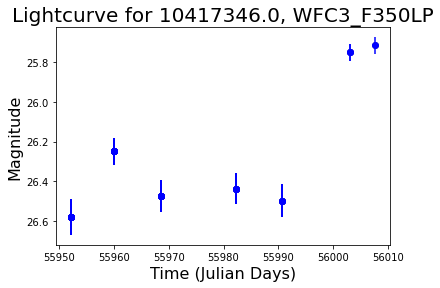

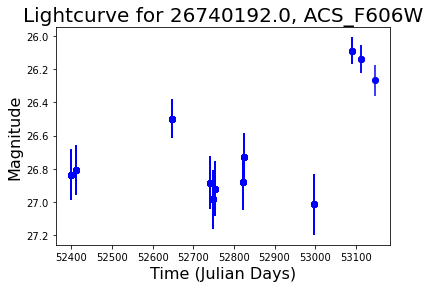

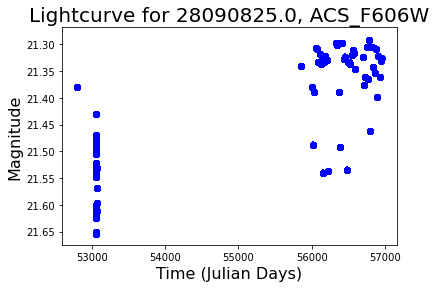

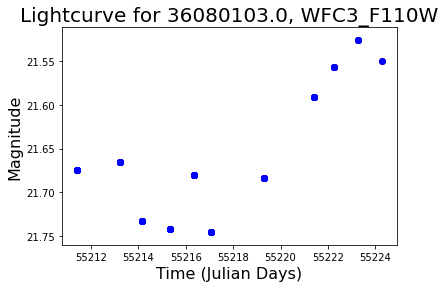

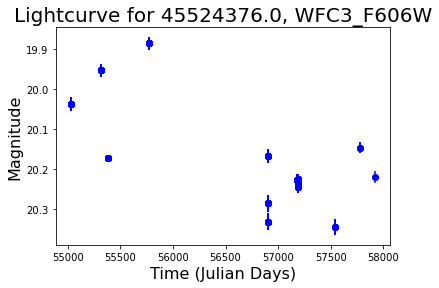

...

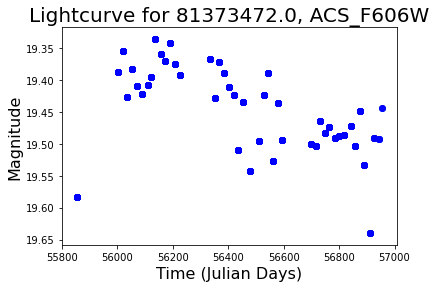

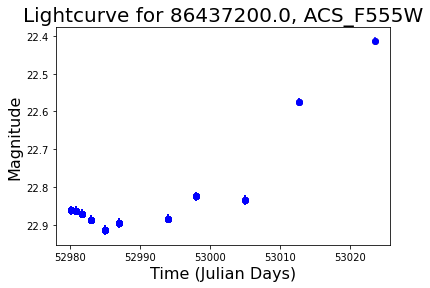

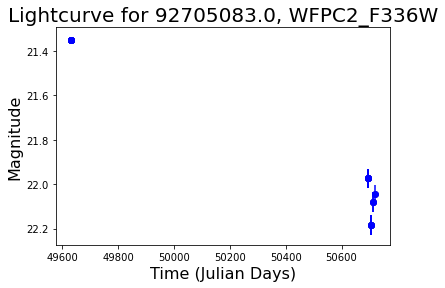

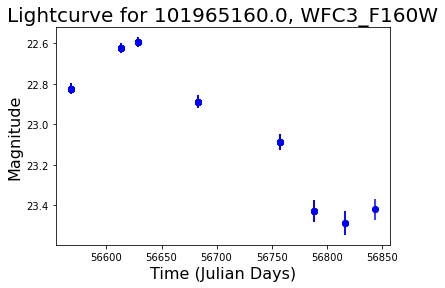

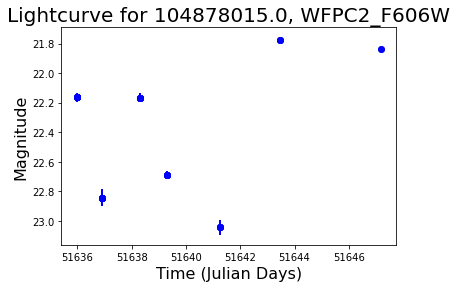

cluster:  13


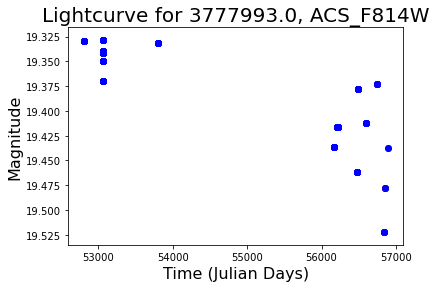

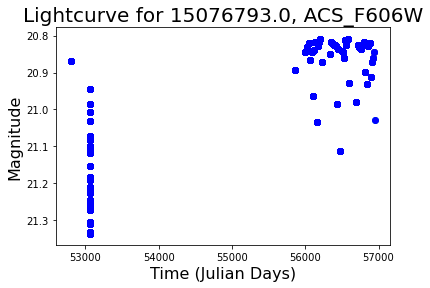

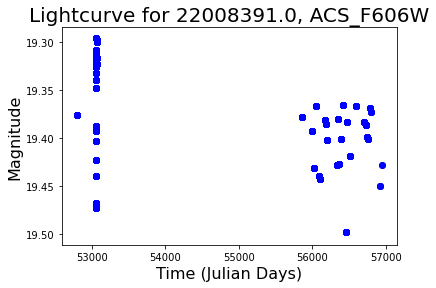

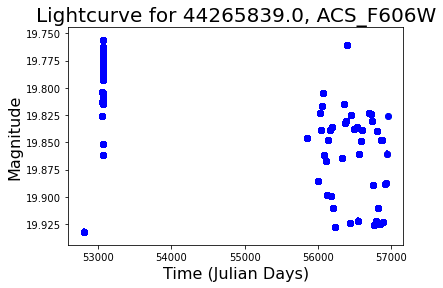

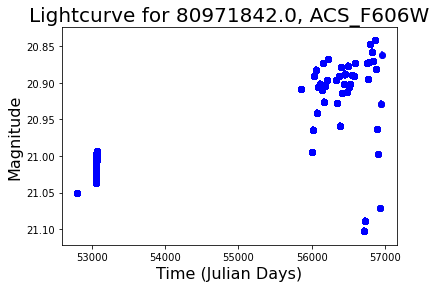

cluster:  12


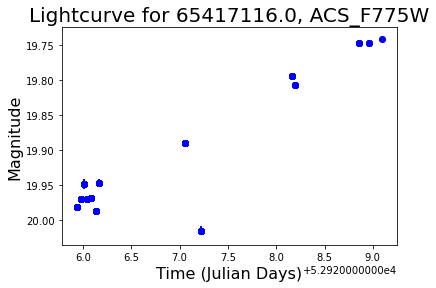

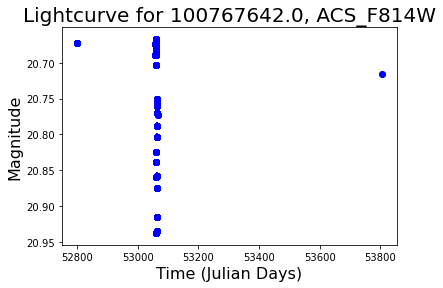

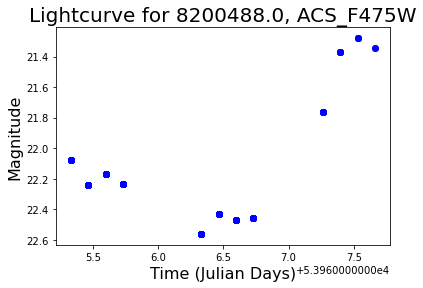

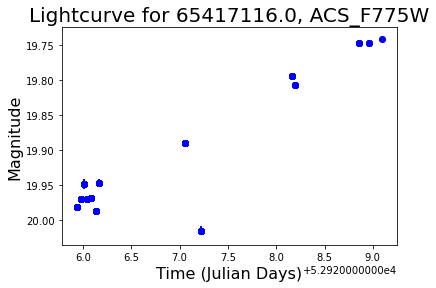

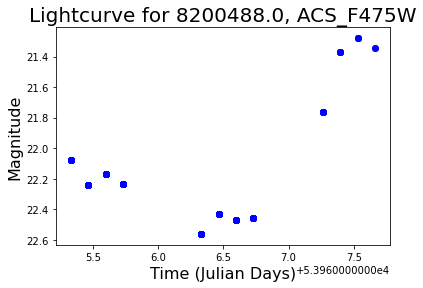

...

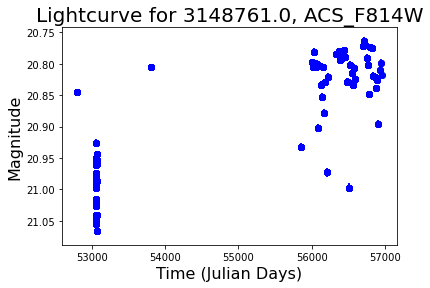

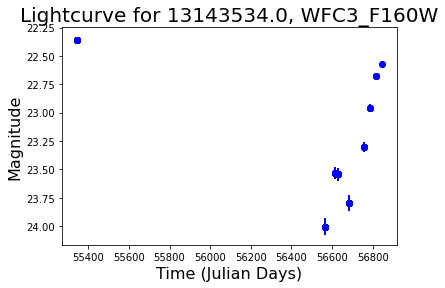

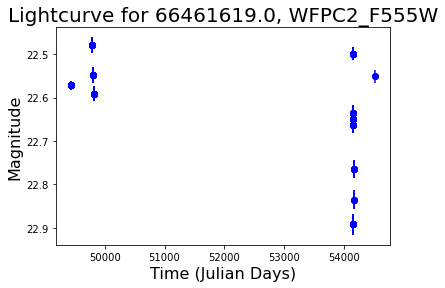

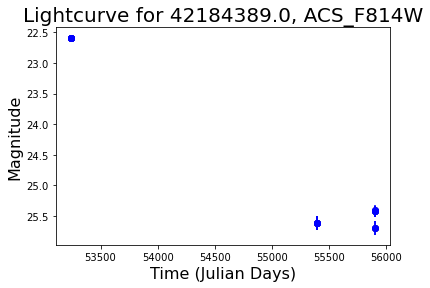

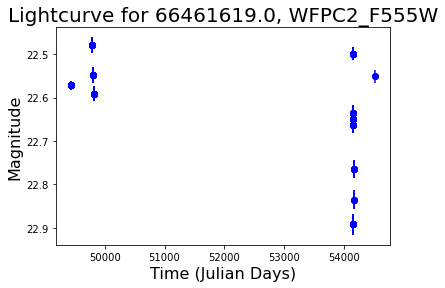

cluster:  64


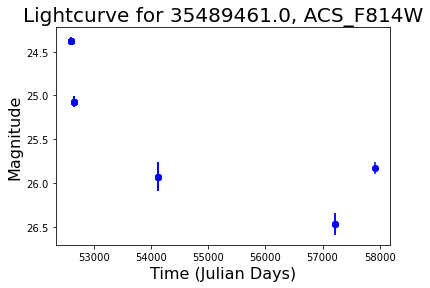

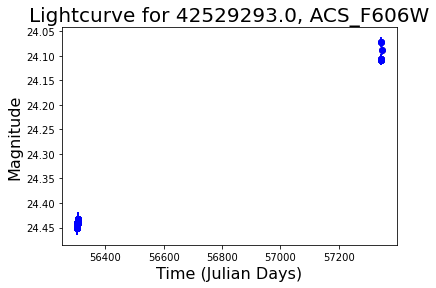

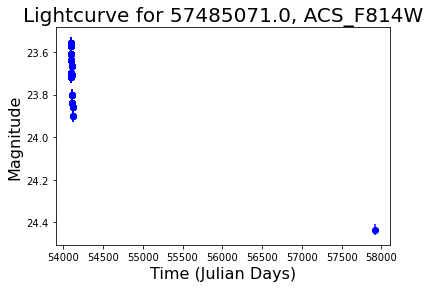

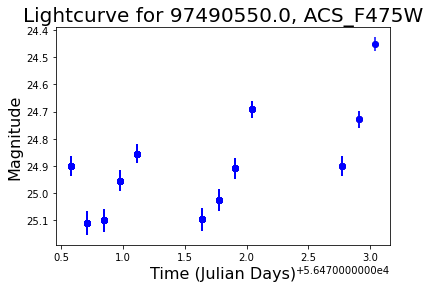

cluster:  65


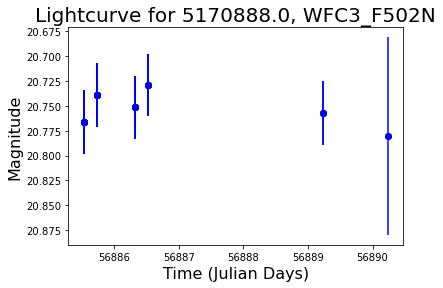

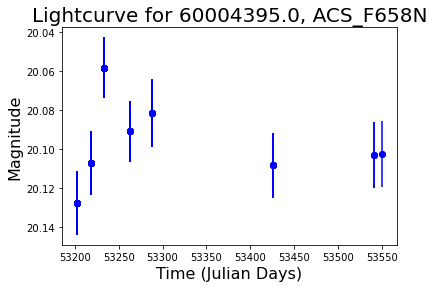

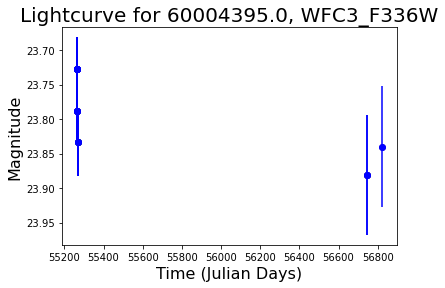

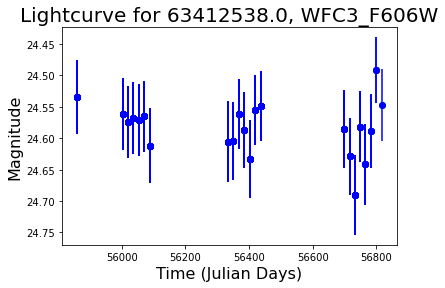

cluster:  -1


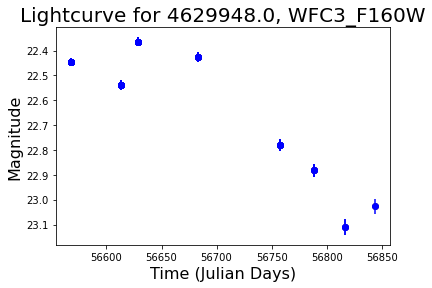

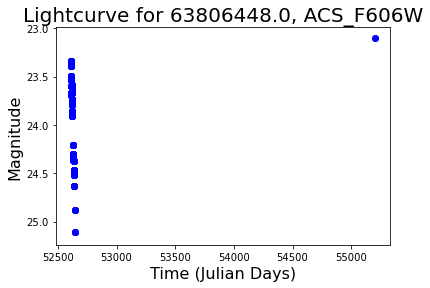

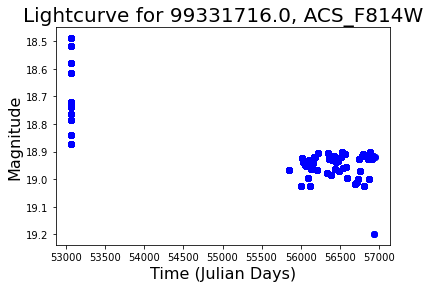

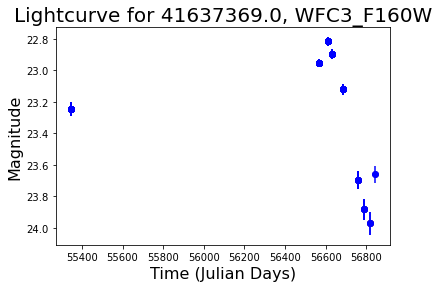

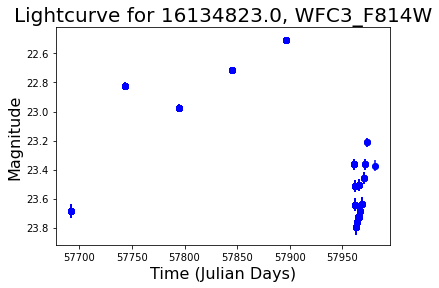

...

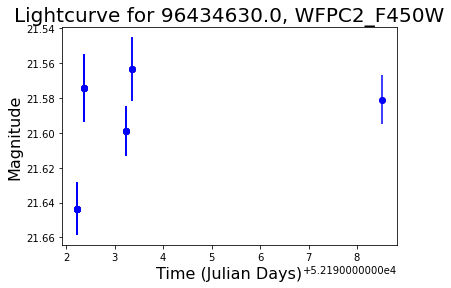

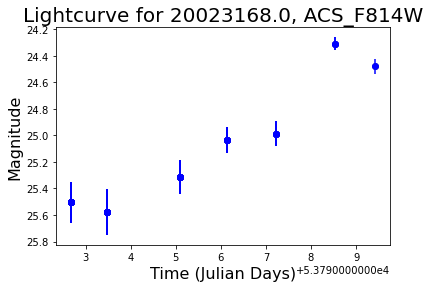

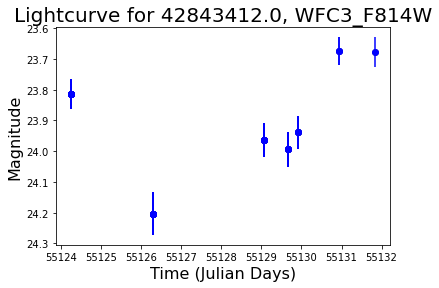

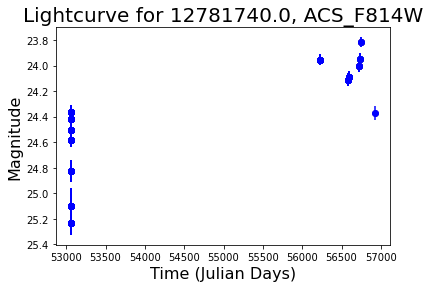

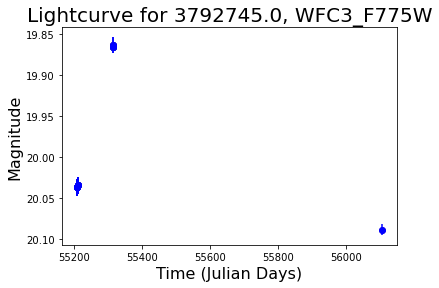

cluster:  47


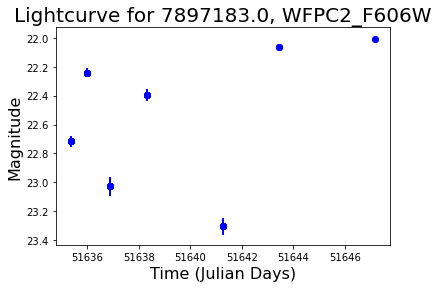

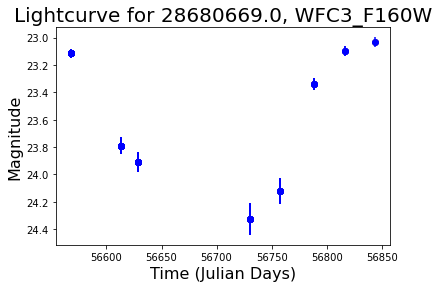

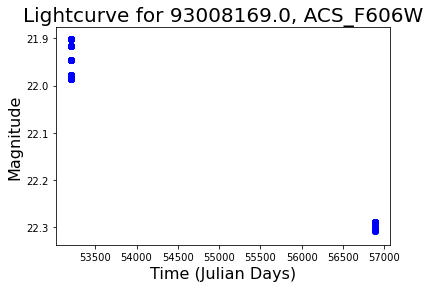

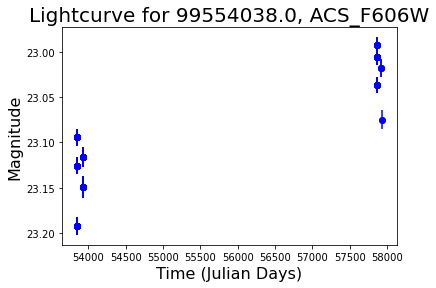

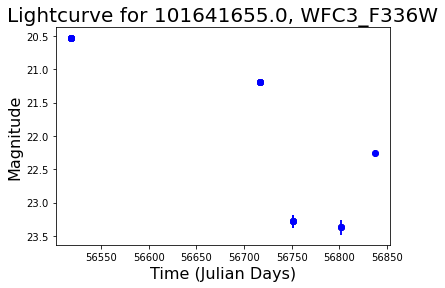

cluster:  46


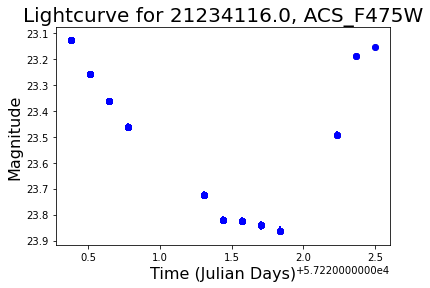

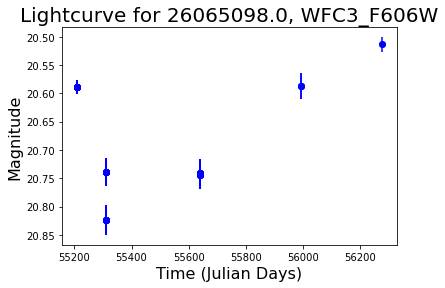

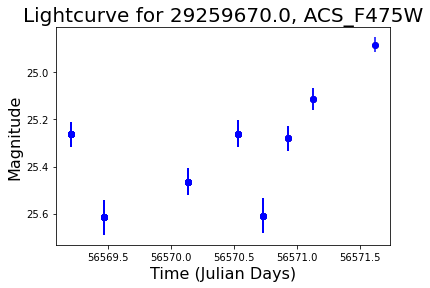

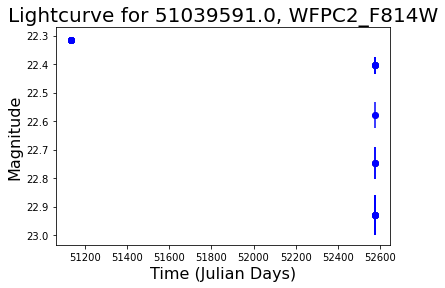

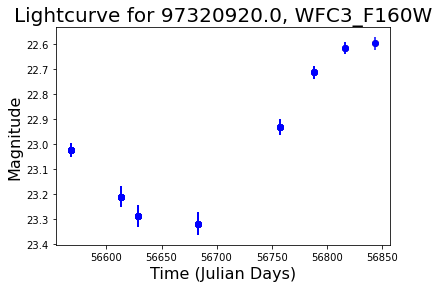

cluster:  30


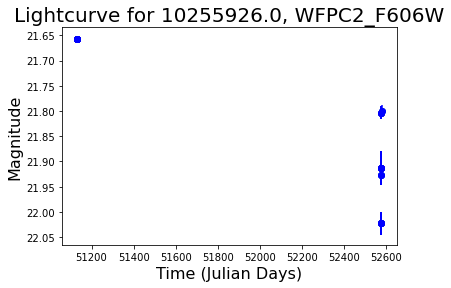

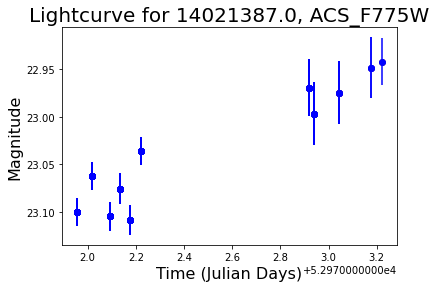

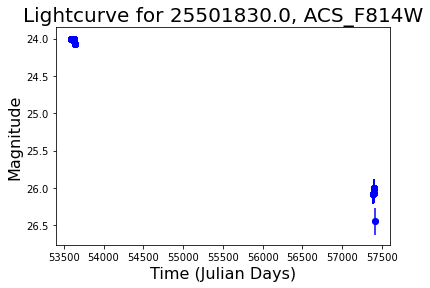

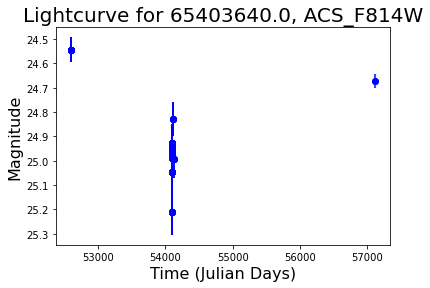

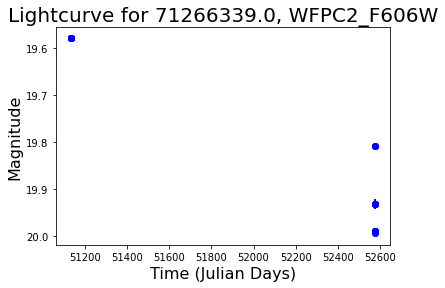

cluster:  31


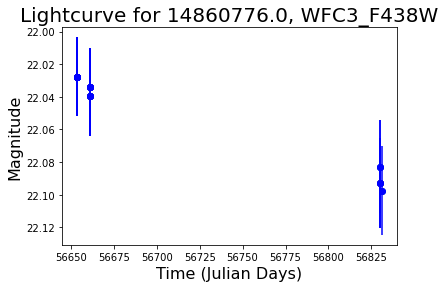

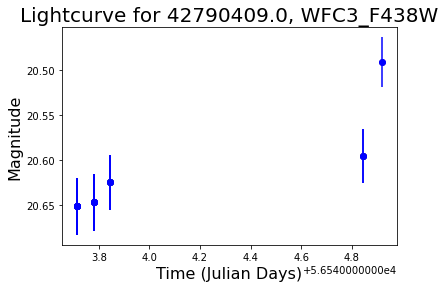

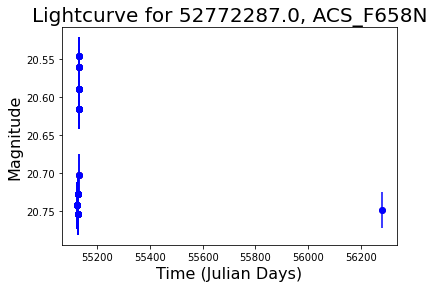

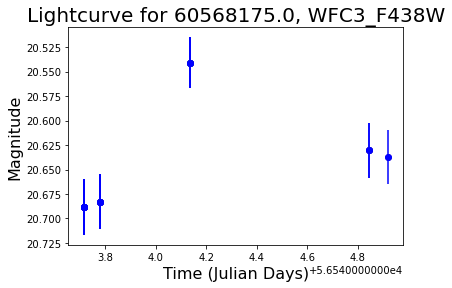

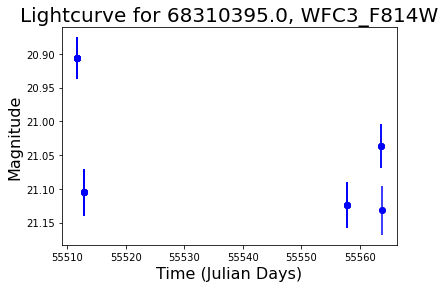

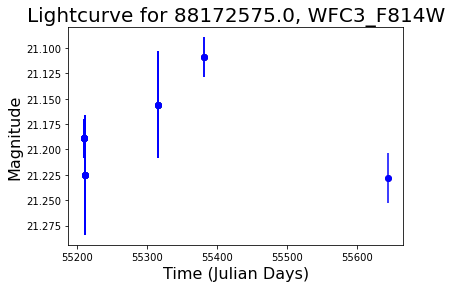

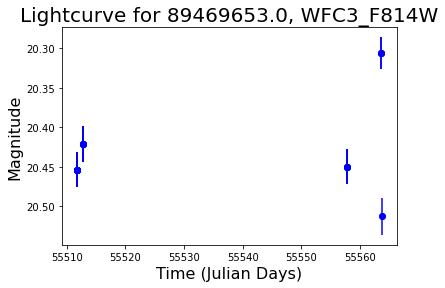

cluster:  17


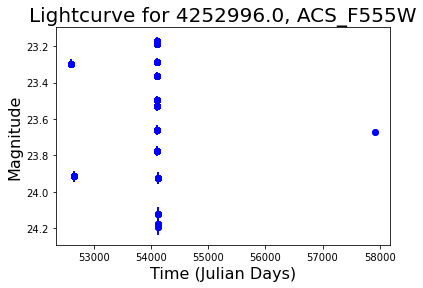

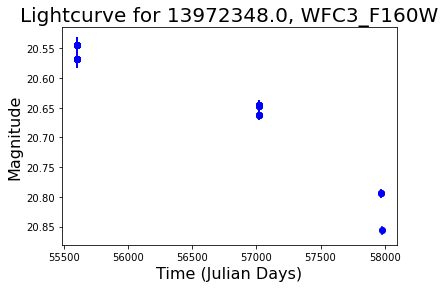

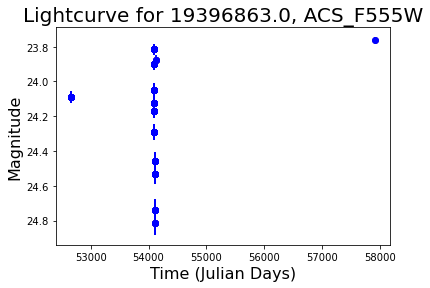

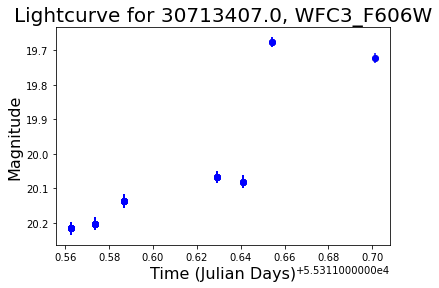

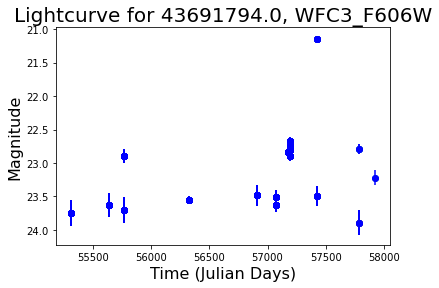

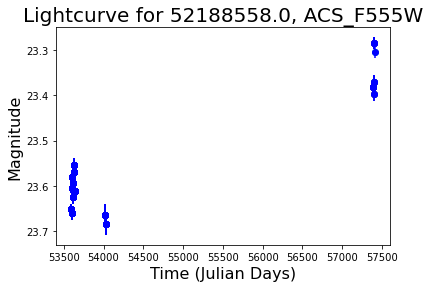

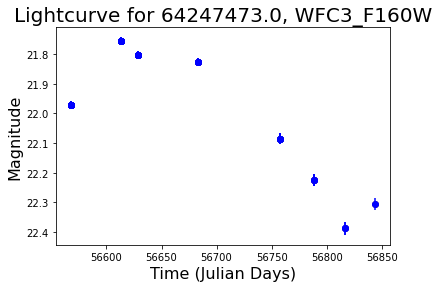

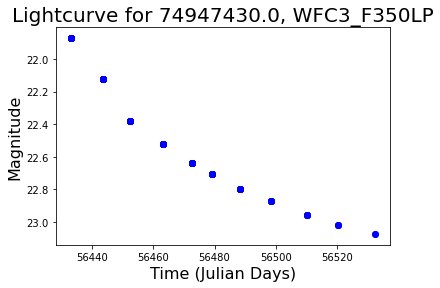

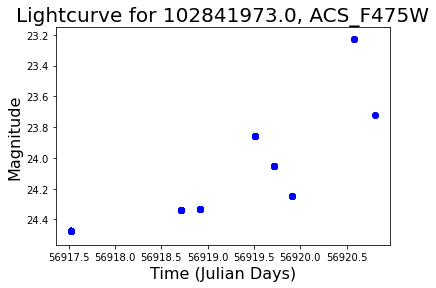

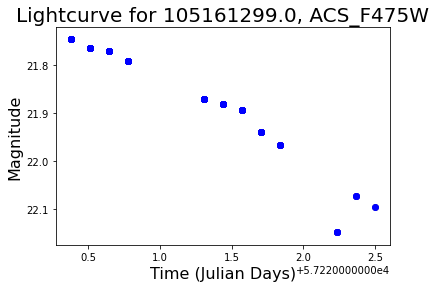

cluster:  16


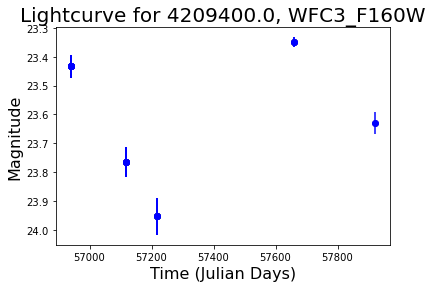

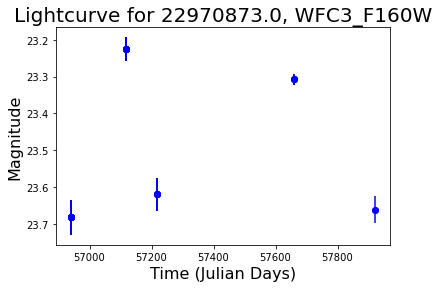

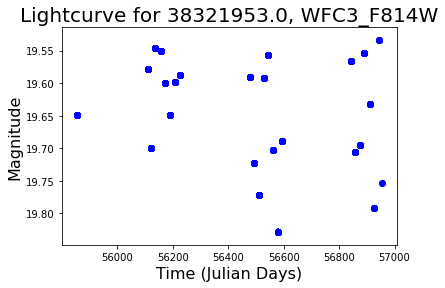

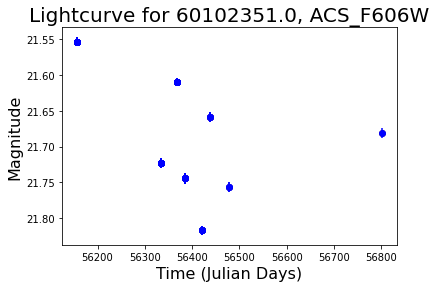

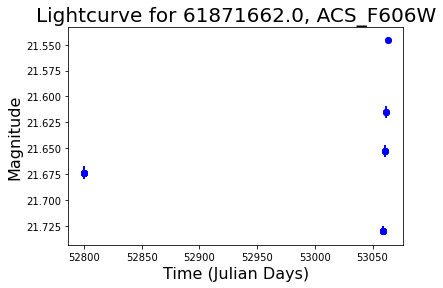

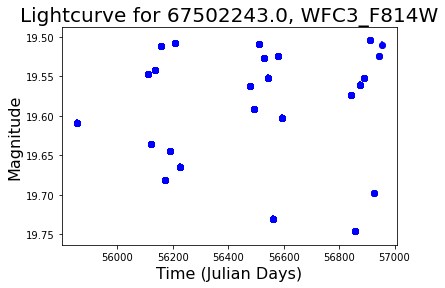

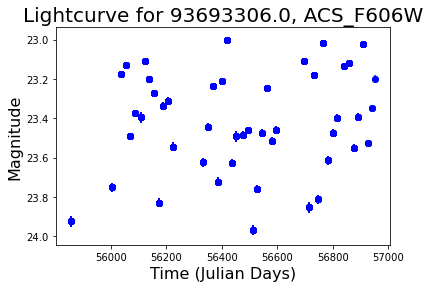

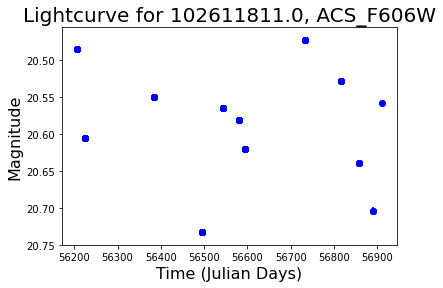

cluster:  60


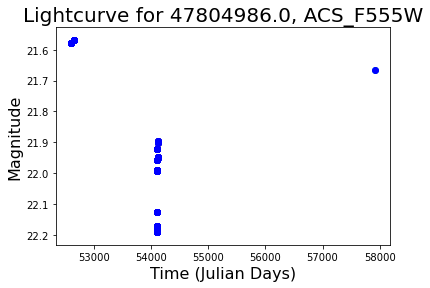

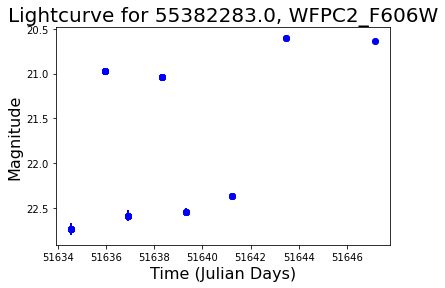

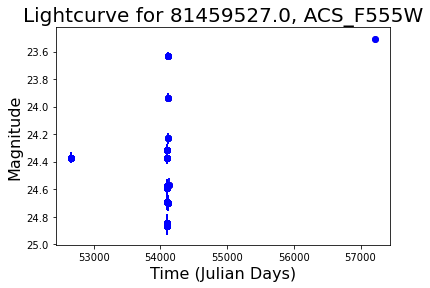

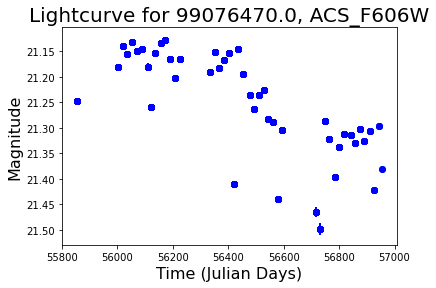

cluster:  61


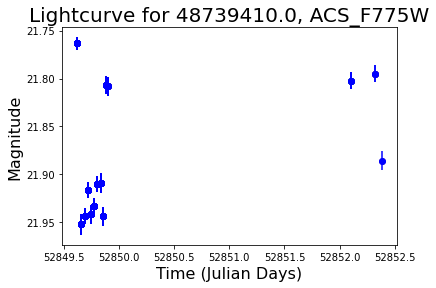

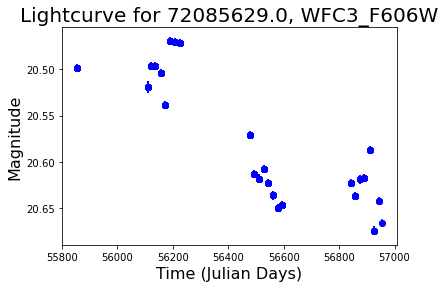

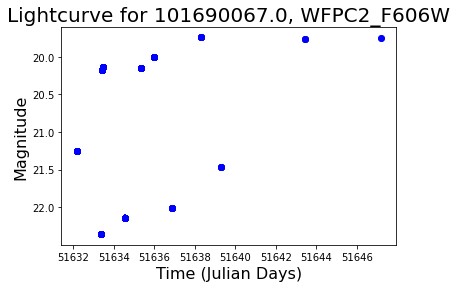

cluster:  29


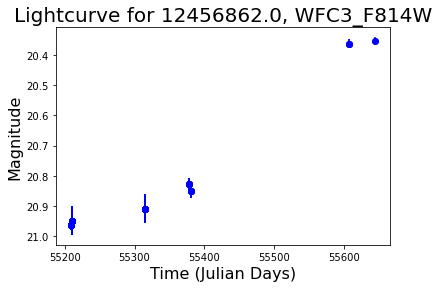

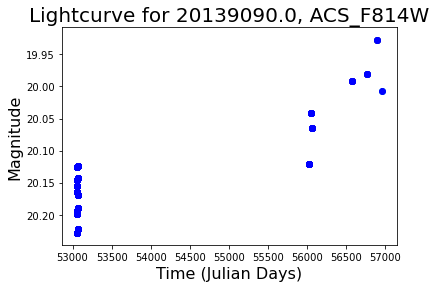

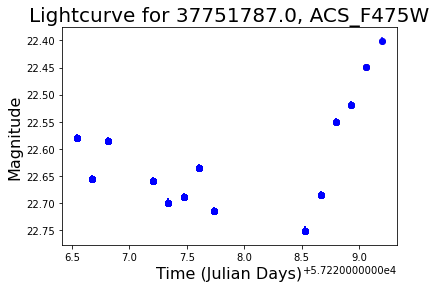

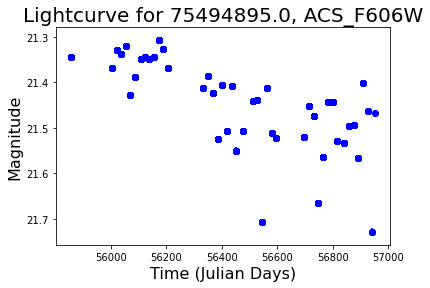

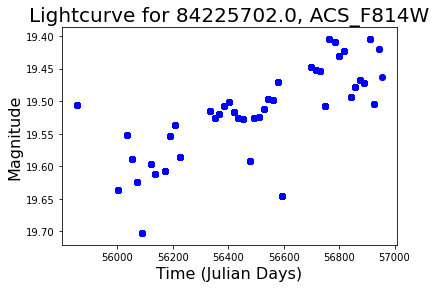

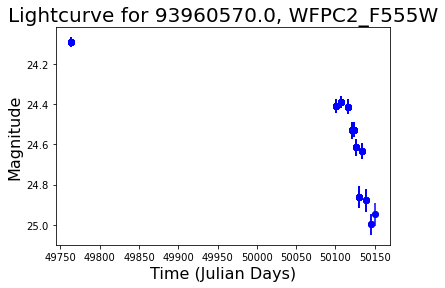

cluster:  28


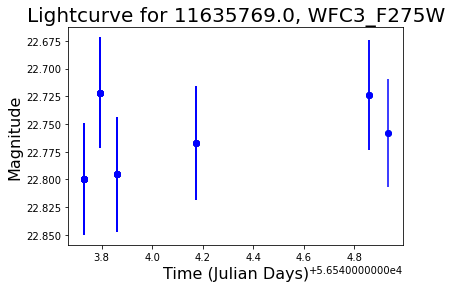

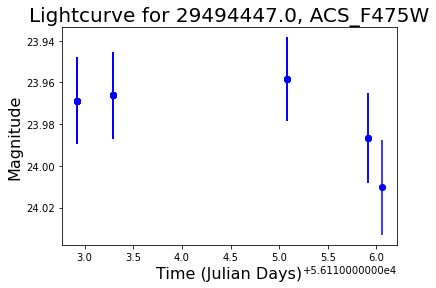

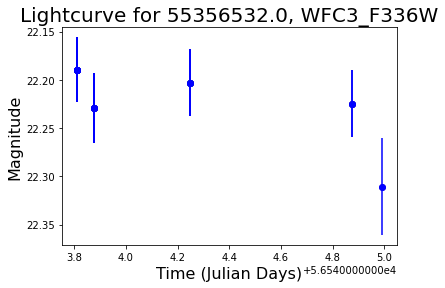

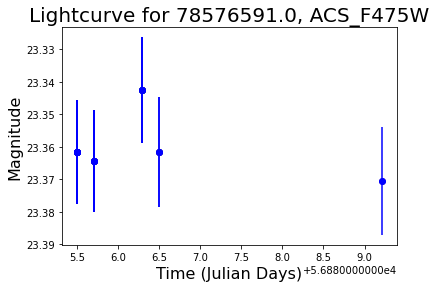

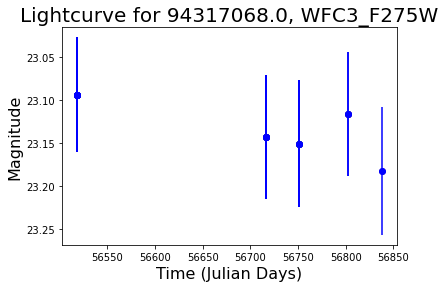

cluster:  5


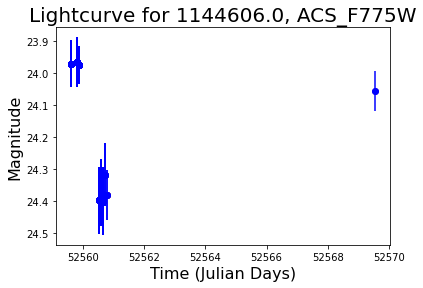

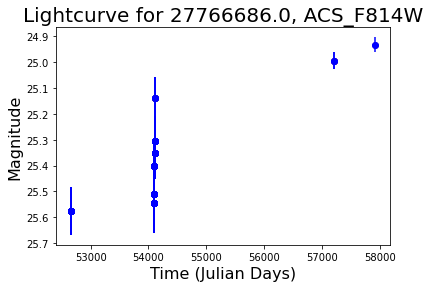

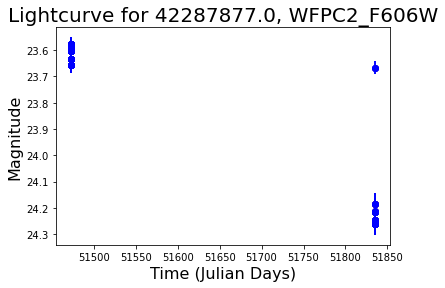

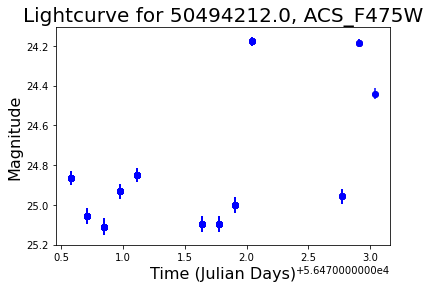

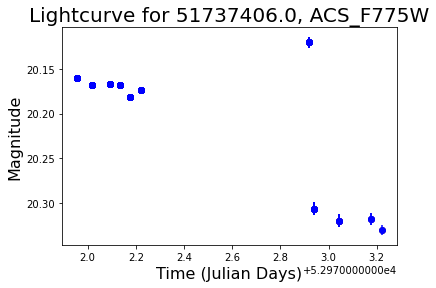

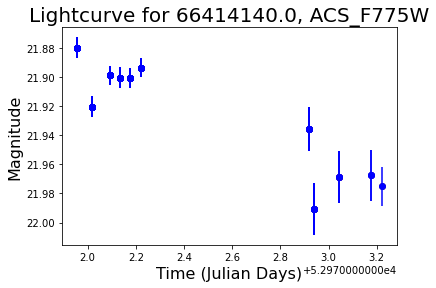

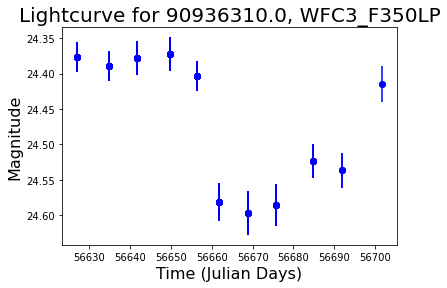

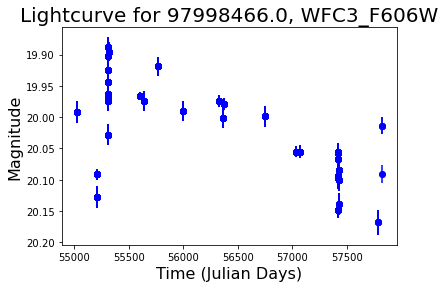

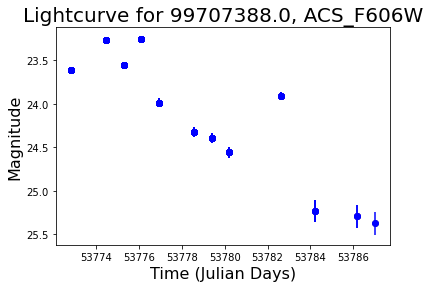

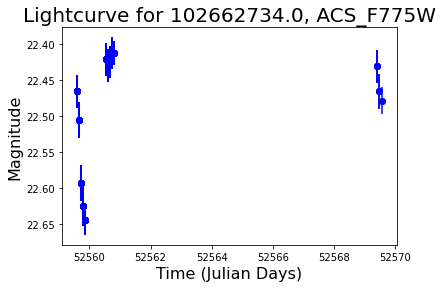

cluster:  4


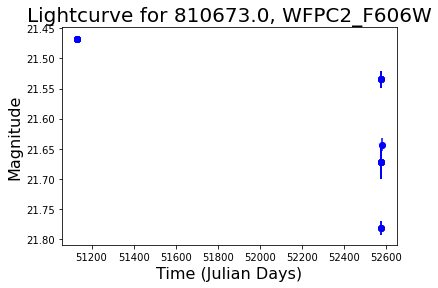

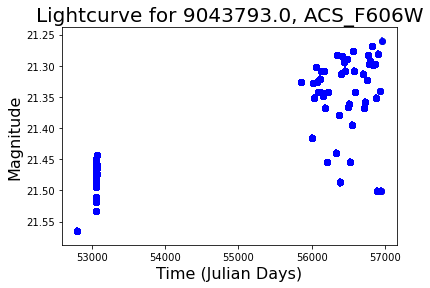

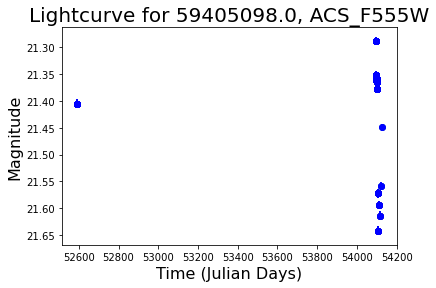

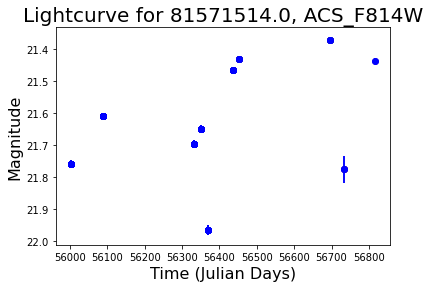

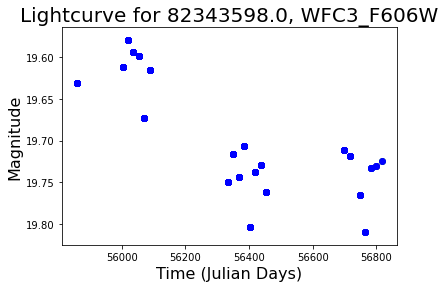

cluster:  54


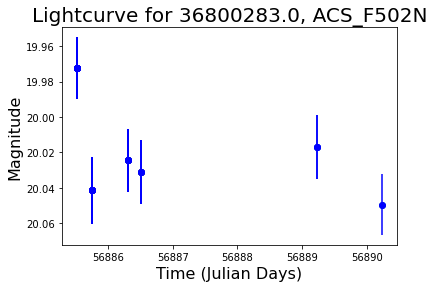

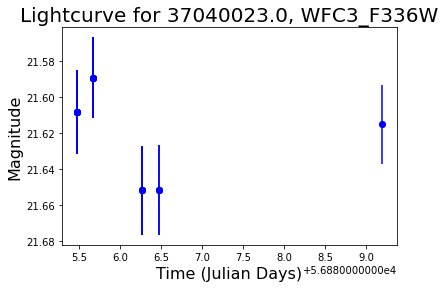

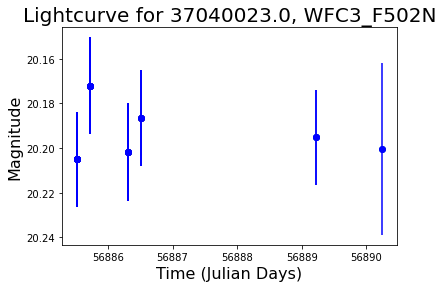

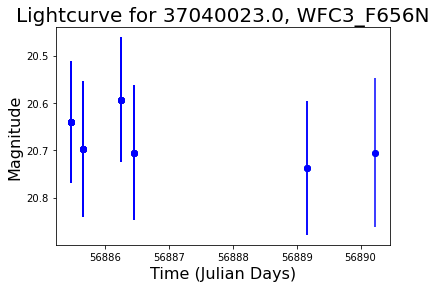

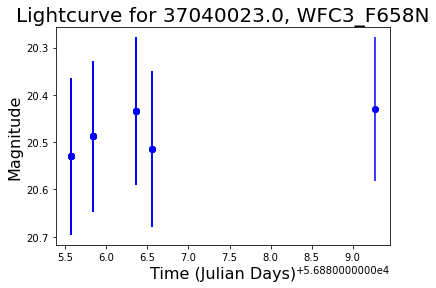

...

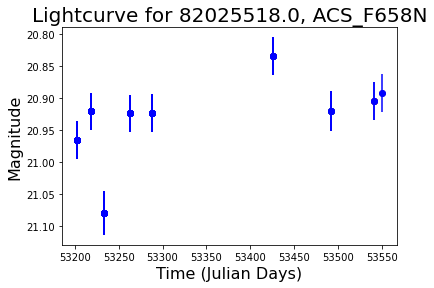

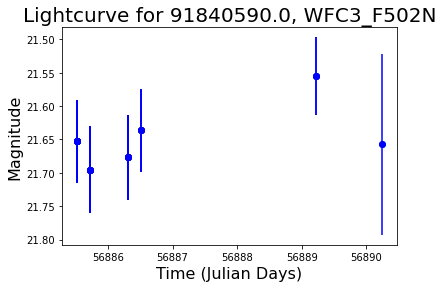

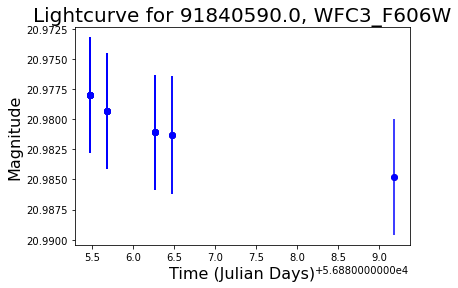

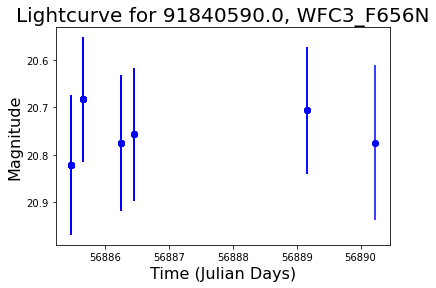

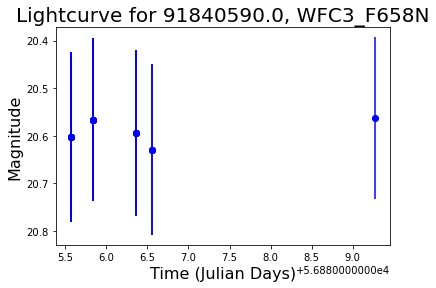

cluster:  55


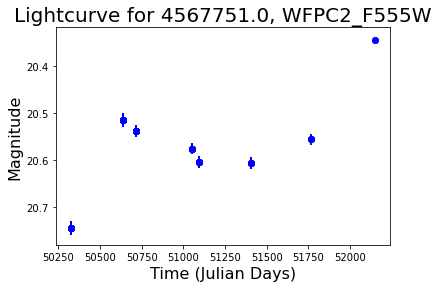

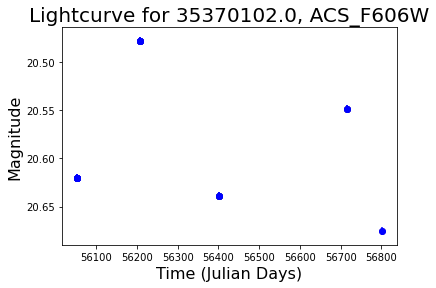

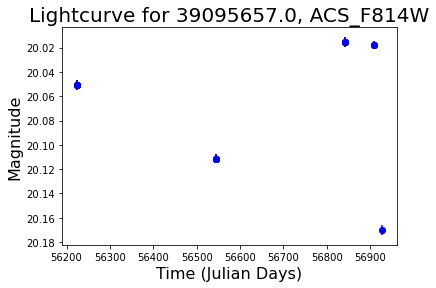

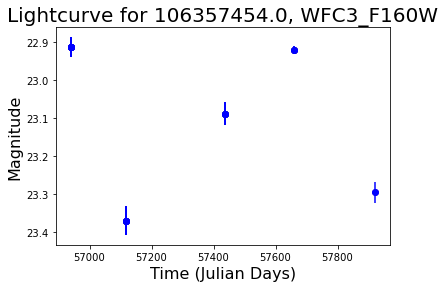

cluster:  23


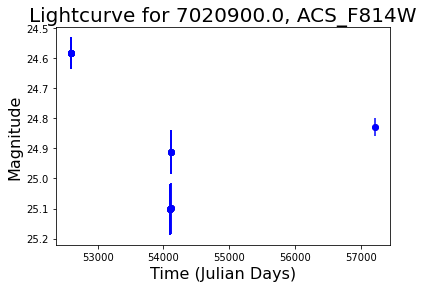

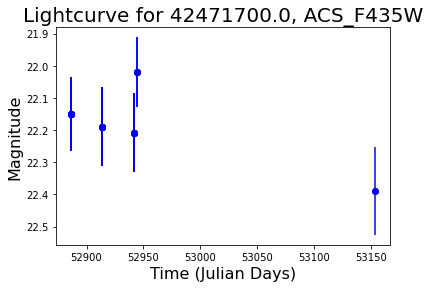

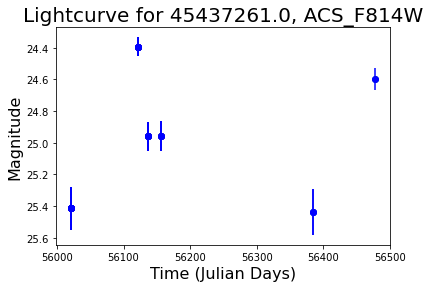

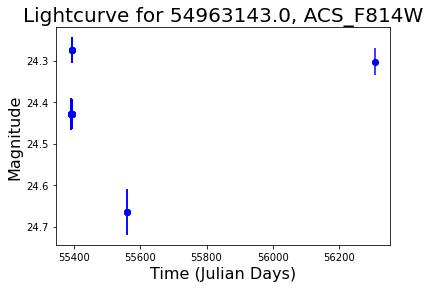

cluster:  22


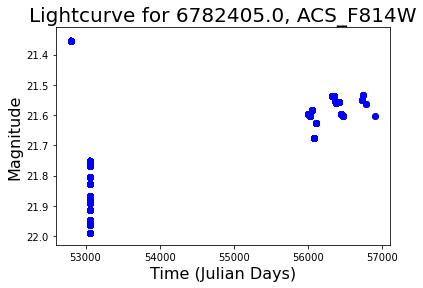

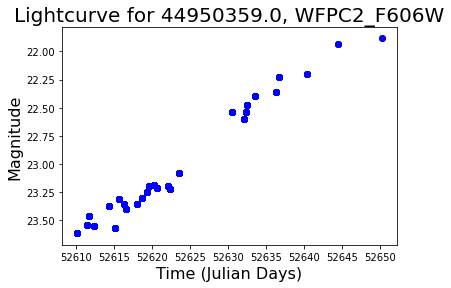

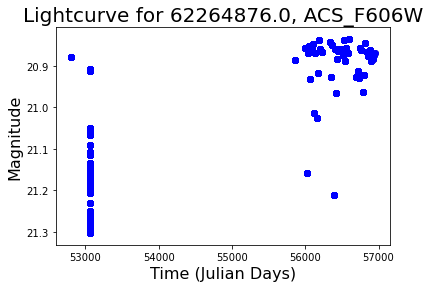

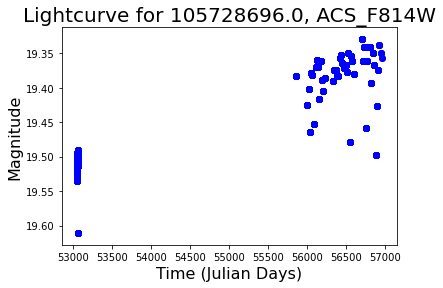

cluster:  49


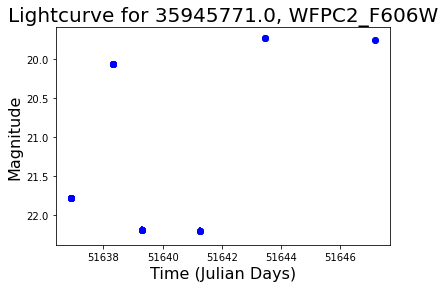

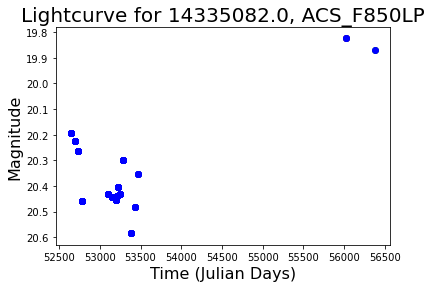

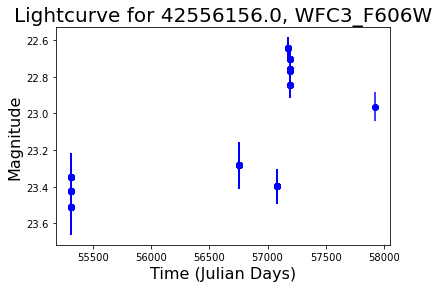

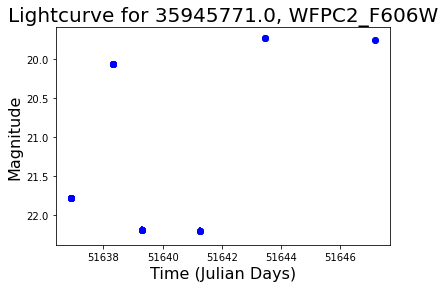

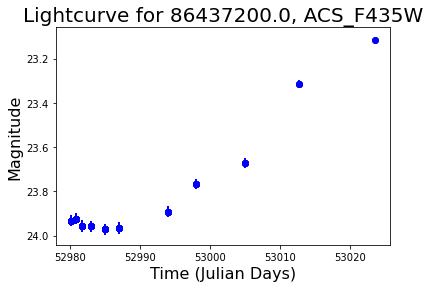

...

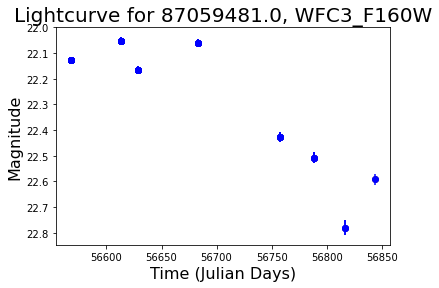

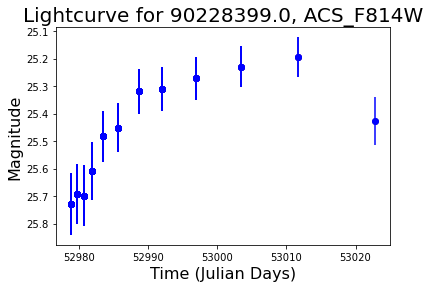

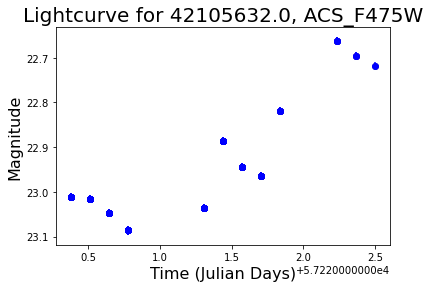

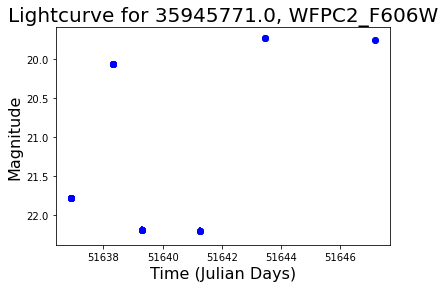

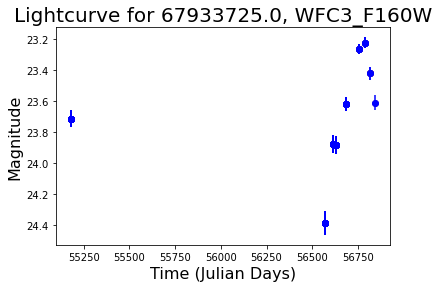

cluster:  48


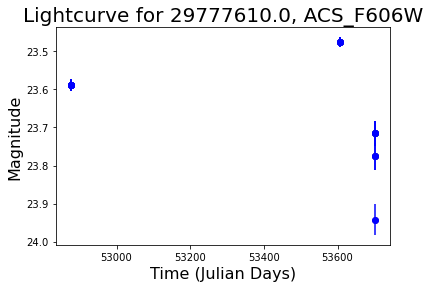

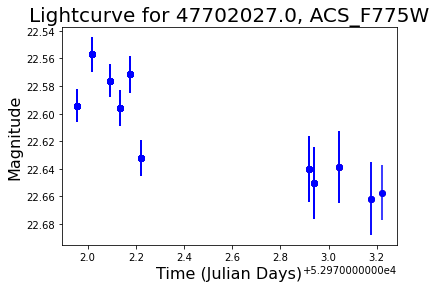

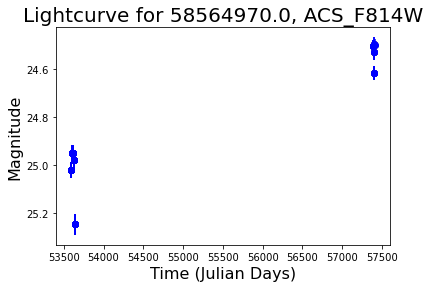

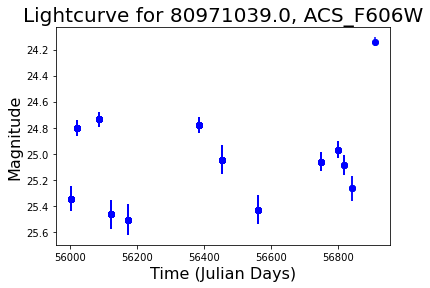

cluster:  43


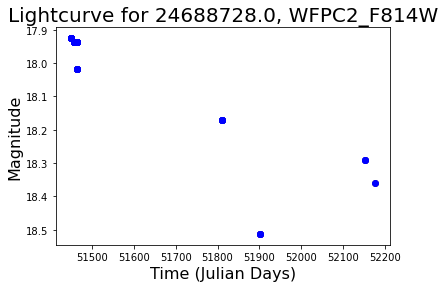

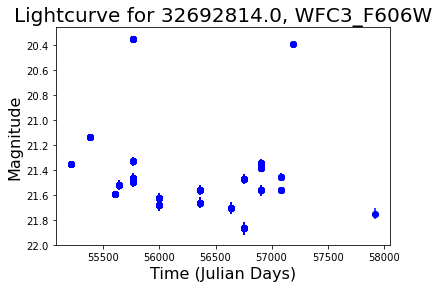

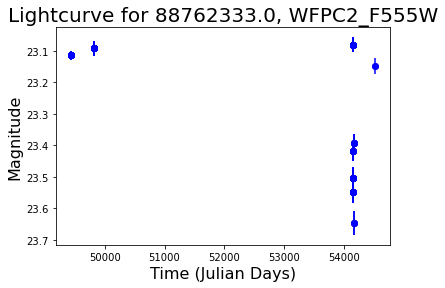

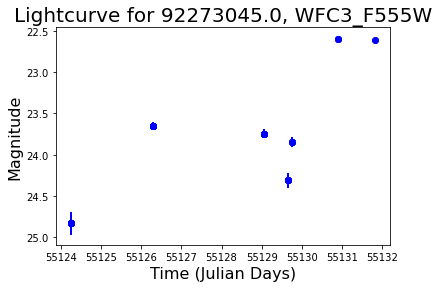

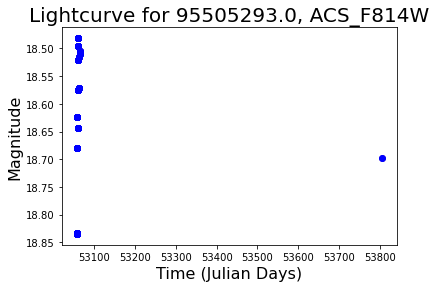

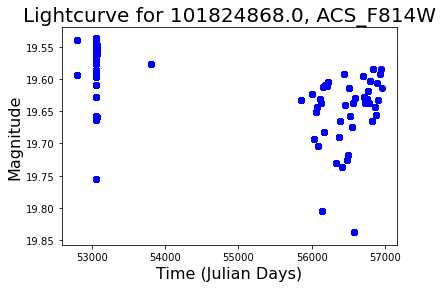

cluster:  42


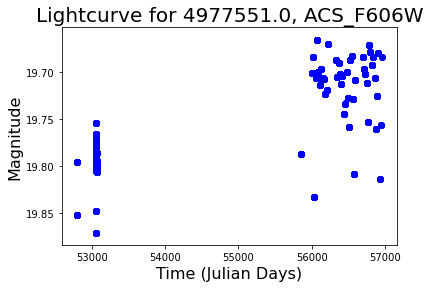

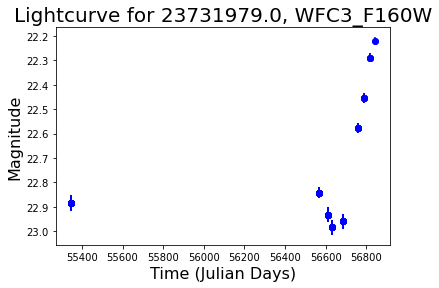

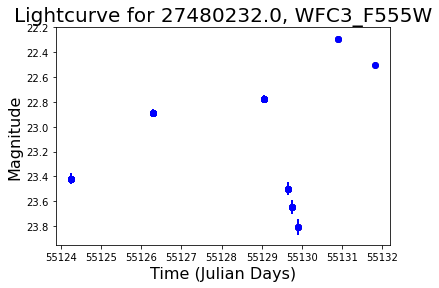

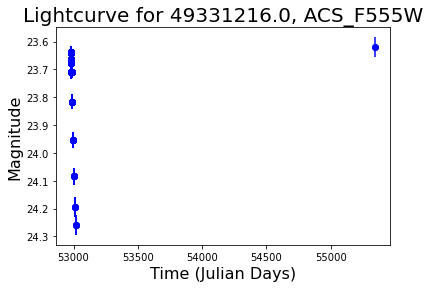

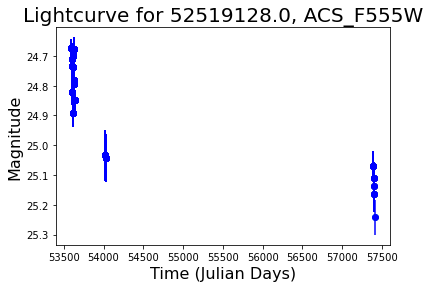

...

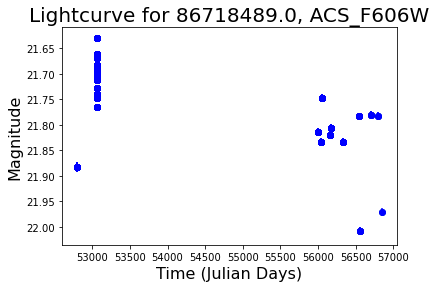

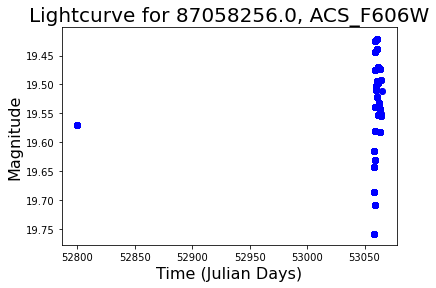

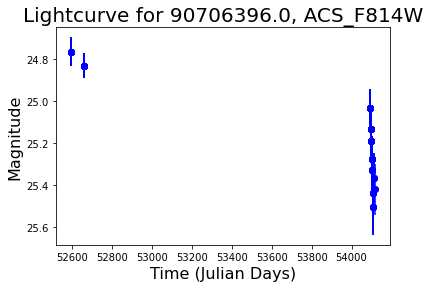

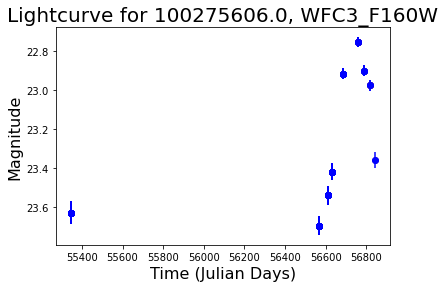

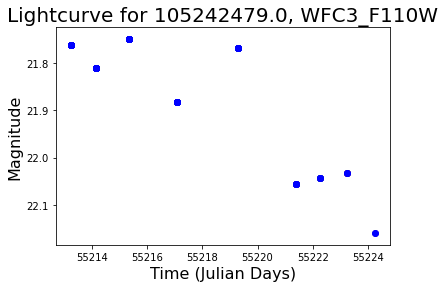

cluster:  34


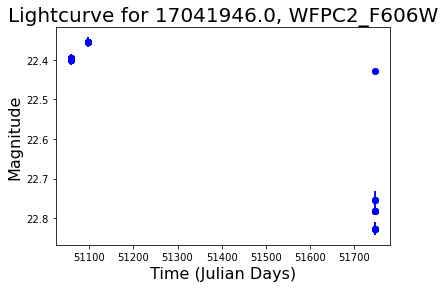

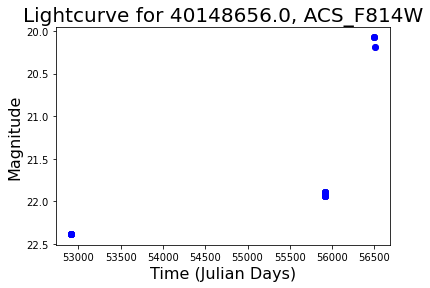

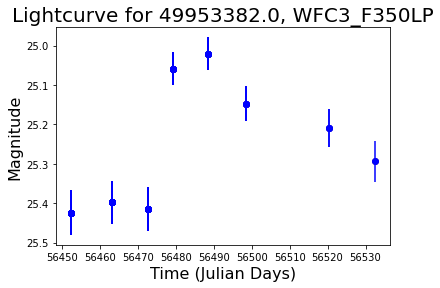

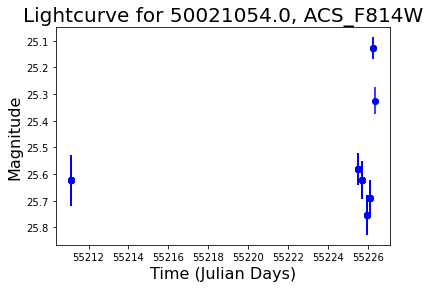

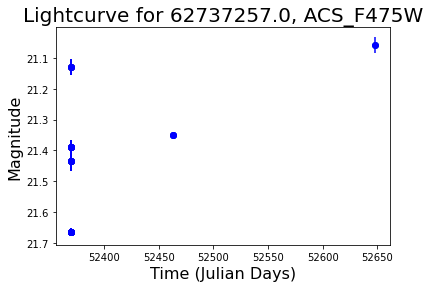

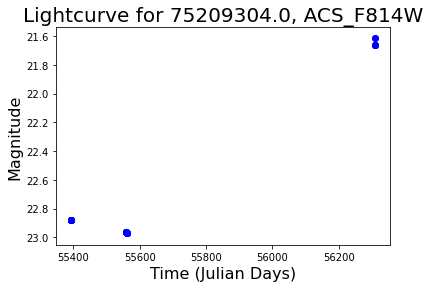

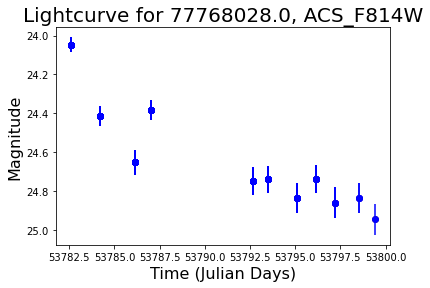

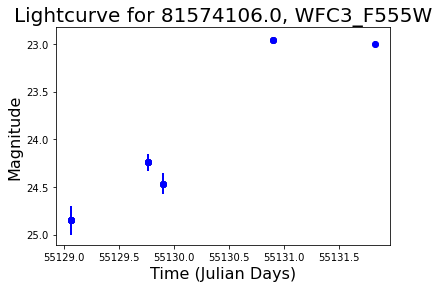

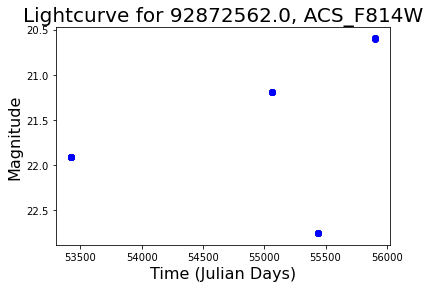

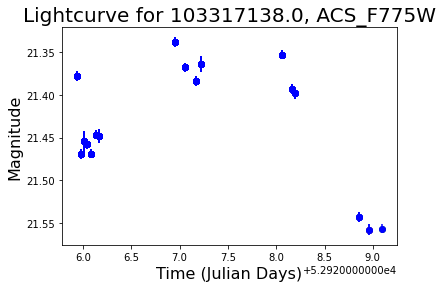

cluster:  35


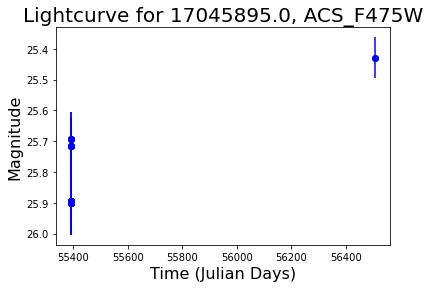

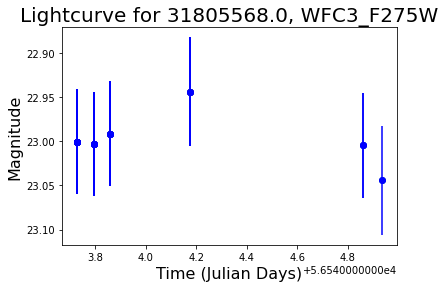

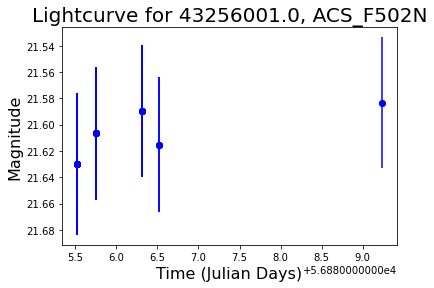

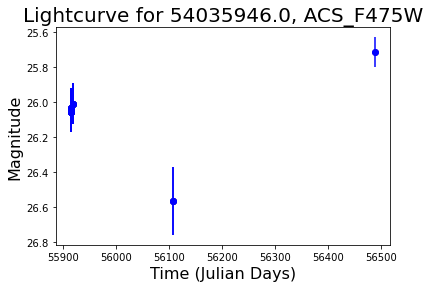

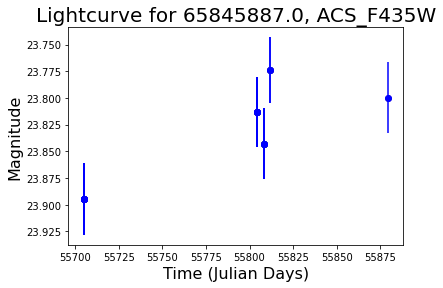

cluster:  39


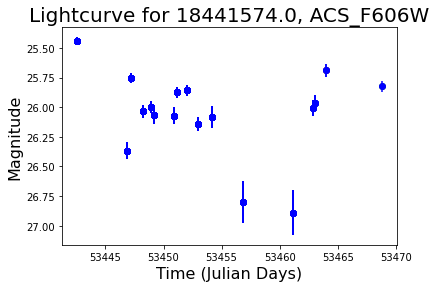

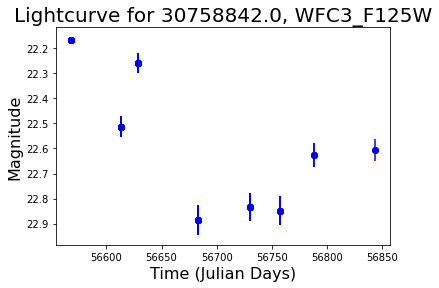

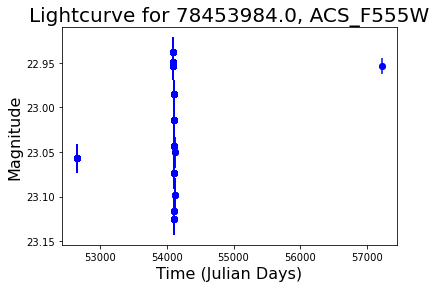

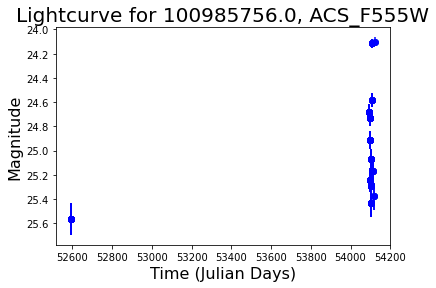

cluster:  38


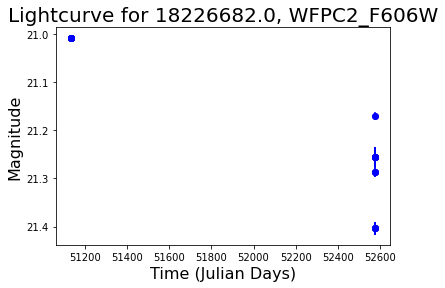

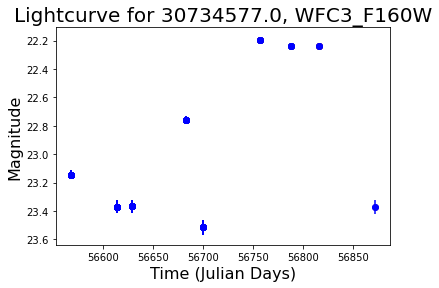

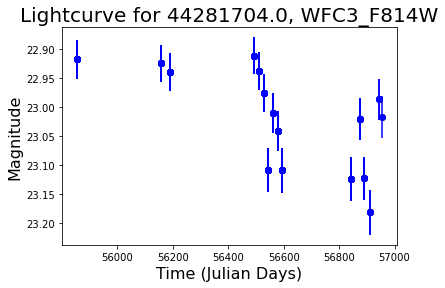

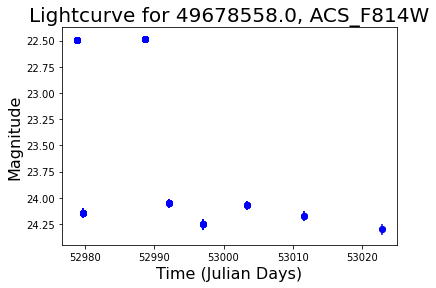

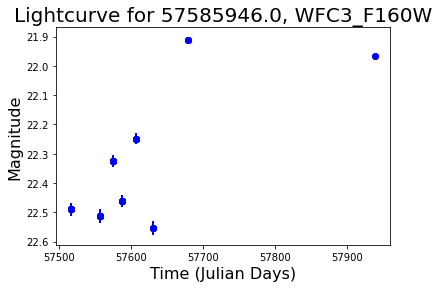

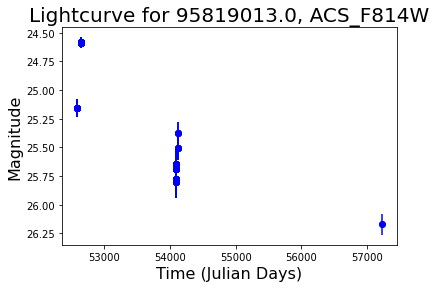

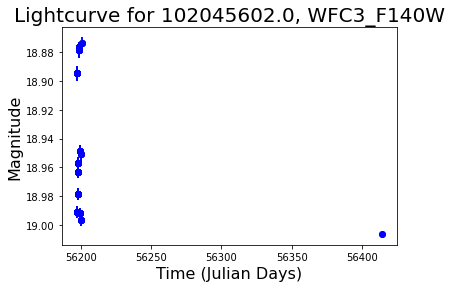

cluster:  44


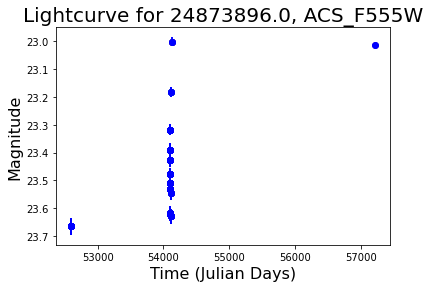

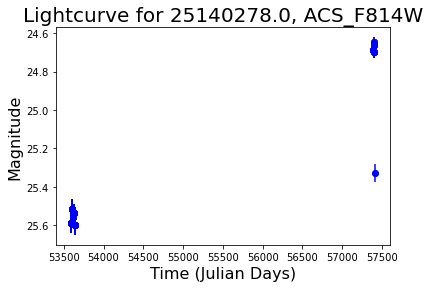

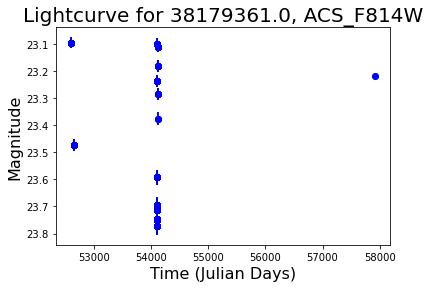

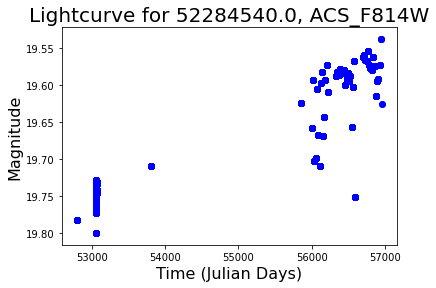

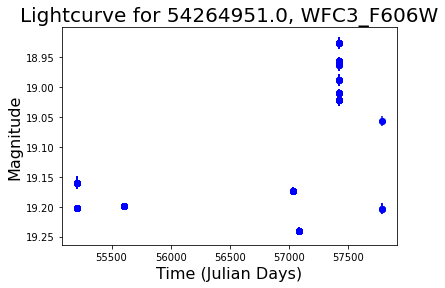

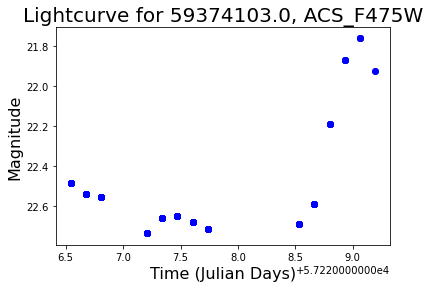

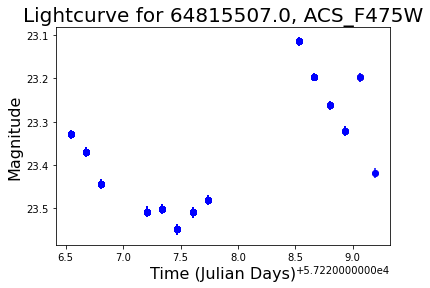

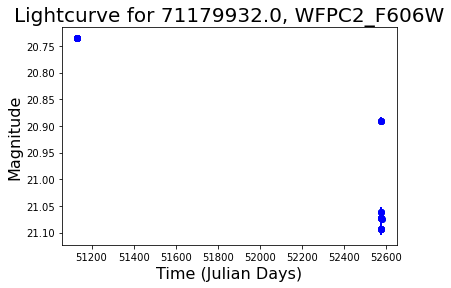

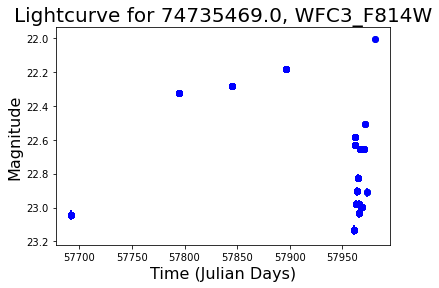

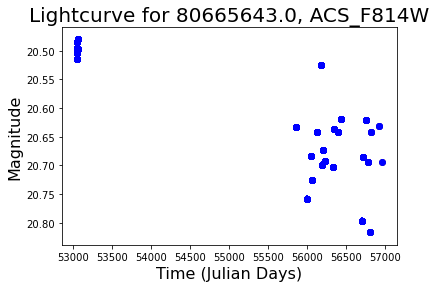

cluster:  45


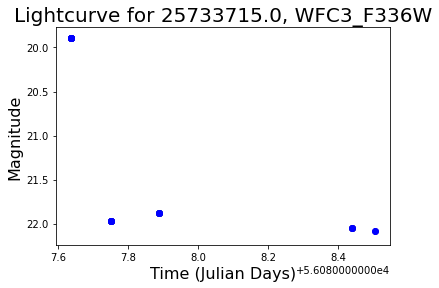

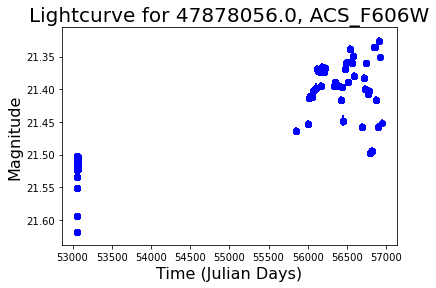

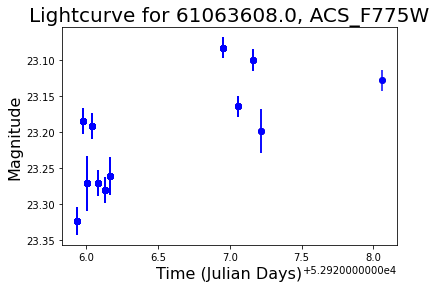

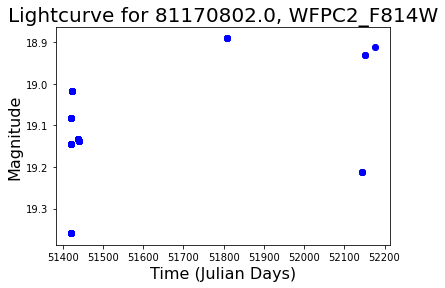

cluster:  33


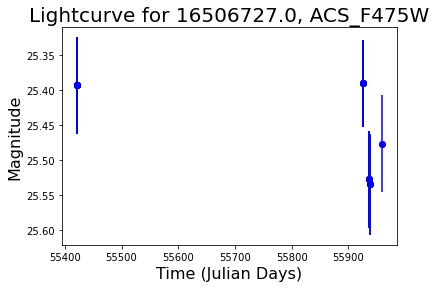

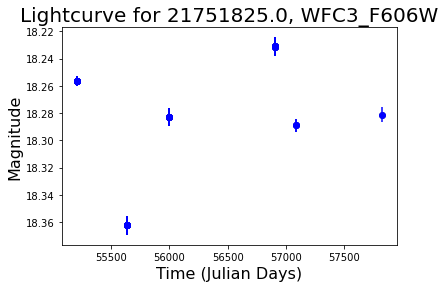

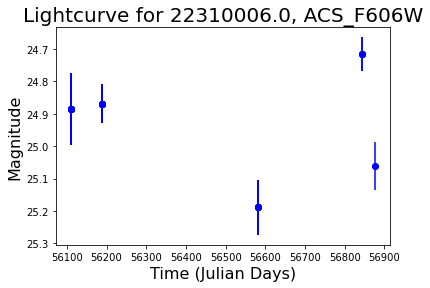

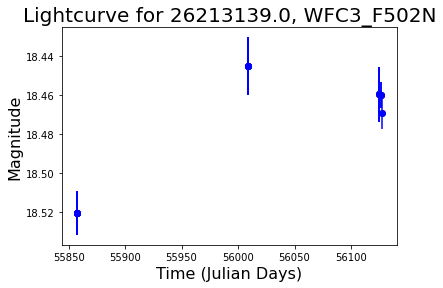

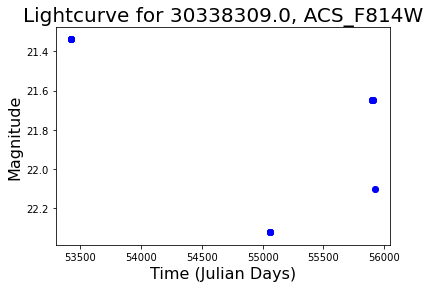

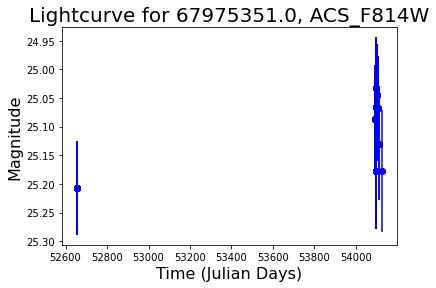

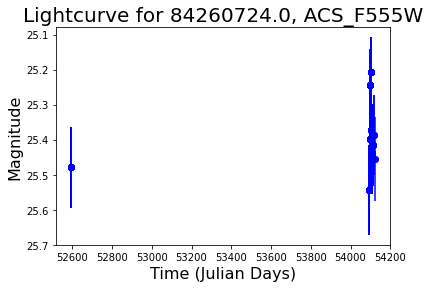

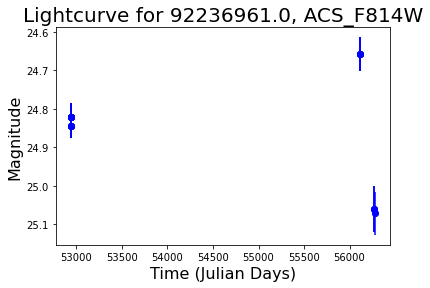

cluster:  32


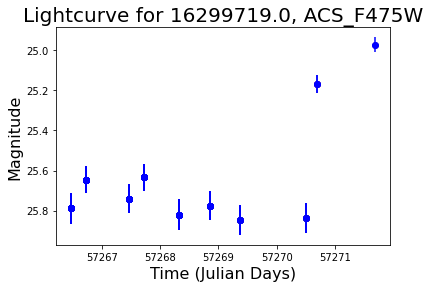

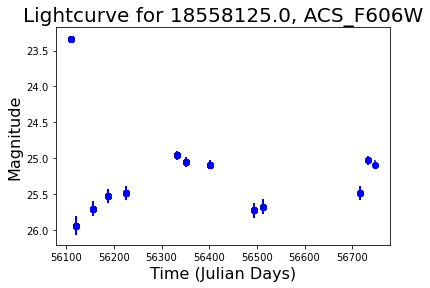

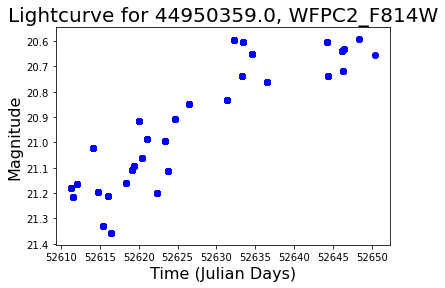

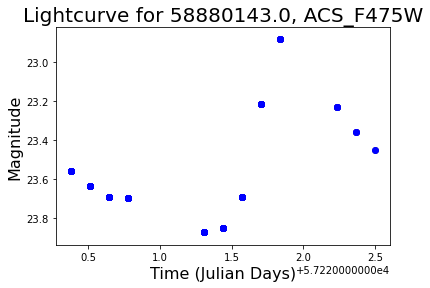

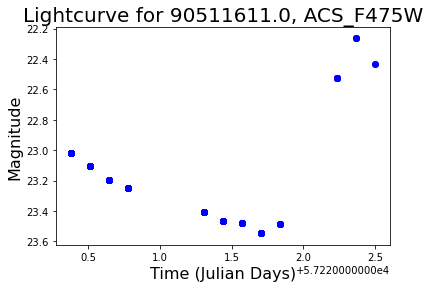

cluster:  8


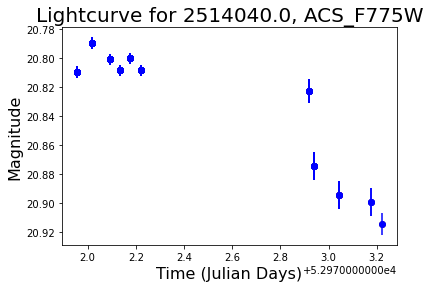

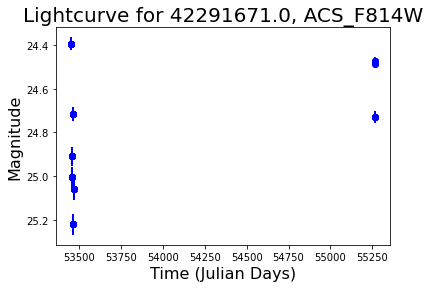

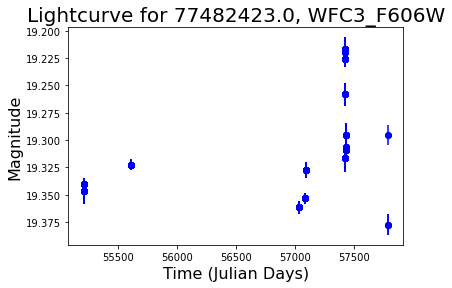

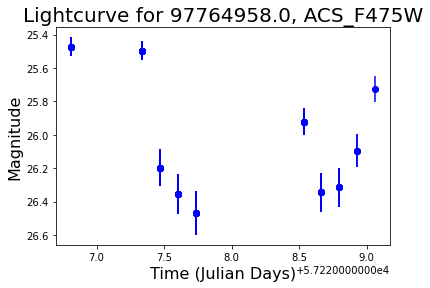

cluster:  9


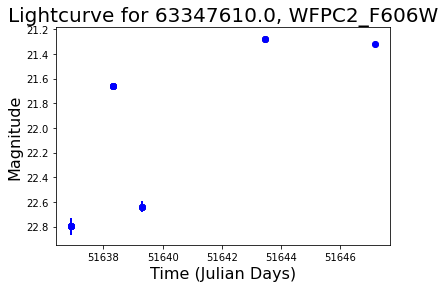

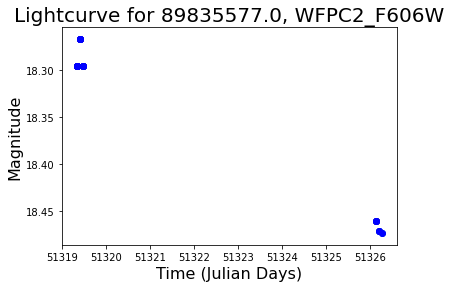

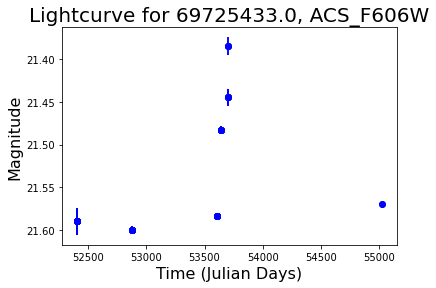

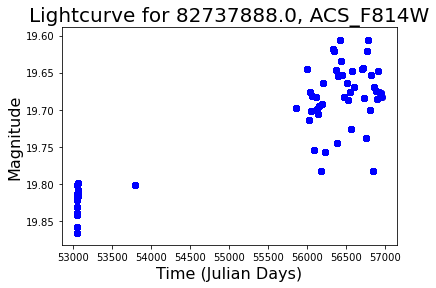

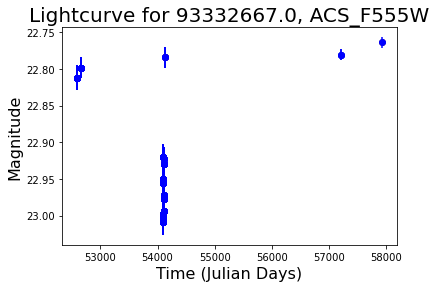

...

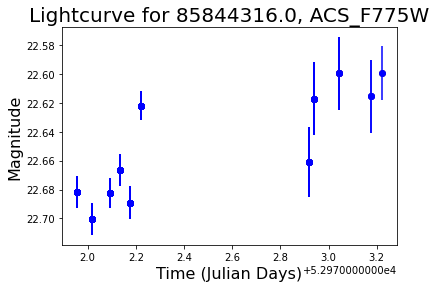

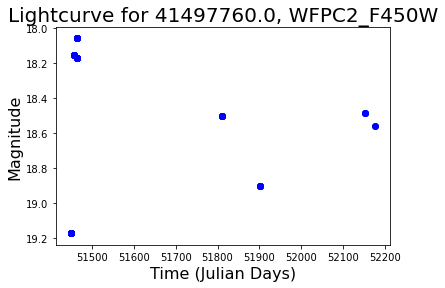

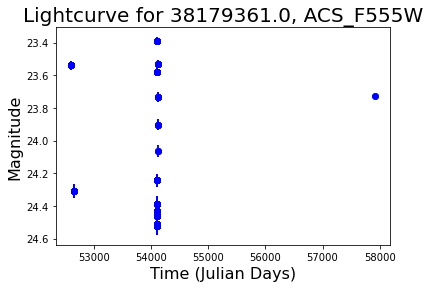

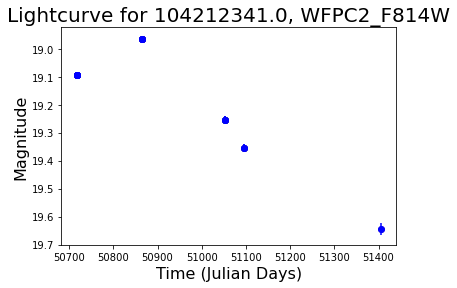

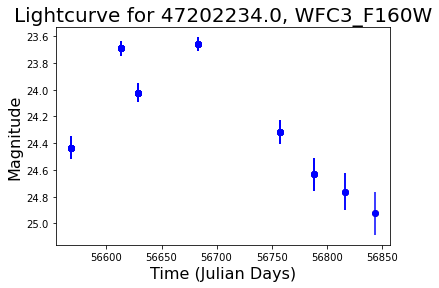

cluster:  59


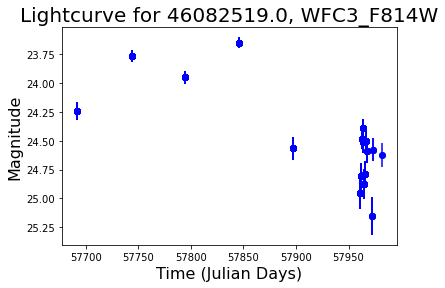

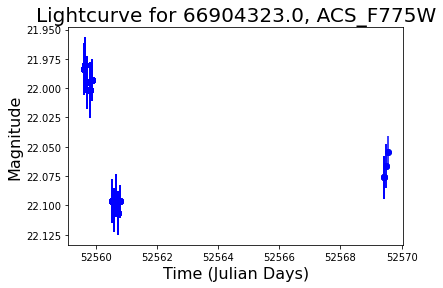

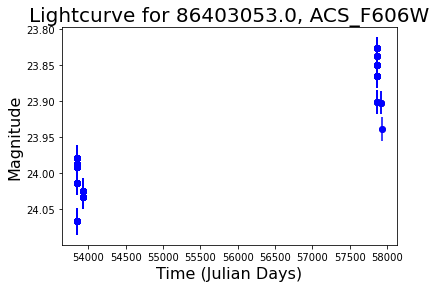

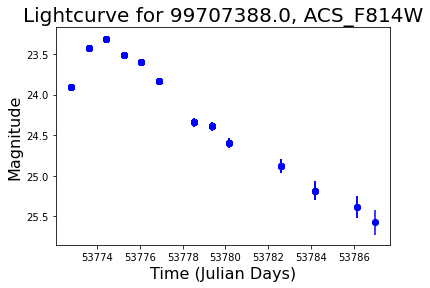

cluster:  58


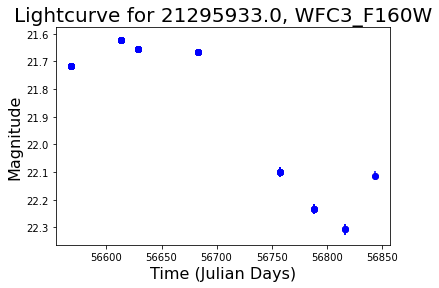

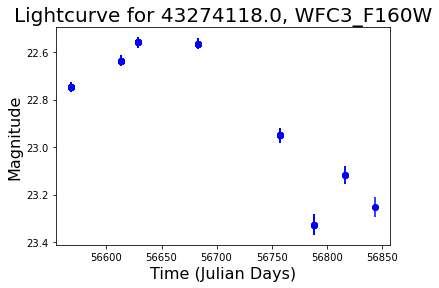

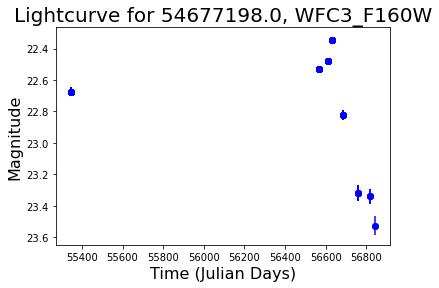

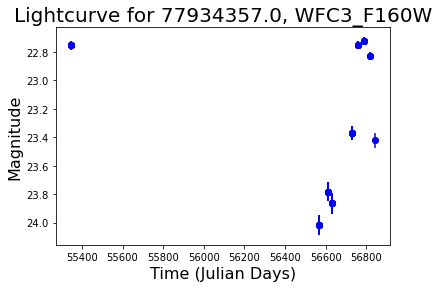

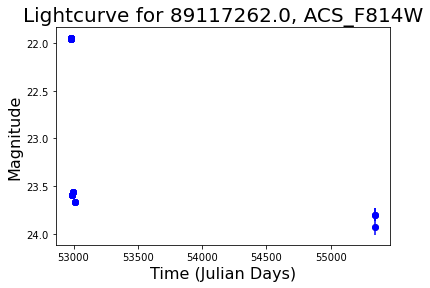

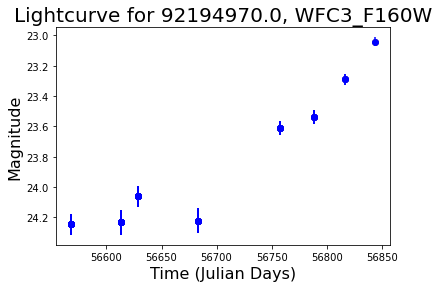

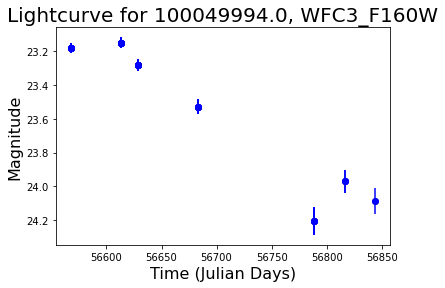

cluster:  10


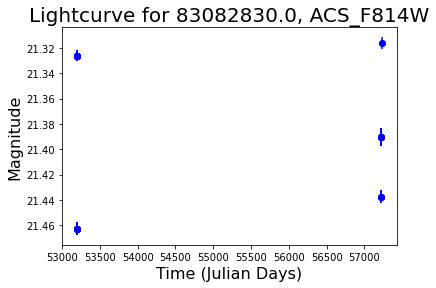

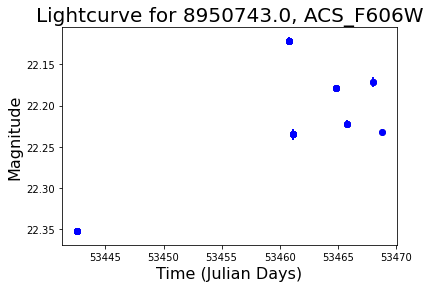

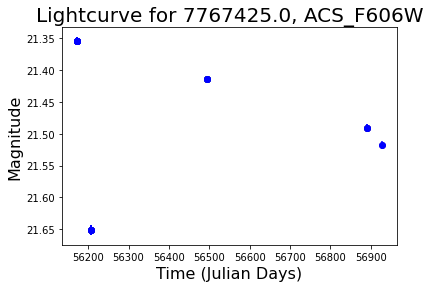

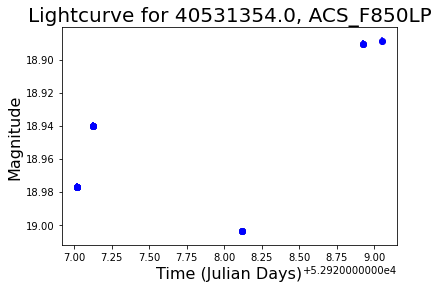

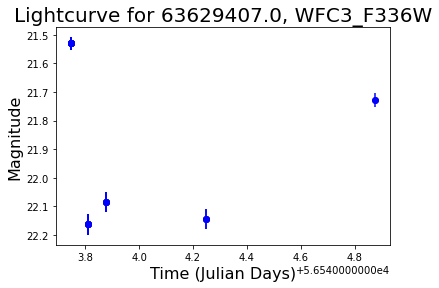

...

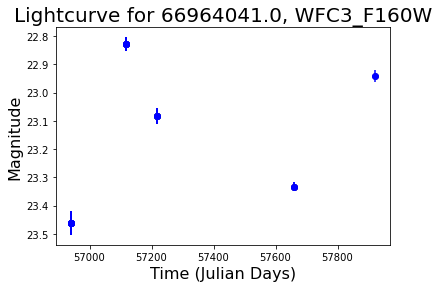

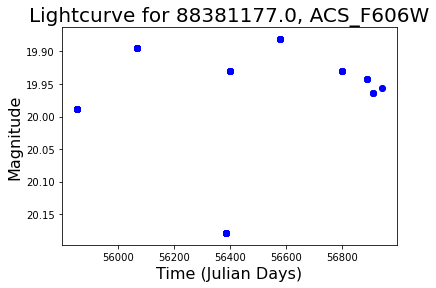

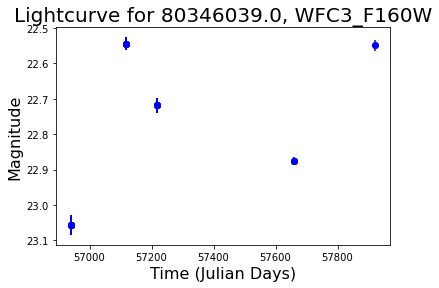

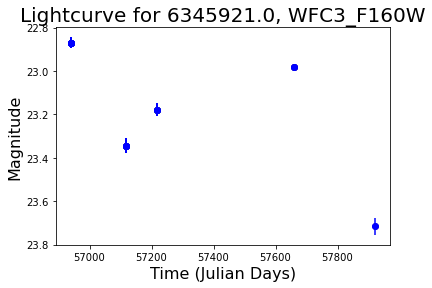

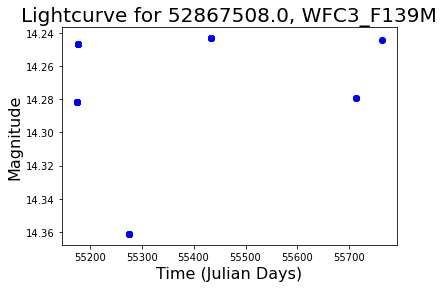

cluster:  11


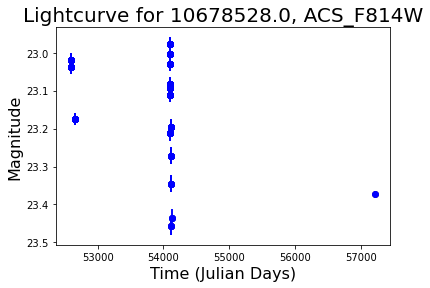

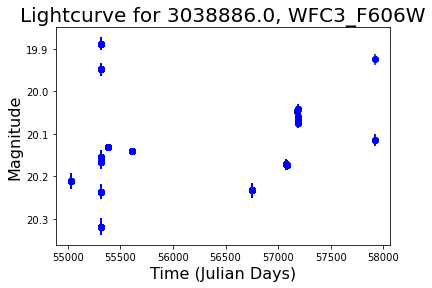

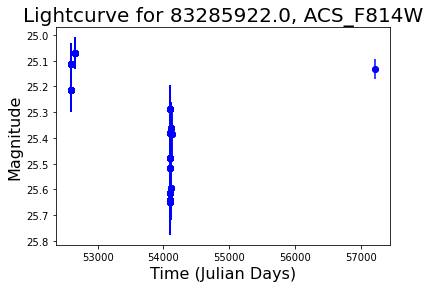

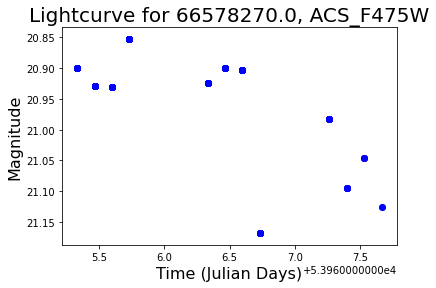

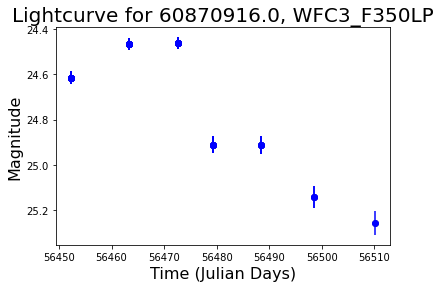

...

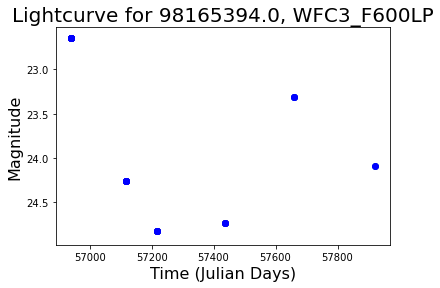

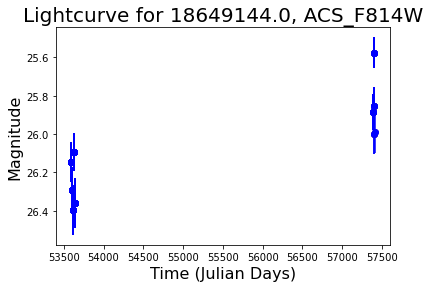

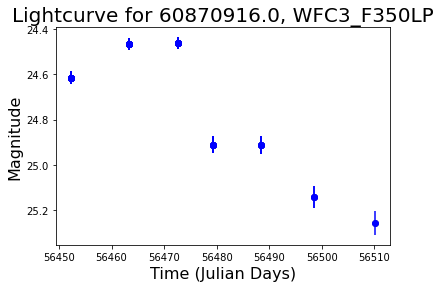

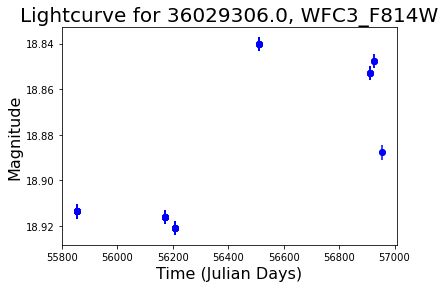

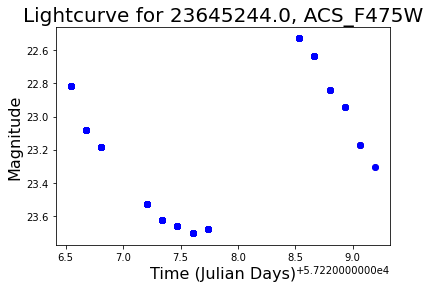

cluster:  67


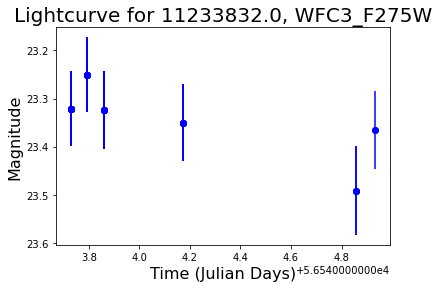

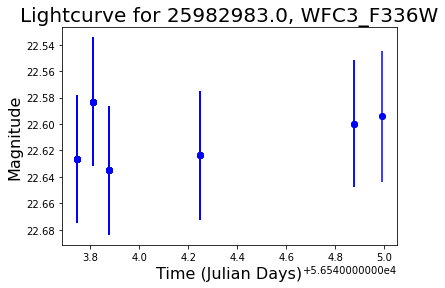

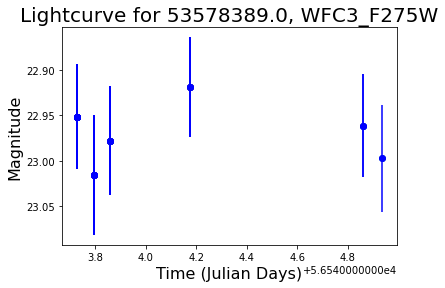

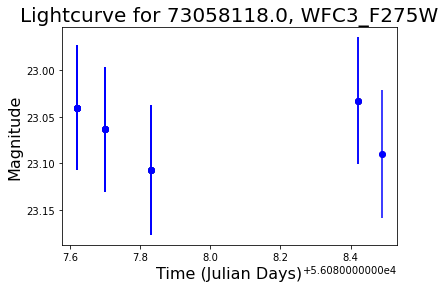

cluster:  66


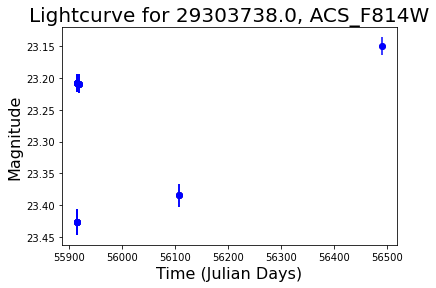

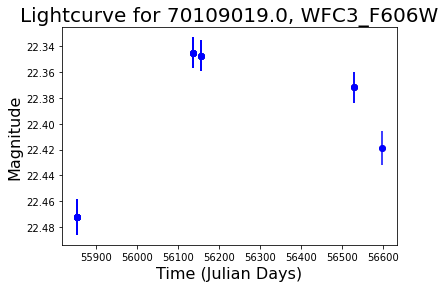

cluster:  53


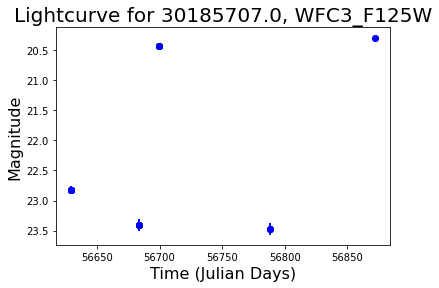

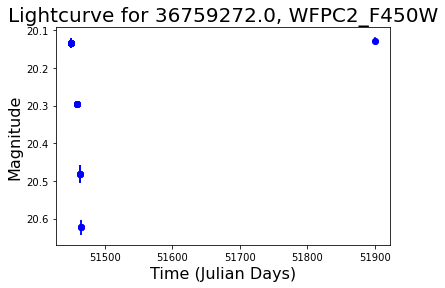

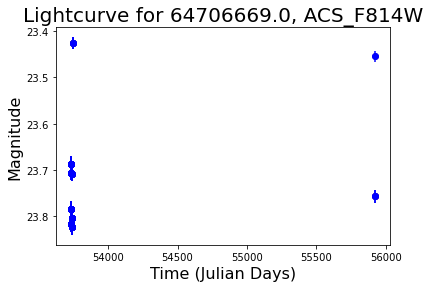

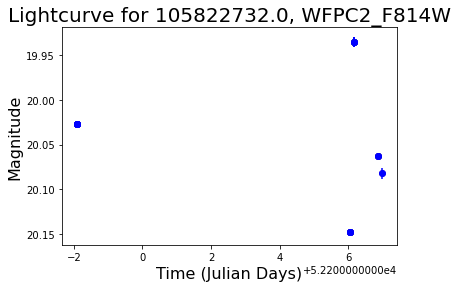

cluster:  52


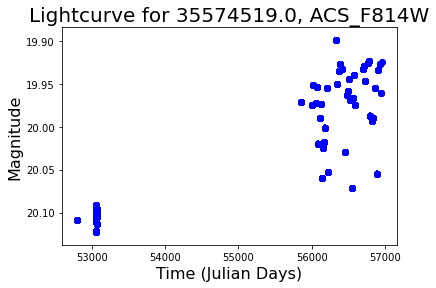

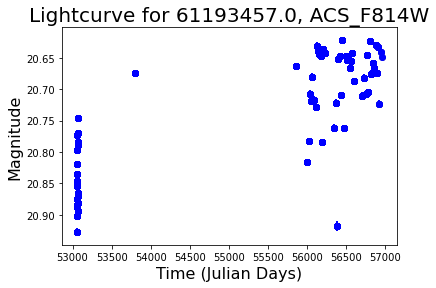

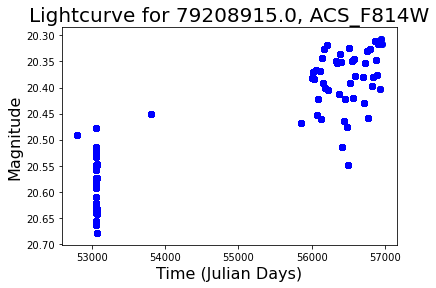

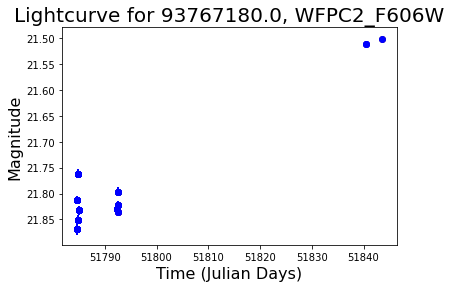

cluster:  2


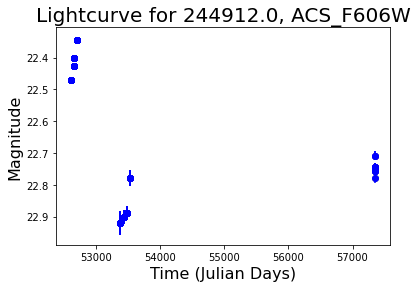

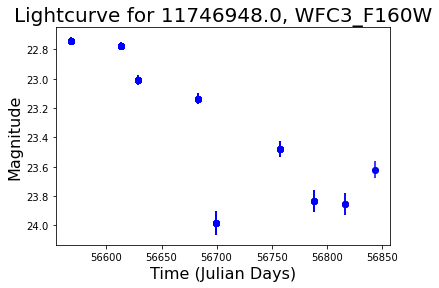

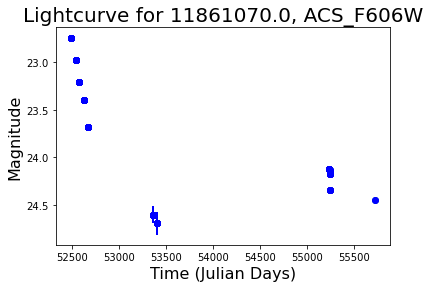

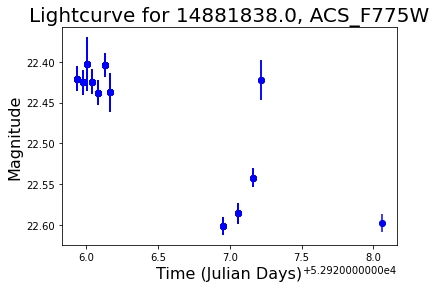

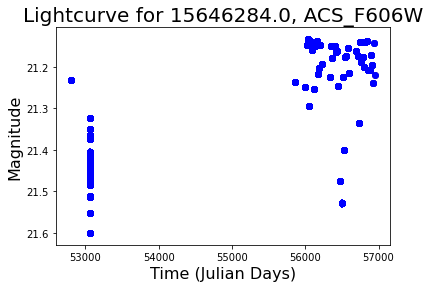

...

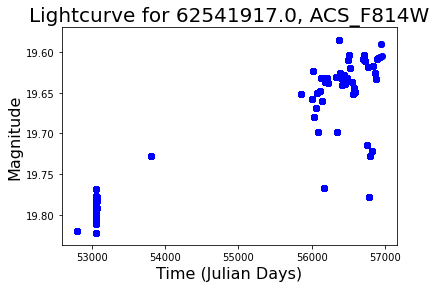

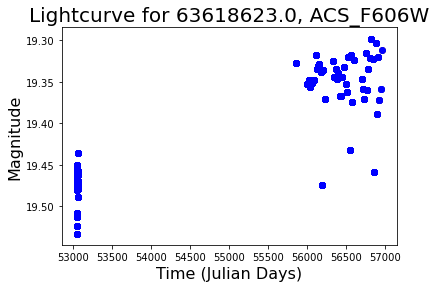

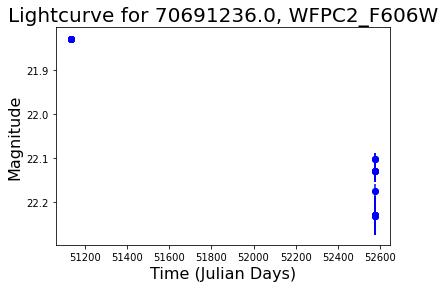

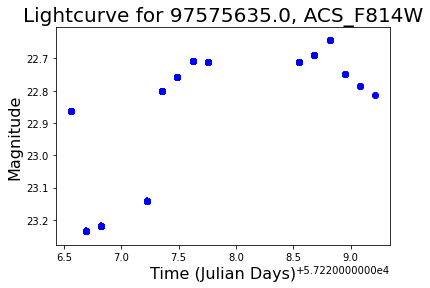

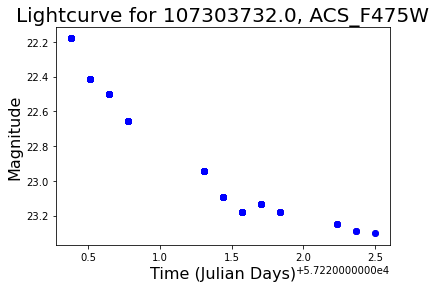

cluster:  3


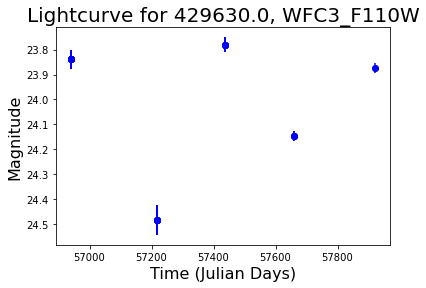

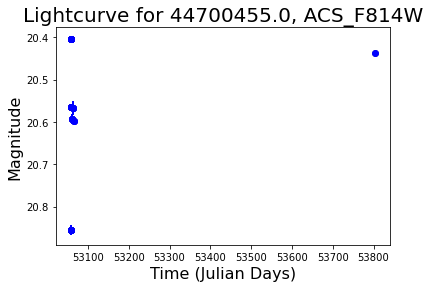

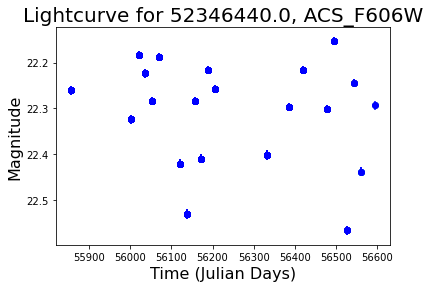

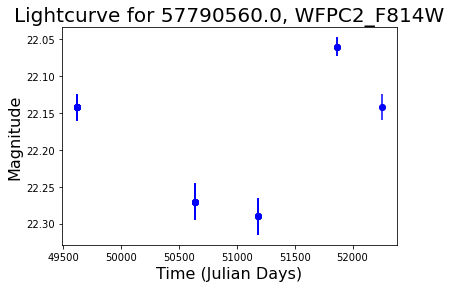

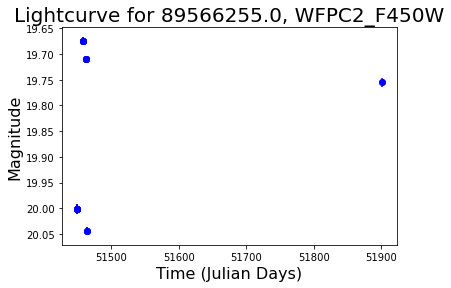

cluster:  24


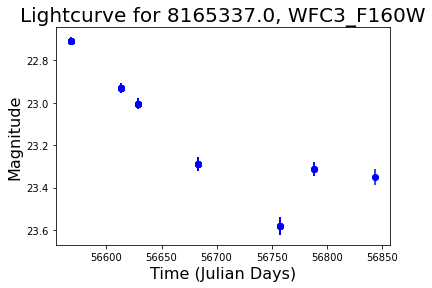

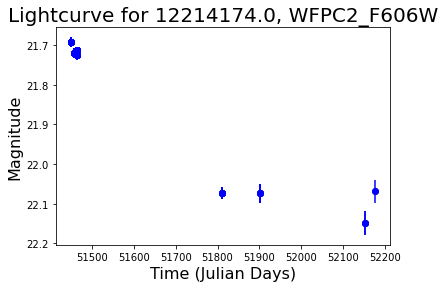

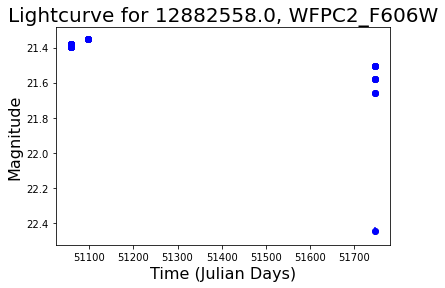

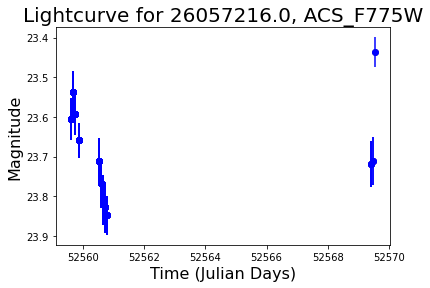

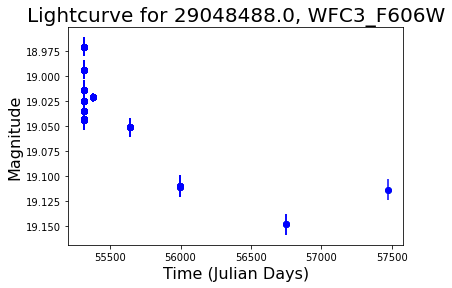

cluster:  25


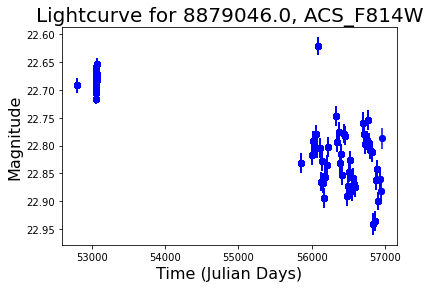

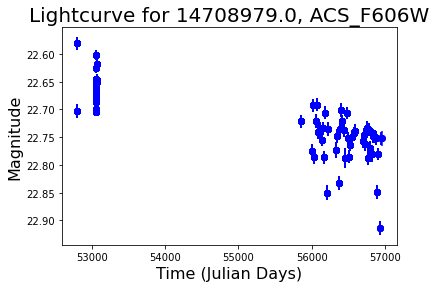

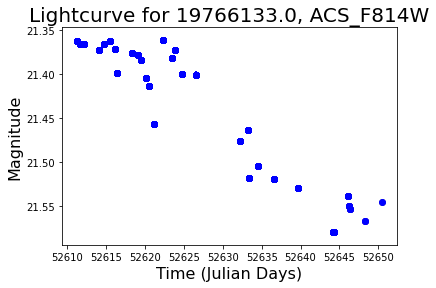

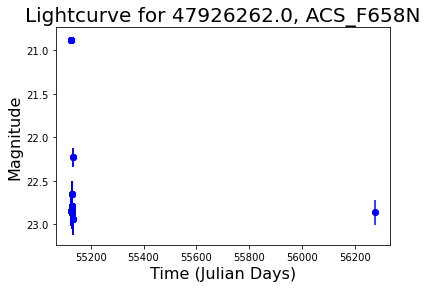

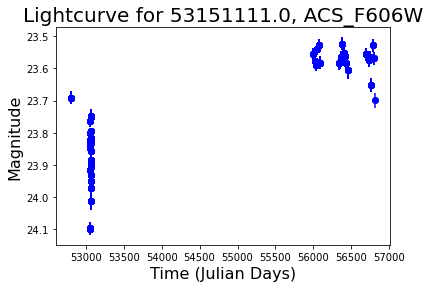

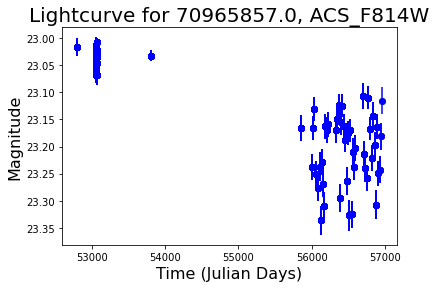

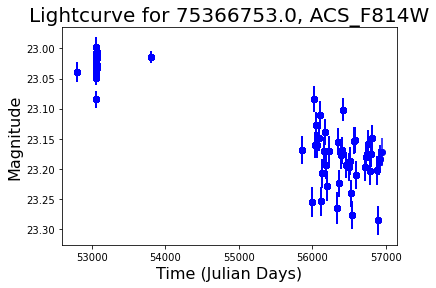

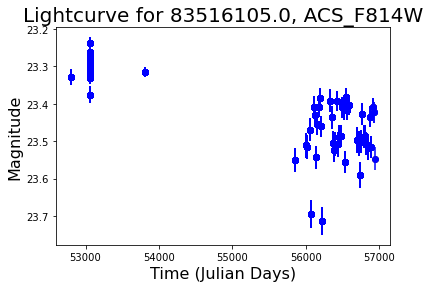

In [45]:
#then for dbscan
implement_cluster_analysis(tsne_1800_dbscan, 'DBSCAN')

### Compute similarity for test objects

In [42]:
#takes in list of matchid, filter, description tuples
#applies for kmeans and dbscan dfs
def get_similarity_info(obj_list, tsne_df, tsne_kmeans, tsne_dbscan):
    #get scaled KK rows----
    #first need to find indices of the objects in the king kong
    index1 = king_kong.index[(king_kong['matchid']==obj_list[0][0]) & (king_kong['filter']==obj_list[0][1])].tolist()[0]
    index2 = king_kong.index[(king_kong['matchid']==obj_list[1][0]) & (king_kong['filter']==obj_list[1][1])].tolist()[0]
    
    unwanted_columns = ['matchid', 'filter', 'pair1', 'pair2']
    
    obj1_kk = king_kong.iloc[index1]
    for name in unwanted_columns:
        obj1_kk = obj1_kk.drop([name])
    obj2_kk = king_kong.iloc[index2]
    for name in unwanted_columns:
        obj2_kk = obj2_kk.drop([name])
        
    obj1_kk_sc = king_kong_scaled.iloc[index1]
    obj2_kk_sc = king_kong_scaled.iloc[index2]
    
    #limited king kong rows
    obj1_limited = limited_kk.iloc[index1]
    obj2_limited = limited_kk.iloc[index2]
    obj1_limited_sc = limited_kk_scaled.iloc[index1]
    obj2_limited_sc = limited_kk_scaled.iloc[index2]
    
    #tsne rows
    obj1_tsne = tsne_df.iloc[index1]
    obj2_tsne = tsne_df.iloc[index2]
    
    #compute similarity
    kk_sim = get_similarity(obj1_kk, obj2_kk)
    kk_sc_sim = get_similarity(obj1_kk_sc, obj2_kk_sc)
    limited_kk_sim = get_similarity(obj1_limited, obj2_limited)
    limited_kk_sc_sim = get_similarity(obj1_limited_sc, obj2_limited_sc)
    tsne_sim = get_similarity(obj1_tsne, obj2_tsne)
    
    #get kmeans and dbscan cluster assignments
    kmeans_cluster_1 = tsne_kmeans.iloc[index1]['cluster']
    kmeans_cluster_2 = tsne_kmeans.iloc[index2]['cluster']
    
    dbscan_cluster_1 = tsne_dbscan.iloc[index1]['cluster']
    dbscan_cluster_2 = tsne_dbscan.iloc[index2]['cluster']
    
    #now append everything to a dict
    return {'object 1': str(obj_list[0][0]) + ','+obj_list[0][1], 'object 2': str(obj_list[1][0]) + ','+obj_list[1][1],
            'obj 1 description': obj_list[0][2], 'obj 2 description': obj_list[1][2],
           'king kong similarity': kk_sim, 'scaled king kong similarity': kk_sc_sim, 
           'limited king kong similarity': limited_kk_sim, 'limited scaled king kong similarity': limited_kk_sc_sim,
           'tsne similarity': tsne_sim,
           'kmeans cluster obj 1': kmeans_cluster_1, 'kmeans cluster obj 2': kmeans_cluster_2,
           'dbscan cluster obj 1': dbscan_cluster_1, 'dbscan cluster obj 2': dbscan_cluster_2}
    

In [ ]:
#takes in list of matchid, filter, description tuples
#applies for kmeans and dbscan dfs
def get_similarity_info_totsne(obj_list, kk_subset):
    #get scaled KK rows----
    #first need to find indices of the objects in the king kong
    index1 = king_kong.index[(king_kong['matchid']==obj_list[0][0]) & (king_kong['filter']==obj_list[0][1])].tolist()[0]
    index2 = king_kong.index[(king_kong['matchid']==obj_list[1][0]) & (king_kong['filter']==obj_list[1][1])].tolist()[0]
    
    unwanted_columns = ['matchid', 'filter', 'pair1', 'pair2']
    
    obj1_kk = king_kong.iloc[index1]
    for name in unwanted_columns:
        obj1_kk = obj1_kk.drop([name])
    obj2_kk = king_kong.iloc[index2]
    for name in unwanted_columns:
        obj2_kk = obj2_kk.drop([name])
        
    obj1_kk_sc = king_kong_scaled.iloc[index1]
    obj2_kk_sc = king_kong_scaled.iloc[index2]
    
    #limited king kong rows
    obj1_limited = limited_kk.iloc[index1]
    obj2_limited = limited_kk.iloc[index2]
    obj1_limited_sc = limited_kk_scaled.iloc[index1]
    obj2_limited_sc = limited_kk_scaled.iloc[index2]
    
    #tsne rows
    obj1_tsne = tsne_df.iloc[index1]
    obj2_tsne = tsne_df.iloc[index2]
    
    #compute similarity
    kk_sim = get_similarity(obj1_kk, obj2_kk)
    kk_sc_sim = get_similarity(obj1_kk_sc, obj2_kk_sc)
    limited_kk_sim = get_similarity(obj1_limited, obj2_limited)
    limited_kk_sc_sim = get_similarity(obj1_limited_sc, obj2_limited_sc)
    tsne_sim = get_similarity(obj1_tsne, obj2_tsne)
    
    #get kmeans and dbscan cluster assignments
    kmeans_cluster_1 = tsne_kmeans.iloc[index1]['cluster']
    kmeans_cluster_2 = tsne_kmeans.iloc[index2]['cluster']
    
    dbscan_cluster_1 = tsne_dbscan.iloc[index1]['cluster']
    dbscan_cluster_2 = tsne_dbscan.iloc[index2]['cluster']
    
    #now append everything to a dict
    return {'object 1': str(obj_list[0][0]) + ','+obj_list[0][1], 'object 2': str(obj_list[1][0]) + ','+obj_list[1][1],
            'obj 1 description': obj_list[0][2], 'obj 2 description': obj_list[1][2],
           'king kong similarity': kk_sim, 'scaled king kong similarity': kk_sc_sim, 
           'limited king kong similarity': limited_kk_sim, 'limited scaled king kong similarity': limited_kk_sc_sim,
           'tsne similarity': tsne_sim,
           'kmeans cluster obj 1': kmeans_cluster_1, 'kmeans cluster obj 2': kmeans_cluster_2,
           'dbscan cluster obj 1': dbscan_cluster_1, 'dbscan cluster obj 2': dbscan_cluster_2}
    

In [34]:
#define list of pairs of tuples
pairs_list = [[(69850190, 'WFPC2_F606W', 'flare up&down'), (53486859, 'ACS_F814W', 'flare up & down')],
             [(68175903, 'ACS_F850LP', 'flare down'), (74947430, 'WFC3_F350LP', 'flare down')],
             [(103818234, 'WFC3_F160W', 'flare up'), (38061649, 'WFC3_F814W', 'flare up')],
             [(69850190, 'WFPC2_F606W', 'flare up&down'), (819013, 'ACS_F814W', 'periodic')],
             [(74947430, 'WFC3_F350LP', 'flare down'), (103625861, 'ACS_F814W', 'periodic')]]

In [35]:
#define master function to generate similarity matrix given example
#instantiate blank df
sim_ex_data = {'object 1': [], 'object 2': [],
            'obj 1 description': [], 'obj 2 description': [],
           'king kong similarity': [], 'scaled king kong similarity': [],
           'limited king kong similarity': [], 'limited scaled king kong similarity': [], 
           'tsne similarity': [],
           'kmeans cluster obj 1': [], 'kmeans cluster obj 2': [],
           'dbscan cluster obj 1': [], 'dbscan cluster obj 2': []}
sim_ex_df = pd.DataFrame(sim_ex_data)

In [36]:
def get_sim_df(sim_ex_df, pairs_list, ide, tsne_df, tsne_kmeans, tsne_dbscan):
    for pair in pairs_list:
        sim_ex_df = sim_ex_df.append(get_similarity_info(pair, tsne_df, tsne_kmeans, tsne_dbscan), ignore_index=True)
    #save dat csv!
    os.chdir(parent_dir)
    sim_ex_df.to_csv('sim_'+ide+'_df.csv')
    return sim_ex_df

## Now for limited indices, perplexity = 1800

In [26]:
os.chdir(tsne_dir)
limited_1800 = pd.read_csv('limited_1800.csv')
limited_1800 = limited_1800.iloc[:, 1:]
limited_1800

,t-SNE-1,t-SNE-2
0,3.093899e-06,-3.009655e-06
1,1.857708e-07,1.994435e-06
2,-1.526275e-06,-1.503659e-06
3,1.282377e-06,-2.256343e-07
4,1.781419e-06,-4.328117e-06
...,...,...
179866,2.736045e-07,2.697342e-06
179867,3.929862e-07,-1.501370e-06
179868,2.514617e-06,3.384624e-06
179869,1.098203e-06,1.576097e-06


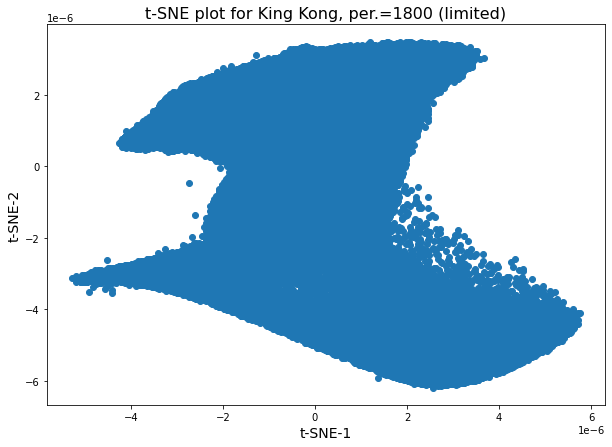

In [64]:
#scatter plot
x_list = limited_1800['t-SNE-1'].tolist()
y_list = limited_1800['t-SNE-2'].tolist()

plt.figure(figsize = (10, 7))
plt.scatter(x_list, y_list)
plt.xlabel('t-SNE-1', fontsize=14)
plt.ylabel('t-SNE-2', fontsize=14)
plt.title('t-SNE plot for King Kong, per.=1800 (limited)', fontsize=16)
plt.savefig('tsne_1800_limited.jpeg')
plt.show()

### Implement clustering

In [29]:
ide = 'limited_1800'

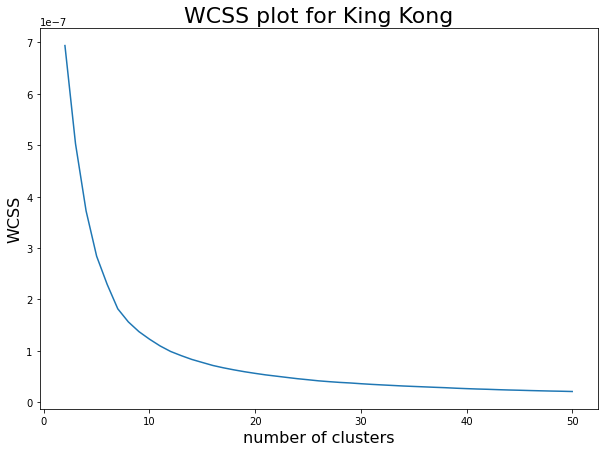

the elbow of the WCSS curve occurs at: 10
clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]


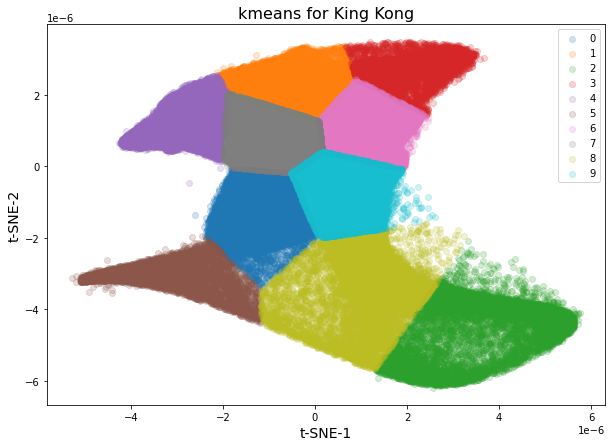

,t-SNE-1,t-SNE-2,cluster
0,3.093899e-06,-3.009655e-06,2
1,1.857708e-07,1.994435e-06,1
2,-1.526275e-06,-1.503659e-06,0
3,1.282377e-06,-2.256343e-07,9
4,1.781419e-06,-4.328117e-06,8
...,...,...,...
179866,2.736045e-07,2.697342e-06,1
179867,3.929862e-07,-1.501370e-06,9
179868,2.514617e-06,3.384624e-06,3
179869,1.098203e-06,1.576097e-06,6


In [30]:
limited_1800_kmeans = run_kmeans(limited_1800, ide)
limited_1800_kmeans

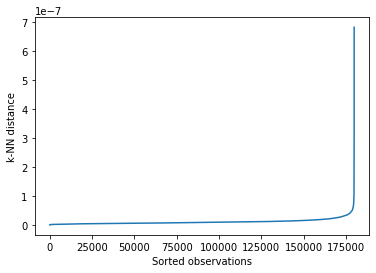

the elbow of the kNN curve occurs at:  179671 8.49312380978871e-08
clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, -1]


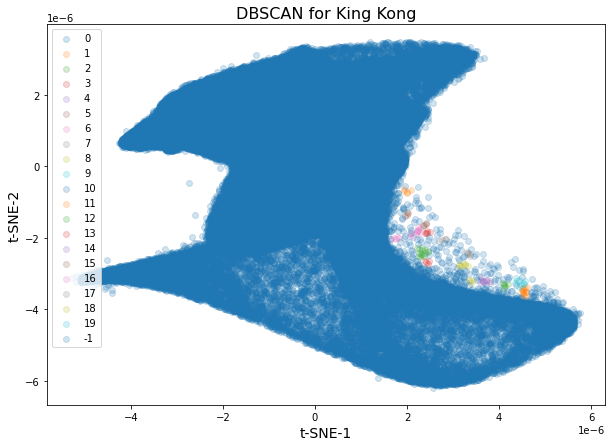

,t-SNE-1,t-SNE-2,cluster
0,3.093899e-06,-3.009655e-06,0
1,1.857708e-07,1.994435e-06,0
2,-1.526275e-06,-1.503659e-06,0
3,1.282377e-06,-2.256343e-07,0
4,1.781419e-06,-4.328117e-06,0
...,...,...,...
179866,2.736045e-07,2.697342e-06,0
179867,3.929862e-07,-1.501370e-06,0
179868,2.514617e-06,3.384624e-06,0
179869,1.098203e-06,1.576097e-06,0


In [36]:
limited_1800_dbscan = run_DBSCAN(limited_1800, ide)
limited_1800_dbscan

In [62]:
sim_limited_1800 = get_sim_df(sim_ex_df, pairs_list, ide, limited_1800, limited_1800_kmeans, limited_1800_dbscan)
sim_limited_1800

,object 1,object 2,obj 1 description,obj 2 description,king kong similarity,scaled king kong similarity,limited king kong similarity,limited scaled king kong similarity,tsne similarity,kmeans cluster obj 1,kmeans cluster obj 2,dbscan cluster obj 1,dbscan cluster obj 2
0,"69850190,WFPC2_F606W","53486859,ACS_F814W",flare up&down,flare up & down,454.301011,1.260066,374.787331,1.015630,0.000004,4.0,6.0,0.0,0.0
1,"68175903,ACS_F850LP","74947430,WFC3_F350LP",flare down,flare down,10614.317898,0.489672,10608.099995,0.430759,0.000001,1.0,1.0,0.0,0.0
2,"103818234,WFC3_F160W","38061649,WFC3_F814W",flare up,flare up,1901.969831,0.681254,1773.621447,0.615114,0.000001,1.0,7.0,0.0,0.0
3,"69850190,WFPC2_F606W","819013,ACS_F814W",flare up&down,periodic,237.570701,1.203188,134.339753,0.869512,0.000003,4.0,0.0,0.0,0.0
4,"74947430,WFC3_F350LP","103625861,ACS_F814W",flare down,periodic,10619.724947,1.271046,10615.353549,1.205757,0.000005,1.0,8.0,0.0,0.0


In [63]:
#save csv
sim_limited_1800.to_csv('sim_1800.csv')

In [72]:
len(limited_1800_dbscan.loc[limited_1800_dbscan['cluster']==0]) / len(king_kong)

0.9982209472344069

In [73]:
len(limited_1800_kmeans.loc[limited_1800_kmeans['cluster']==9]) / len(king_kong)

0.1523758693730507

## Analysis of chi2 and mad

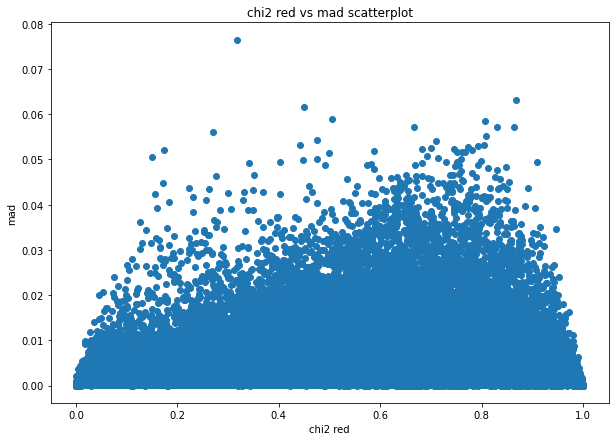

In [19]:
chi2red = chi2_mad_df['chi2red']
mad = chi2_mad_df['mad']

plt.figure(figsize=(10,7))
plt.scatter(chi2red, mad)
plt.xlabel('chi2 red')
plt.ylabel('mad')
plt.title('chi2 red vs mad scatterplot')
plt.show()

In [21]:
ide = 'chi2red_mad'

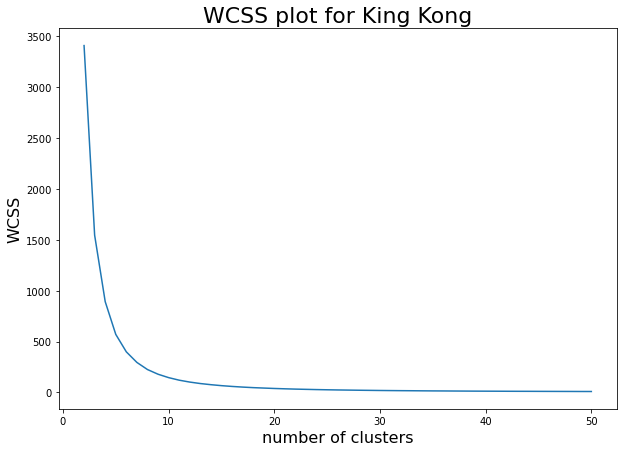

the elbow of the WCSS curve occurs at: 7
clusters: [0, 1, 2, 3, 4, 5, 6]


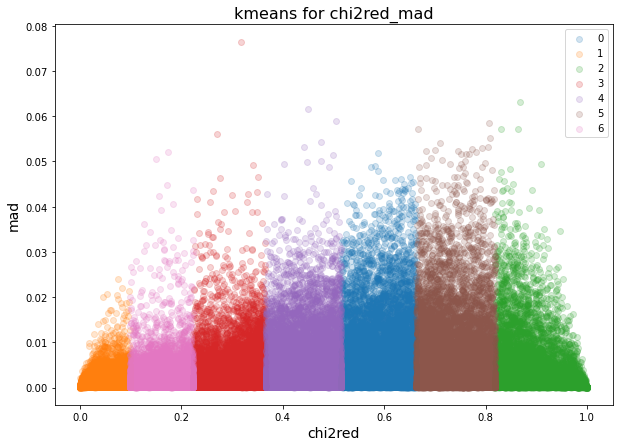

In [32]:
chi2_mad_kmeans = run_kmeans(chi2_mad_df, ide)

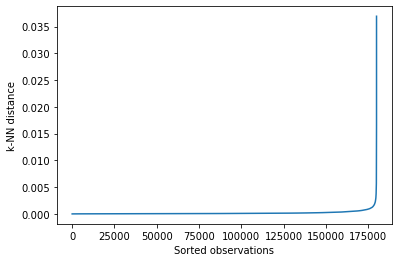

the elbow of the kNN curve occurs at:  179692 0.0043421284739503345
clusters: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, -1]


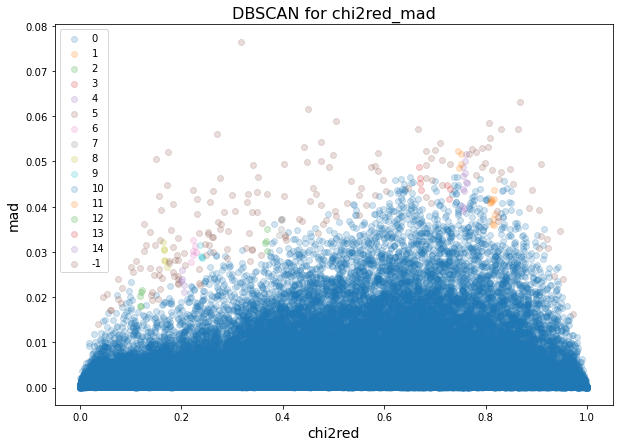

In [33]:
chi2red_mad_dbscan = run_DBSCAN(chi2_mad_df, ide)

In [43]:
sim_chi2_mad = get_sim_df(sim_ex_df, pairs_list, ide, chi2_mad_df, chi2_mad_kmeans, chi2red_mad_dbscan)
sim_chi2_mad

NameError: name 'limited_kk' is not defined